In [11]:
from joblib import Parallel, delayed
import os
os.environ['R_HOME'] = '/public/home/liuzj/softwares/anaconda3/envs/circadian/lib/R'
import rpy2
import rpy2.robjects as ro
from rpy2.robjects.packages import importr
import rpy2.ipython.html
rpy2.ipython.html.init_printing()
from jpy_tools.rTools import py2r, r2py, r_inline_plot, rHelp, trl, rSet, rGet, ad2so, so2ad, so2md, rcontext, Trl, r2py_re, py2r_re
from jpy_tools import loadPkl, toPkl
rBase = importr('base')
rUtils = importr('utils')
dplyr = importr('dplyr')
reticulate = importr('reticulate')
R = ro.r
T = Trl()
R("options(browser='firefox', shiny.port=6533, max.print=200)")
%load_ext rpy2.ipython

The rpy2.ipython extension is already loaded. To reload it, use:
  %reload_ext rpy2.ipython


In [2]:
import os

In [3]:
os.listdir()

['01_circadian_clustering.ipynb',
 '01.fine_cluster_circadian_clustering.ipynb',
 '02_call_circadian.ipynb',
 '03.scenic.ipynb',
 '01.1.subclustering_c1.ipynb',
 'utils.py',
 '__pycache__',
 '04.celloracle.ipynb',
 'links.celloracle.links',
 'links.subsample.40000.celloracle.links',
 '01.0.benchmark.ipynb']

In [4]:
%config InlineBackend.figure_format = 'retina'
import seaborn as sns
import matplotlib as mpl
from matplotlib import pyplot as plt
import matplotlib.ticker as ticker
import matplotlib.font_manager as font_manager
import marsilea as ma
import marsilea.plotter as mp
# plt.rcParams['figure.dpi'] = 150
font_dirs = ["/public/home/mowp/test/fonts/"]
font_files = font_manager.findSystemFonts(fontpaths=font_dirs)
for font_file in font_files:
    font_manager.fontManager.addfont(font_file)
plt.rcParams["font.family"] = "Arial"
sns.despine(top=True, right=True)
from itertools import product
from functools import reduce
import patchworklib as pw
from jpy_tools.otherTools import pwRecoverSeaborn, pwStack, F, pwShow
pw.show = pwShow
fc_recoverSns = pwRecoverSeaborn()
import seaborn.objects as so
from cycler import cycler
dt_snsStyle = {**sns.axes_style('ticks'), "legend.frameon": False, "axes.spines.top":False, "axes.spines.right":False, "axes.prop_cycle":cycler(color=['grey'])}
so.Plot.config.theme.update(dt_snsStyle)

<Figure size 640x480 with 0 Axes>

In [5]:
import scanpy as sc
import muon as mu
import pandas as pd
import numpy as np
import scipy.sparse as ss
from tqdm import tqdm
from loguru import logger

In [6]:
import pyranges as pr

In [7]:
import utils

<Figure size 640x480 with 0 Axes>

In [8]:
from jpy_tools import singleCellTools
from functools import partial

Global seed set to 0


In [9]:
import seaborn.objects as so

dt_snsStyle = {
    **sns.axes_style("ticks"),
    "axes.spines.top": False,
    "axes.spines.right": False,
}

In [10]:
dir_result = "/data/Zhaijx/liuzj/projects/circadian/03_analysis/"
dir_temp = "/data/Zhaijx/liuzj/projects/singleCell/02_jupyter/circadian/20221122/"

In [12]:
# md = loadPkl('md_20220829_after_diffxpy_marker', lambda **dt:mu.read_h5mu(**dt), arg_path='filename', dir_path=dir_temp)
# ad = md['all']

In [12]:
ls_sample = [8, 10, 12, 14, 16, 18, 20, 22, 24, 2, 4, 6] | F(map, str) | F(list)

In [13]:
dt_sample2Phase = {x: y for x, y in zip(ls_sample, range(0, 26, 2))}
dt_phase2Sample = {y: x for x, y in dt_sample2Phase.items()}

In [14]:
dt_sample2Ct = {x: y for x, y in zip(ls_sample, range(48, 72, 2))}

In [12]:
# ad.obs['CT'] = ad.obs['Sample'].map(dt_sample2Ct)

In [16]:
# ls_cluster = ad.obs['leiden'].cat.categories.to_list()

In [17]:
# toPkl(md, 'md_20220825', 'ipf', dir_path=dir_temp)

In [ ]:
!mkdir {dir_temp}

In [15]:
from dataclasses import dataclass
from typing import Any

import numpy as np
import matplotlib as mpl
from matplotlib.artist import Artist
from seaborn._core.scales import Scale
from seaborn._marks.base import (
    Mark,
    Mappable,
    MappableBool,
    MappableColor,
    MappableFloat,
    MappableStyle,
    resolve_properties,
    resolve_color,
    document_properties,
)
from collections import defaultdict


class BarBase(Mark):
    def _make_patches(self, data, scales, orient):
        kws = self._resolve_properties(data, scales)
        if orient == "x":
            kws["x"] = (data["x"] - data["width"] / 2).to_numpy()
            kws["y"] = data["baseline"].to_numpy()
            kws["w"] = data["width"].to_numpy()
            kws["h"] = (data["y"] - data["baseline"]).to_numpy()
        else:
            kws["x"] = data["baseline"].to_numpy()
            kws["y"] = (data["y"] - data["width"] / 2).to_numpy()
            kws["w"] = (data["x"] - data["baseline"]).to_numpy()
            kws["h"] = data["width"].to_numpy()

        kws.pop("width", None)
        kws.pop("baseline", None)

        val_dim = {"x": "h", "y": "w"}[orient]
        bars, vals = [], []

        for i in range(len(data)):
            row = {k: v[i] for k, v in kws.items()}

            # Skip bars with no value. It's possible we'll want to make this
            # an option (i.e so you have an artist for animating or annotating),
            # but let's keep things simple for now.
            if not np.nan_to_num(row[val_dim]):
                continue

            bar = mpl.patches.Rectangle(
                xy=(row["x"], row["y"]),
                width=row["w"],
                height=row["h"],
                facecolor=row["facecolor"],
                edgecolor=row["edgecolor"],
                linestyle=row["edgestyle"],
                linewidth=row["edgewidth"],
                **self.artist_kws,
            )
            bars.append(bar)
            vals.append(row[val_dim])

        return bars, vals

    def _resolve_properties(self, data, scales):
        resolved = resolve_properties(self, data, scales)

        resolved["facecolor"] = resolve_color(self, data, "", scales)
        resolved["edgecolor"] = resolve_color(self, data, "edge", scales)

        fc = resolved["facecolor"]
        if isinstance(fc, tuple):
            resolved["facecolor"] = fc[0], fc[1], fc[2], fc[3] * resolved["fill"]
        else:
            fc[:, 3] = fc[:, 3] * resolved["fill"]  # TODO Is inplace mod a problem?
            resolved["facecolor"] = fc

        return resolved

    def _legend_artist(
        self,
        variables,
        value: Any,
        scales,
    ) -> Artist:
        # TODO return some sensible default?
        key = {v: value for v in variables}
        key = self._resolve_properties(key, scales)
        artist = mpl.patches.Patch(
            facecolor=key["facecolor"],
            edgecolor=key["edgecolor"],
            linewidth=key["edgewidth"],
            linestyle=key["edgestyle"],
        )
        return artist


@dataclass
class Box(BarBase):
    """
    An oriented rectangular mark drawn between min/max values.
    Examples
    --------
    .. include:: ../docstrings/objects.Box.rst
    """

    color: MappableColor = Mappable("C0")
    alpha: MappableFloat = Mappable(0.7)
    fill: MappableBool = Mappable(True)
    edgecolor: MappableColor = Mappable(depend="color")
    edgealpha: MappableFloat = Mappable(1)
    edgewidth: MappableFloat = Mappable(rc="patch.linewidth")
    edgestyle: MappableFloat = Mappable("-")
    width: MappableFloat = Mappable(0.8, grouping=False)

    def _clip_edges(self, artist: Artist, ax):
        """Add a clip path to patch artist so that edges do not extend past face."""
        # This is a hack to handle the fact that the edge lines are centered on
        # the actual extents of the patch and overlap when stacking or dodging.
        # We may discover that this causes issues and needs to be revisited.

        # Because we are clipping, the edges end up looking half as wide as they
        # actually are. I don't love this clumsy workaround, which is going to
        # cause surprises if you work with the artists directly.
        artist.set_linewidth(artist.get_linewidth() * 2)
        linestyle = artist.get_linestyle()
        if linestyle[1]:
            linestyle = (linestyle[0], tuple(x / 2 for x in linestyle[1]))
        artist.set_linestyle(linestyle)

        # It should be faster to clip with a bbox than a path, but I cant't work
        # out how to get the intersection with the axes bbox.
        artist.set_clip_path(artist.get_path(), artist.get_transform() + ax.transData)
        if self.artist_kws.get("clip_on", True):
            # It seems the above hack undoes the default axes clipping
            artist.set_clip_box(ax.bbox)

    def _plot(self, split_gen, scales, orient):
        patches = defaultdict(list)

        for keys, data, ax in split_gen():
            kws = {}

            resolved = self._resolve_properties(keys, scales)

            kws["facecolor"] = resolved["facecolor"]
            kws["edgecolor"] = resolved["edgecolor"]
            kws["linewidth"] = resolved["edgewidth"]
            kws["linestyle"] = resolved["edgestyle"]

            other = {"x": "y", "y": "x"}[orient]

            if not set(data.columns) & {f"{other}min", f"{other}max"}:
                agg = {f"{other}min": (other, "min"), f"{other}max": (other, "max")}
                data = data.groupby([orient, "width"]).agg(**agg).reset_index()

            for row in data.itertuples():
                if orient == "x":
                    verts = np.array(
                        [
                            row.x - row.width / 2,
                            row.ymin,
                            row.x + row.width / 2,
                            row.ymin,
                            row.x + row.width / 2,
                            row.ymax,
                            row.x - row.width / 2,
                            row.ymax,
                        ]
                    ).reshape((4, 2))
                else:
                    verts = np.array(
                        [
                            row.xmin,
                            row.y - row.width / 2,
                            row.xmax,
                            row.y - row.width / 2,
                            row.xmax,
                            row.y + row.width / 2,
                            row.xmin,
                            row.y + row.width / 2,
                        ]
                    ).reshape((4, 2))

                patches[ax].append(mpl.patches.Polygon(verts, **kws))
                ax.update_datalim(verts)

        for ax, ax_patches in patches.items():
            for patch in ax_patches:
                self._clip_edges(patch, ax)
                ax.add_patch(patch)

In [16]:
ad = loadPkl('ad_scshc', lambda **dt:sc.read_h5ad(**dt), arg_path='filename', dir_path=dir_temp)

In [17]:
pad = singleCellTools.plotting.PlotAnndata(ad, 'sx')

In [21]:
# pad.getPb("CT").write_h5ad("/data/Zhaijx/qinyw/data/flsnRNA/illumina_lib/circadian/20231110/soupX_all.h5ad")

In [31]:
# pad.getPb(["CT", "leiden_subcluster"]).write_h5ad("/data/Zhaijx/qinyw/data/flsnRNA/illumina_lib/circadian/20231110/soupX_eachCluster.h5ad")

# load data

## gene name locus 

In [59]:
df_gff3 = (
    pr.read_gff3("/data/Zhaijx/liuzj/data/Araport11/gene.gff", as_df=True)
    .query("Feature == 'gene'")
    .set_index("ID")
)

In [60]:
dt_locus2Name = df_gff3["Alias"].dropna().to_dict()
dt_locus2Name.update(df_gff3["symbol"].dropna().to_dict())

## core clock gene

In [202]:
ls_coreGenes = [
    "AT2G46830",
    "AT1G01060",
    "AT1G12910",
    "AT3G26640",
    "AT2G46790",
    "AT5G02810",
    "AT3G09600",
    "AT5G52660",
    "AT5G02840",
    "AT5G64170",
    "AT3G54500",
    "AT5G24470",
    "AT5G60100",
    "AT5G61380",
    "AT5G08330",
    "AT1G22770",
    "AT5G59570",
    "AT3G46640",
    "AT2G40080",
    "AT2G25930",
]
ls_coreGeneNames = [
    "CCA1",
    "LHY",
    "LWD1",
    "LWD2",
    "PRR9",
    "PRR7",
    "RVE8",
    "RVE6",
    "RVE4",
    "LNK1",
    "LNK2",
    "PRR5",
    "PRR3",
    "TOC1",
    "CHE",
    "GI",
    "NOX",
    "LUX",
    "ELF4",
    "ELF3",
]
dt_coreGene = dict(zip(ls_coreGenes, ls_coreGeneNames))
dt_coreGene

# added
dt_coreGene['AT5G57360'] = 'ZTL'

In [203]:
_ls = """AT5G64170
AT5G61380
AT5G60100
AT5G57360
AT5G52660
AT5G24470
AT5G02840
AT5G02810
AT3G54500
AT3G46640
AT3G09600
AT2G46830
AT2G46790
AT2G40080
AT2G25930
AT1G22770
AT1G01060""".split()
dt_coreGene = {x:dt_coreGene[x] for x in _ls}
dt_coreGene

{'AT5G64170': 'LNK1',
 'AT5G61380': 'TOC1',
 'AT5G60100': 'PRR3',
 'AT5G57360': 'ZTL',
 'AT5G52660': 'RVE6',
 'AT5G24470': 'PRR5',
 'AT5G02840': 'RVE4',
 'AT5G02810': 'PRR7',
 'AT3G54500': 'LNK2',
 'AT3G46640': 'LUX',
 'AT3G09600': 'RVE8',
 'AT2G46830': 'CCA1',
 'AT2G46790': 'PRR9',
 'AT2G40080': 'ELF4',
 'AT2G25930': 'ELF3',
 'AT1G22770': 'GI',
 'AT1G01060': 'LHY'}

# GO

In [136]:
from jpy_tools.otherTools import getGoDesc
import pandas as pd

In [137]:
import jpy_tools.otherTools
import importlib

importlib.reload(jpy_tools.otherTools)

<module 'jpy_tools.otherTools' from '/public/home/liuzj/softwares/anaconda3/envs/circadian/lib/python3.8/site-packages/jpy_tools/otherTools.py'>

In [138]:
df_araGo = pd.read_table("/data/Zhaijx/liuzj/data/Araport11/tair10/ath_go_parsed.txt")
df_goDesc = getGoDesc(df_araGo["goTerm"].unique().tolist(), retry=10, verbose=True)

100%|██████████| 7638/7638 [03:15<00:00, 39.07it/s] 
2023-09-05 20:27:16.799 | WARNING  | jpy_tools.otherTools:getGoDesc:604 - query : GO:0016021, target : GO:0016020
2023-09-05 20:27:16.806 | WARNING  | jpy_tools.otherTools:getGoDesc:604 - query : GO:0005887, target : GO:0005886
2023-09-05 20:27:16.916 | WARNING  | jpy_tools.otherTools:getGoDesc:604 - query : GO:0052928, target : GO:0052927
2023-09-05 20:27:16.964 | WARNING  | jpy_tools.otherTools:getGoDesc:604 - query : GO:0044106, target : GO:0009308
2023-09-05 20:27:16.996 | WARNING  | jpy_tools.otherTools:getGoDesc:604 - query : GO:0004367, target : GO:0047952
2023-09-05 20:27:17.004 | WARNING  | jpy_tools.otherTools:getGoDesc:604 - query : GO:0102092, target : GO:0033857
2023-09-05 20:27:17.009 | WARNING  | jpy_tools.otherTools:getGoDesc:604 - query : GO:0004147, target : GO:0043754
2023-09-05 20:27:17.015 | WARNING  | jpy_tools.otherTools:getGoDesc:604 - query : GO:0102860, target : GO:0050184
2023-09-05 20:27:17.016 | WARNING  

In [142]:
dt_goForGseapy = (
    df_araGo.merge(df_goDesc, left_on="goTerm", right_on="hitGO", how="left")
    .groupby(["hitName"])["gene"]
    .agg(list)
    .to_dict()
)

In [143]:
import gseapy


def enrichrUsingGsea(ls_gene, dt_goSets, background=None, **kwargs):
    enr = gseapy.enrich(
        list(ls_gene), gene_sets=dt_goSets, background=background, **kwargs
    )
    enr.results = enr.results.assign(
        geneTotal=lambda x: x["Overlap"].str.split("/").str[1].astype(int),
        geneIn=lambda x: x["Overlap"].str.split("/").str[0].astype(int),
    )
    enr.results["-log10(p)"] = -np.log10(enr.results["Adjusted P-value"])
    return enr.results.copy().sort_values("Adjusted P-value").reset_index(drop=True)

In [297]:
cpro = importr('clusterProfiler')
rBase = importr("base")
R = ro.r

In [144]:
dt_goCategory =  df_goDesc['aspect'].to_dict()
df_araGo = df_araGo.assign(cate = lambda df:df['goTerm'].map(dt_goCategory))

df_termGene = df_araGo[["goTerm", "gene"]].rename(
    columns={"gene": "Gene stable ID", "goTerm": "GO term accession"}
)
df_termName = df_goDesc.reset_index()[["index", "hitName"]].rename(
    columns={"index": "GO term accession", "hitName": "GO term name"}
)
dt_goToCat = df_araGo.set_index("goTerm")["cate"].to_dict()



In [ ]:
# %store -r df_termGene df_termName

In [299]:
dfR_termGene = py2r(df_termGene)
dfR_termName = py2r(df_termName)

In [300]:
def enrichmentAnalysisGO(ls_gene, ls_background, qvalueCutoff=0.2, dt_goToCat=dt_goToCat):
    _go = cpro.enricher(
        R.c(*ls_gene),
        universe=R.c(*ls_background),
        TERM2GENE=dfR_termGene,
        TERM2NAME=dfR_termName,
        qvalueCutoff=qvalueCutoff,
    )
    df_go = r2py(rBase.as_data_frame(_go))
    df_go["-log10Pvalue"] = np.log10(df_go["pvalue"]) * -1
    if dt_goToCat:
        df_go["Category"] = df_go.index.map(dt_goToCat)
        df_go = df_go.sort_values(["Category", "pvalue"])
    else:
        df_go = df_go.sort_values(["pvalue"])
    return df_go

# QC

In [ ]:
from joblib import Parallel, delayed

In [ ]:
ls_sample = [8, 10, 12, 14, 16, 18, 20, 22, 24, 2, 4, 6] | F(map, str) | F(list)

In [ ]:
def removeDoubletsAndGetAmbientScore(sample):
    import rpy2.robjects as ro
    ro.r(".libPaths")("/public1/software/liuzj/softwares/anaconda3/envs/sc_py/lib/R/library")
    ad_sample = sc.read_10x_h5(
        f"/public/home/liuzj/projects/circadian/02_cellranger/circadian_{sample}/outs/filtered_feature_bc_matrix.h5"
        )
    ad_sample.layers["raw"] = ad_sample.X.copy()
    singleCellTools.detectDoublet.byScDblFinder(ad_sample)
    ad_sampleRaw = sc.read_10x_h5(
        f"/public/home/liuzj/projects/circadian/02_cellranger/circadian_{sample}/outs/raw_feature_bc_matrix.h5"
    )
    ad_sampleRaw.layers["raw"] = ad_sampleRaw.X.copy()
    singleCellTools.removeAmbient.removeAmbientBySoupx(ad_sample, ad_sampleRaw, res=1.5)
    return ad_sample

In [ ]:
ls_afterAmbAndRemoveDoubletsAd = Parallel(n_jobs=12, backend='multiprocessing')(delayed(removeDoubletsAndGetAmbientScore)(sample) for sample in ls_sample)

In [ ]:
ad = sc.concat(dict(zip(ls_sample,ls_afterAmbAndRemoveDoubletsAd)), join='outer', label='Sample', index_unique='-')

In [ ]:
def _getCt(x):
    x = int(x)
    x -= 8
    if x < 0:
        x += 24
    return str(x)

In [ ]:
ad.obs['CT'] = ad.obs['Sample'].map(_getCt).astype('category')

In [ ]:
(
    so.Plot(ad.obs, x='ambientRnaFractionEstimatedBySoupx')
    .facet('CT', wrap=4)
    .share(x=False)
    .add(so.Bars(), so.Hist(bins=100))
    .label(x='RHO')
    .scale(x=so.Continuous().tick(every=0.1))
    .limit(x=[0, 1])
    .layout(size=(12,6))
    .theme(dt_snsStyle)
)

In [ ]:
singleCellTools.basic.initLayer(ad, layer='raw')

In [ ]:
sc.pp.filter_genes(ad, min_cells=10)

In [ ]:
singleCellTools.plotting.plotCellScatter(ad, batch='Sample')

In [ ]:
(
    so.Plot(ad.obs, x='n_genes')
    .facet('CT', wrap=4)
    .share(y=False, x=False)
    .add(so.Bars(), so.Hist(bins=100))
    .label(x='Gene counts')
    .scale(x=so.Continuous().tick(every=500))
    .limit(x=[0, 3000])
    .layout(size=(12,6))
    .theme(dt_snsStyle)
)

In [ ]:
(
    so.Plot(ad.obs, x='n_counts')
    .facet('CT', wrap=4)
    .share(y=False, x=False)
    .add(so.Bars(), so.Hist(bins=100))
    .label(x='UMI counts')
    .scale(x=so.Continuous().tick(every=1000))
    .limit(x=[0, 5000])
    .layout(size=(12,6))
    .theme(dt_snsStyle)
)

In [ ]:
(
    so.Plot(ad.obs, x='percent_ct')
    .facet('CT', wrap=4)
    .share(y=False, x=False)
    .add(so.Bars(), so.Hist(bins=100))
    .label(x='Percent CT')
    .scale(x=so.Continuous().tick(every=0.02))
    .limit(x=[0, 0.1])
    .layout(size=(12,6))
    .theme(dt_snsStyle)
)

In [ ]:
def addDensityToDf(df:pd.DataFrame, x:str, y:str, group=None, bins=20):
    from scipy.interpolate import interpn
    from scipy.stats import gaussian_kde

    if group:
        df = df.groupby(group, as_index=False).apply(lambda df: addDensityToDf(df, x=x, y=y, bins=bins)).reset_index(level=0, drop=True)
    elif bins is None:
        x = df[x].values
        y = df[y].values
        xy = np.vstack([x,y])
        z = gaussian_kde(xy)(xy)
        df['temp_density'] = z
        df = df.sort_values('temp_density')
    else:
        x = df[x].values
        y = df[y].values
        data , x_e, y_e = np.histogram2d( x, y, bins = bins, density = True )
        z = interpn( ( 0.5*(x_e[1:] + x_e[:-1]) , 0.5*(y_e[1:]+y_e[:-1]) ) , data , np.vstack([x,y]).T , method = "splinef2d", bounds_error = False)
        z[np.where(np.isnan(z))] = 0.0
        df['temp_density'] = z
        df = df.sort_values('temp_density')
    return df

In [ ]:
_df = addDensityToDf(ad.obs, x='n_counts', y='percent_ct', group='CT', bins=50)
(
    so.Plot(_df, x='n_counts', y='percent_ct', color='temp_density')
    .facet('CT', wrap=4)
    .share(y=False, x=False)
    .add(so.Dots(pointsize=1, fillalpha=0.2, alpha=0.2), legend=False)
    .label(x='UMI counts', y='Percent CT')
    # .scale(x=so.Continuous().tick(every=1000))
    .limit(x=[0, 5000], y=[0,0.1])
    .layout(size=(12,6))
    .theme(dt_snsStyle)
)

In [ ]:
_df = addDensityToDf(ad.obs, x='n_counts', y='ambientRnaFractionEstimatedBySoupx', group='CT', bins=50)
(
    so.Plot(_df, x='n_counts', y='ambientRnaFractionEstimatedBySoupx', color='temp_density')
    .facet('CT', wrap=4)
    .share(y=False, x=False)
    .add(so.Dots(pointsize=1, fillalpha=0.2, alpha=0.2), legend=False)
    .label(x='UMI counts', y='RHO')
    # .scale(x=so.Continuous().tick(every=1000))
    # .limit(x=[0, 5000])
    .layout(size=(12,6))
    .theme(dt_snsStyle)
)

In [ ]:
_df = addDensityToDf(ad.obs, x='n_counts', y='ambientRnaFractionEstimatedBySoupx', group='CT', bins=50)
(
    so.Plot(_df, x='n_counts', y='ambientRnaFractionEstimatedBySoupx', color='temp_density')
    .facet('CT', wrap=4)
    .add(so.Dots(pointsize=1, fillalpha=0.2, alpha=0.2), legend=False)
    .label(x='UMI counts', y='RHO')
    # .scale(x=so.Continuous().tick(every=1000))
    # .limit(x=[0, 5000])
    .layout(size=(12,6))
    .theme(dt_snsStyle)
)

In [ ]:
_df = addDensityToDf(ad.obs, x='n_counts', y='ambientRnaFractionEstimatedBySoupx', group='CT', bins=50)
_ls = ['3', '8', '12', '13']
_df['Cluster'] = _df['Cluster'].map(lambda x: x if x in _ls else 'Other')
_df = _df.sort_values("Cluster", ascending=False)
(
    so.Plot(_df, x='n_counts', y='ambientRnaFractionEstimatedBySoupx', color='Cluster')
    .facet('CT', wrap=4)
    .add(so.Dots(pointsize=1, fillalpha=1, alpha=1),)
    .label(x='UMI counts', y='RHO')
    # .scale(x=so.Continuous().tick(every=1000))
    # .limit(x=[0, 5000])
    .scale(color={**singleCellTools.basic.getadataColor(ad, 'Cluster'), 'Other': 'grey'})
    .layout(size=(12,6))
    .theme({**dt_snsStyle, 'legend.markerscale': 5})
)

In [ ]:
def is_outlier(adata, metric: str, nmads: int):
    M = adata.obs[metric]
    outlier = (M < np.median(M) - nmads * M.mad()) | (
        np.median(M) + nmads * M.mad() < M
    )
    return outlier

In [ ]:
ls_outlier = []
for _ad in singleCellTools.basic.splitAdata(ad, 'CT', copy=False):
    ls_outlier.append(is_outlier(_ad, 'n_counts', 5) | is_outlier(_ad, "n_genes", 5) | is_outlier(_ad, "percent_ct", 5))

In [ ]:
ad.obs["outlier"] = pd.concat(ls_outlier)

In [ ]:
ad = ad[~ad.obs['outlier']]

In [ ]:
ad.obs.eval("percent_ct >= 0.1").value_counts()

In [ ]:
sc.pp.filter_genes(ad, min_cells=10)

In [ ]:
ad.raw = ad

In [ ]:
ad = ad[:, ~ad.var.index.str.contains(r'ATCG|ATMG')]

In [ ]:
ad.obs['Batch'] = np.where((ad.obs['Sample'].astype(int) % 4) == 0, '1', '2')

In [ ]:
toPkl(ad, 'ad_afterQC_1123', 'ipf', dir_path=dir_temp)

In [17]:
ad = loadPkl(
    "ad_afterQC_1123",
    lambda **dt: sc.read_h5ad(**dt),
    arg_path="filename",
    dir_path=dir_temp,
)

In [18]:
ad.obs = ad.obs.assign(
    CT=lambda x: x["CT"].map(lambda y: y >> F(int) >> F(lambda z: z + 24) >> F(str))
)

In [19]:
ad.obs["n_counts"] = ad.layers["raw"].sum(1).A1

In [20]:
ad.layers["sx"] = ad.layers["soupX_corrected"].copy()

In [21]:
ad.layers["sx_log"] = ad.layers["sx"].copy()
sc.pp.normalize_total(ad, 1e4, layer="sx_log")
sc.pp.log1p(ad, layer="sx_log", base=2)

In [ ]:
_dt = {**dt_snsStyle, "axes.spines.left": False}
g0 = (
    so.Plot(ad.obs, color="CT")
    .add(so.Bar(fill=False), so.Count(), y="CT", legend=False)
    .theme(_dt)
    .label(x="Nuclei count", y="")
    .scale(color=sc.plotting.palettes.default_20)
    .on(pw.basefigure)
    .plot()
)
bk0 = pw.load_seabornobj(g0, figsize=(1, 3))
bk0.invert_xaxis()
bk0.yaxis.set_label_position("right")
bk0.yaxis.set_ticks_position("right")
bk0.set_yticklabels([f"CT {x.get_text()}" for x in bk0.get_yticklabels()])
bk0.yaxis.set_ticks_position("none")
for axis in ["top", "bottom", "left", "right"]:
    bk0.spines[axis].set_linewidth(2)
bk0.tick_params(width=2)
bk0.set_xlabel("Nucleus count", fontsize=14)
bk0.set_xscale("symlog")
bk0.set_xlim(3e4, 0)
bk0.set_xticklabels(
    [
        x.get_text() if x.get_text() != "$\\mathdefault{0}$" else ""
        for x in bk0.get_xticklabels()
    ],
    fontsize=12,
)
bk0.tick_params(width=2)

with plt.rc_context(_dt):
    bk1 = pw.Brick(figsize=(5, 3))

    sns.boxplot(ad.obs, x="n_genes", y="CT", showfliers=False, ax=bk1)
    for i, (box, color) in enumerate(
        zip(
            [x for x in bk1.get_children() if isinstance(x, mpl.patches.PathPatch)],
            sc.plotting.palettes.default_20,
        )
    ):
        box.set_edgecolor(color)
        box.set_facecolor("white")
        # iterate over whiskers and median lines
        for j in range(5 * i, 5 * (i + 1)):
            bk1.lines[j].set_color(color)
    bk1.yaxis.set_ticks_position("none")
    bk1.set_yticklabels([f"" for x in bk1.get_yticklabels()])
    bk1.set_xticklabels([x for x in bk1.get_xticklabels()], fontsize=12)
    bk1.set_ylabel("")
    bk1.set_xlabel("Gene count", fontsize=14)
    plt.close()

for axis in ["top", "bottom", "left", "right"]:
    bk1.spines[axis].set_linewidth(2)
bk1.tick_params(width=2)

bk = pwStack([bk0, bk1], wmargin=0)
pwShow(bk)

# Alignment Score

## merge

In [33]:
ad_forAlignmentScore = ad.copy()

In [34]:
sc.pp.highly_variable_genes(
    ad_forAlignmentScore, "sx", n_top_genes=5000, flavor="seurat_v3", batch_key="Batch"
)

In [35]:
sc.pp.pca(ad_forAlignmentScore)

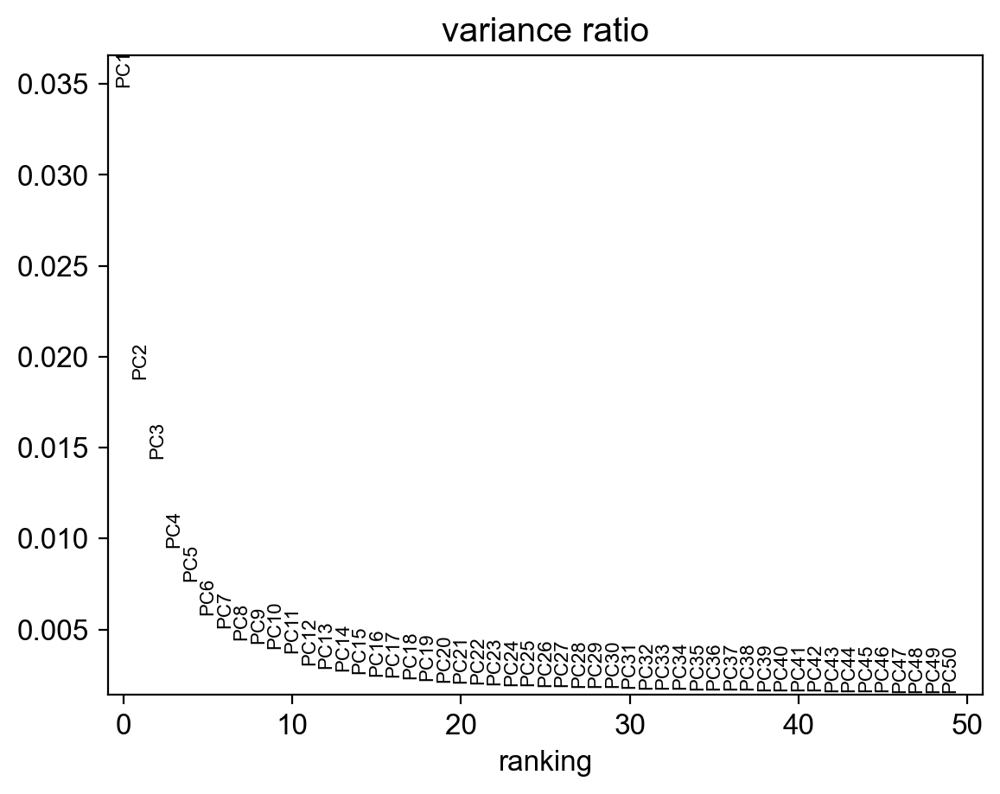

In [36]:
sc.pl.pca_variance_ratio(ad_forAlignmentScore, 50)

In [37]:
ad_forAlignmentScore.obsm["X_pca20"] = ad_forAlignmentScore.obsm["X_pca"][:, :20]

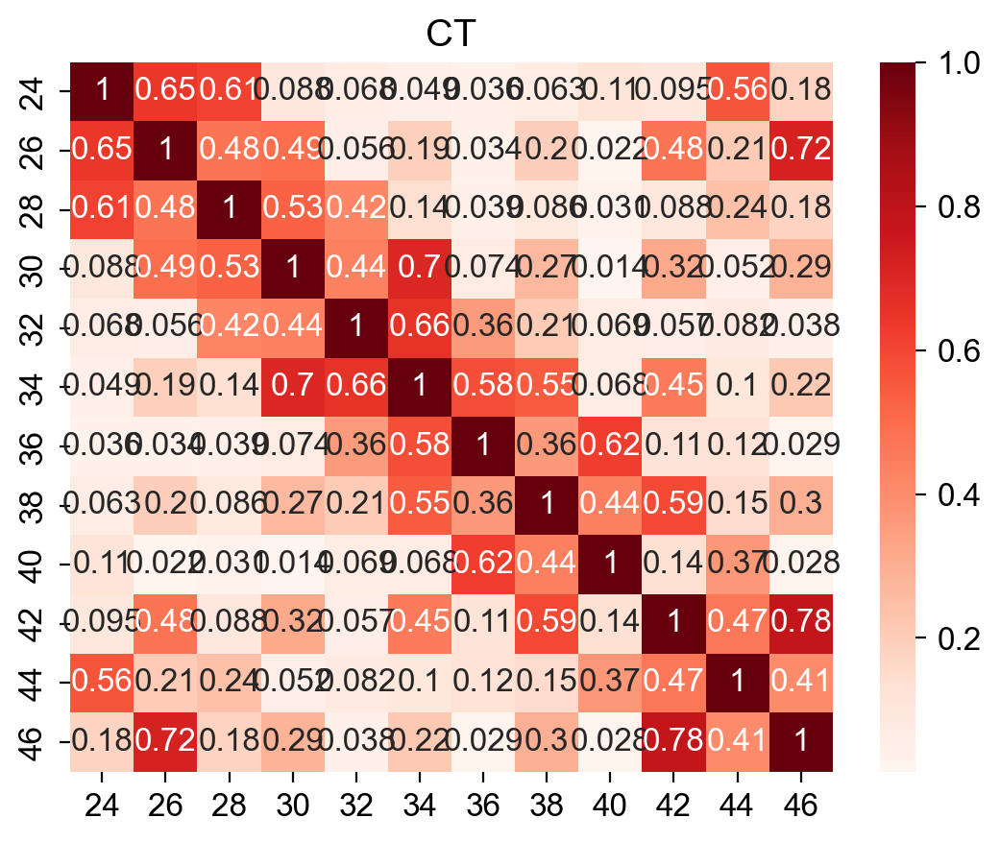

In [38]:
df_alignScore, ax = singleCellTools.others.getAlignmentScore(
    ad_forAlignmentScore, "CT", "X_pca20"
)

In [39]:
df_alignScore.index = range(24, 48, 2) >> F(list)
df_alignScore.columns = range(24, 48, 2) >> F(list)
df_alignScore = df_alignScore.iloc[::-1]

In [40]:
F

jpy_tools.otherTools.F

In [41]:
df_alignScore.index % 4 == 0


array([False,  True, False,  True, False,  True, False,  True, False,
        True, False,  True])

In [42]:
(df_alignScore.index % 4 == 0 ).tolist() >> F(lambda _: np.where(_, 'Batch 1', 'Batch 2'))

array(['Batch 2', 'Batch 1', 'Batch 2', 'Batch 1', 'Batch 2', 'Batch 1',
       'Batch 2', 'Batch 1', 'Batch 2', 'Batch 1', 'Batch 2', 'Batch 1'],
      dtype='<U7')

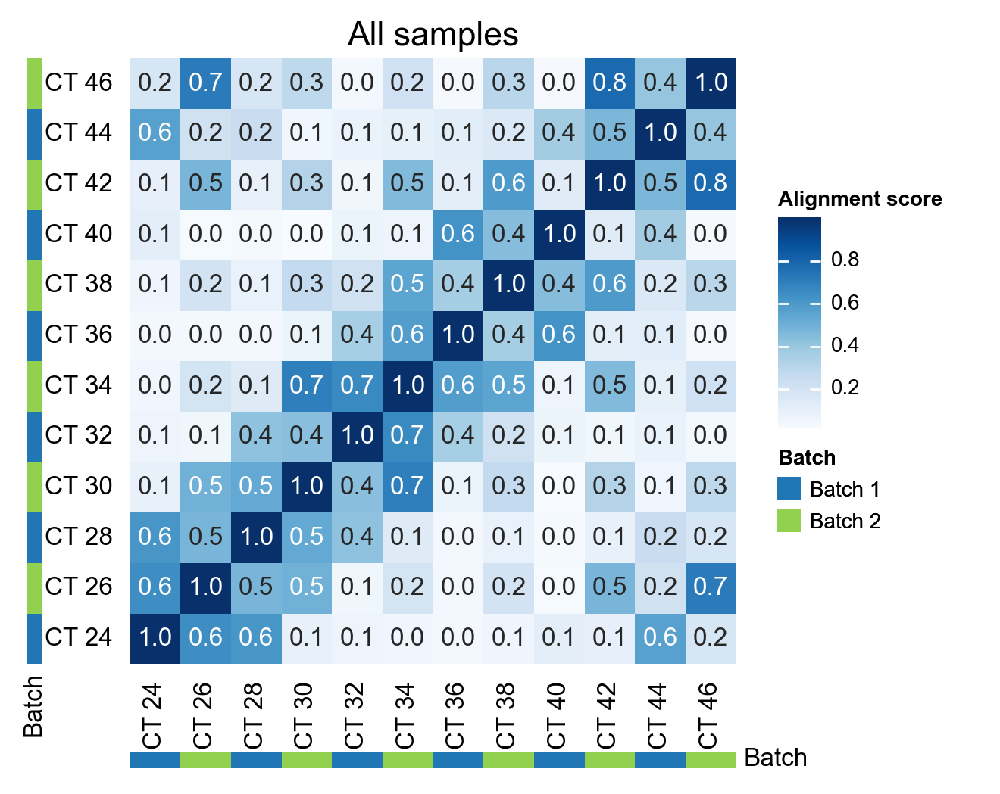

In [44]:
fig = plt.figure(figsize=(10, 8))
g0 = ma.Heatmap(
    df_alignScore,
    cmap="Blues",
    annot=True,
    fmt=lambda x: f"{x:.1f}",
    label="Alignment score",
)
g0.add_top(ma.plotter.Title("All samples", fontsize=16))
g0.add_bottom(mp.Labels(df_alignScore.columns.map(lambda x: "CT " + str(x))), pad=0.1)
g0.add_left(mp.Labels(df_alignScore.index.map(lambda x: "CT " + str(x))), pad=0.1)
g0.add_legends(side="right")

g0.add_left(
    mp.Colors(
        (df_alignScore.index % 4 == 0).tolist()
        >> F(lambda _: np.where(_, "Batch 1", "Batch 2")),
        palette=["#2077B4", "#92D050"],
        label="Batch",
        # label_loc="top",
    ),
    size=0.1,
)

g0.add_bottom(
    mp.Colors(
        (df_alignScore.columns % 4 == 0).tolist()
        >> F(lambda _: np.where(_, "Batch 1", "Batch 2")),
        palette=["#2077B4", "#92D050"],
        label="Batch",
        # label_loc="top",
    ),
    size=0.1, legend=False
)

g0.render(fig)

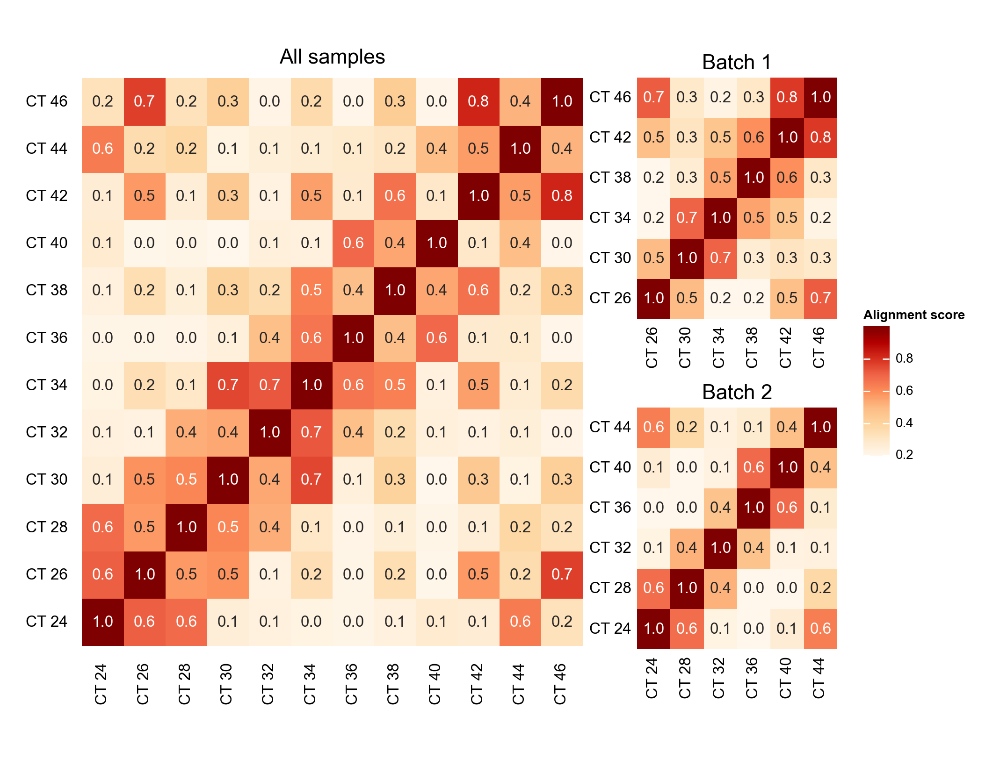

In [106]:
fig = plt.figure(figsize=(10, 8))
_ar = fig.subfigures(1, 2, width_ratios=(0.6, 0.3))
for x in _ar:
    x.set_size_inches = lambda *x, **y: None
figSub1 = _ar[0]


figSub2 = _ar[1]

g0 = ma.Heatmap(
    df_alignScore,
    cmap="OrRd",
    annot=True,
    fmt=lambda x: f"{x:.1f}",
    label="Alignment score",
)
g0.add_top(ma.plotter.Title("All samples", fontsize=16))
g0.add_bottom(mp.Labels(df_alignScore.columns.map(lambda x: "CT " + str(x))), pad=0.1)
g0.add_left(mp.Labels(df_alignScore.index.map(lambda x: "CT " + str(x))), pad=0.1)
# g0.add_legends(side='right')
g0.render(figSub1)

_df = df_alignScore.iloc[::2, 1::2]
g1 = ma.Heatmap(
    _df,
    cmap="OrRd",
    annot=True,
    fmt=lambda x: f"{x:.1f}",
    label="Alignment score",
    name="1",
)
g1.add_top(ma.plotter.Title("Batch 1", fontsize=16), pad=0.1)
g1.add_bottom(mp.Labels(_df.columns.map(lambda x: "CT " + str(x))), pad=0.1)
g1.add_left(mp.Labels(_df.index.map(lambda x: "CT " + str(x))), pad=0.1)

_df = df_alignScore.iloc[1::2, ::2]
g2 = ma.Heatmap(
    _df, cmap="OrRd", annot=True, fmt=lambda x: f"{x:.1f}", label="Alignment score"
)
g2.add_top(ma.plotter.Title("Batch 2", fontsize=16), pad=0.1)
g2.add_bottom(mp.Labels(_df.columns.map(lambda x: "CT " + str(x))), pad=0.1)
g2.add_left(mp.Labels(_df.index.map(lambda x: "CT " + str(x))), pad=0.1)

g = g1 / 0.5 / g2 / 1.2
g.append("top", 0.75)
g.add_legends(order=["1"])
g.render(figSub2)

# plot core driver genes

In [85]:
import scipy

In [86]:
ad_mergeAllCt = singleCellTools.geneEnrichInfo._mergeData(ad, ["CT"], "sx")

In [87]:
ad_mergeAllCt.obs["Batch"] = np.where(ad_mergeAllCt.obs["CT"].astype(int) % 4, "2", "1")

In [88]:
singleCellTools.basic.initLayer(ad_mergeAllCt, total=1e6, logbase=2)

In [89]:
ad_mergeAllCt.layers["normalize"] = np.exp2(ad_mergeAllCt.layers["normalize_log"]) - 1

In [214]:
_df = (
    ad_mergeAllCt.to_df("normalize_log")
    .join(ad_mergeAllCt.obs[["Batch"]])
    .groupby(["Batch"])
    .apply(scipy.stats.zscore, axis=0)
)
ad_mergeAllCt.layers["zscore"] = _df

In [215]:
_df = ad_mergeAllCt.to_df("normalize_log").apply(scipy.stats.zscore, axis=0)
ad_mergeAllCt.layers["zscore_oneBatch"] = _df

In [206]:
ls_plotGenes = [
    "AT2G46830",
    "AT1G01060",
    "AT2G46790",
    "AT5G02810",
    "AT3G09600",
    "AT5G52660",
    "AT5G02840",
    "AT5G64170",
    "AT3G54500",
    "AT5G24470",
    "AT5G60100",
    "AT5G61380",
    "AT1G22770",
    "AT5G59570",
    "AT3G46640",
    "AT2G40080",
    "AT2G25930",
    'AT5G57360',
    'AT3G02780'
]
ls_plotNames = [
    "CCA1",
    "LHY",
    "PRR9",
    "PRR7",
    "RVE8",
    "RVE6",
    "RVE4",
    "LNK1",
    "LNK2",
    "PRR5",
    "PRR3",
    "TOC1",
    "GI",
    "BOA",
    "LUX",
    "ELF4",
    "ELF3",
    'ZTL',
    'IPP2'
]
dt_plotGenes = dict(zip(ls_plotNames, ls_plotGenes))
dt_plotGenes

{'CCA1': 'AT2G46830',
 'LHY': 'AT1G01060',
 'PRR9': 'AT2G46790',
 'PRR7': 'AT5G02810',
 'RVE8': 'AT3G09600',
 'RVE6': 'AT5G52660',
 'RVE4': 'AT5G02840',
 'LNK1': 'AT5G64170',
 'LNK2': 'AT3G54500',
 'PRR5': 'AT5G24470',
 'PRR3': 'AT5G60100',
 'TOC1': 'AT5G61380',
 'GI': 'AT1G22770',
 'BOA': 'AT5G59570',
 'LUX': 'AT3G46640',
 'ELF4': 'AT2G40080',
 'ELF3': 'AT2G25930',
 'ZTL': 'AT5G57360',
 'IPP2': 'AT3G02780'}

In [211]:
dt_coreGene = {x:dt_coreGene[x] for x in dt_plotGenes.values() if x in dt_coreGene.keys()}
dt_coreGene

{'AT2G46830': 'CCA1',
 'AT1G01060': 'LHY',
 'AT2G46790': 'PRR9',
 'AT5G02810': 'PRR7',
 'AT3G09600': 'RVE8',
 'AT5G52660': 'RVE6',
 'AT5G02840': 'RVE4',
 'AT5G64170': 'LNK1',
 'AT3G54500': 'LNK2',
 'AT5G24470': 'PRR5',
 'AT5G60100': 'PRR3',
 'AT5G61380': 'TOC1',
 'AT1G22770': 'GI',
 'AT3G46640': 'LUX',
 'AT2G40080': 'ELF4',
 'AT2G25930': 'ELF3',
 'AT5G57360': 'ZTL'}

In [217]:
ls_symOrder = "CCA1, LHY, RVE4, RVE8, RVE6, LNK1, LNK2, PRR9, PRR7, PRR5, PRR3, TOC1, GI, LUX, ELF4, ELF3, ZTL".split(', ')
dt_plotGenes = {k:dt_plotGenes[k] for k in ls_symOrder}

In [82]:
import importlib
importlib.reload(utils)

<module 'utils' from '/public/home/liuzj/notebooks/circadian/20221122/soupX/utils.py'>

<Figure size 640x480 with 0 Axes>

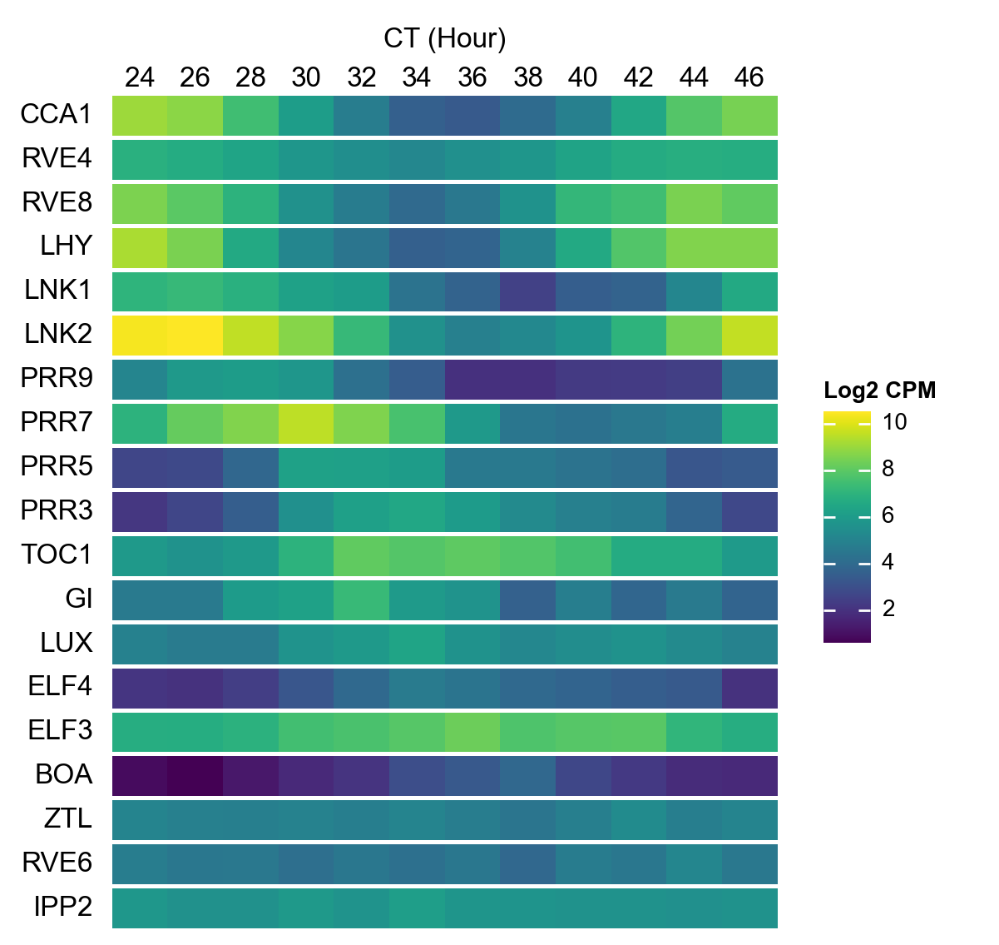

In [379]:
h1 = utils.heatmapMultiGeneInDifferentTime(ad_mergeAllCt, 'normalize_log', dt_plotGenes.values() >> F(list), dt_plotGenes.keys() >> F(list), 'Log2 CPM', cmap='viridis', scale=False)

In [83]:
import importlib
importlib.reload(utils)

<module 'utils' from '/public/home/liuzj/notebooks/circadian/20221122/soupX/utils.py'>

<Figure size 640x480 with 0 Axes>

{'AT5G64170': 'LNK1',
 'AT5G61380': 'TOC1',
 'AT5G60100': 'PRR3',
 'AT5G57360': 'ZTL',
 'AT5G52660': 'RVE6',
 'AT5G24470': 'PRR5',
 'AT5G02840': 'RVE4',
 'AT5G02810': 'PRR7',
 'AT3G54500': 'LNK2',
 'AT3G46640': 'LUX',
 'AT3G09600': 'RVE8',
 'AT2G46830': 'CCA1',
 'AT2G46790': 'PRR9',
 'AT2G40080': 'ELF4',
 'AT2G25930': 'ELF3',
 'AT1G22770': 'GI',
 'AT1G01060': 'LHY'}

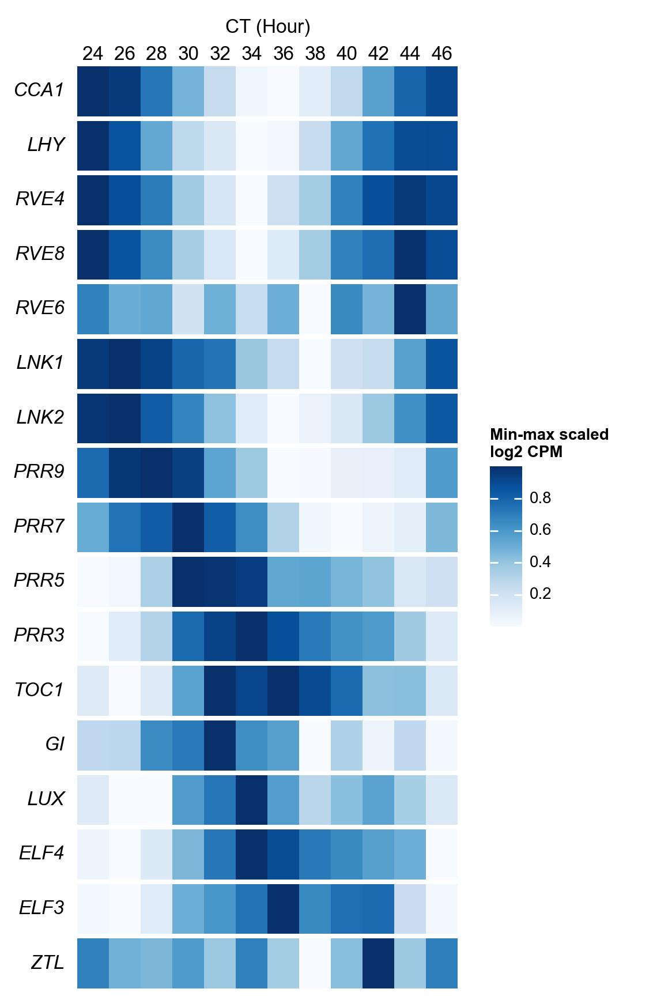

In [218]:
h2 = utils.heatmapMultiGeneInDifferentTime(
    ad_mergeAllCt, 'normalize_log', dt_plotGenes.values() >> F(list), dt_plotGenes.keys() >> F(list), 'Min-max scaled\nlog2 CPM', cmap='Blues', scale=True, height=8
)

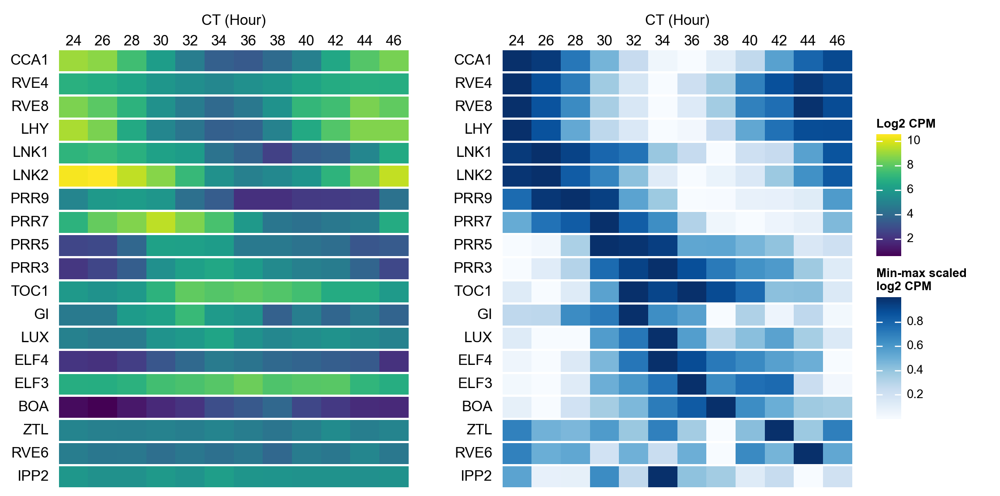

In [381]:
h = (h1+0.5+h2)
h.add_legends()
h.render()

In [188]:
ls_coreGenes = [
    "AT2G46830",
    "AT1G01060",
    "AT1G12910",
    "AT3G26640",
    "AT2G46790",
    "AT5G02810",
    "AT3G09600",
    "AT5G52660",
    "AT5G02840",
    "AT5G64170",
    "AT3G54500",
    "AT5G24470",
    "AT5G60100",
    "AT5G61380",
    "AT5G08330",
    "AT1G22770",
    "AT5G59570",
    "AT3G46640",
    "AT2G40080",
    "AT2G25930",
]
ls_coreGeneNames = [
    "CCA1",
    "LHY",
    "LWD1",
    "LWD2",
    "PRR9",
    "PRR7",
    "RVE8",
    "RVE6",
    "RVE4",
    "LNK1",
    "LNK2",
    "PRR5",
    "PRR3",
    "TOC1",
    "CHE",
    "GI",
    "BOA",
    "LUX",
    "ELF4",
    "ELF3",
]
dt_coreGene = dict(zip(ls_coreGenes, ls_coreGeneNames))
dt_coreGene

{'AT2G46830': 'CCA1',
 'AT1G01060': 'LHY',
 'AT1G12910': 'LWD1',
 'AT3G26640': 'LWD2',
 'AT2G46790': 'PRR9',
 'AT5G02810': 'PRR7',
 'AT3G09600': 'RVE8',
 'AT5G52660': 'RVE6',
 'AT5G02840': 'RVE4',
 'AT5G64170': 'LNK1',
 'AT3G54500': 'LNK2',
 'AT5G24470': 'PRR5',
 'AT5G60100': 'PRR3',
 'AT5G61380': 'TOC1',
 'AT5G08330': 'CHE',
 'AT1G22770': 'GI',
 'AT5G59570': 'BOA',
 'AT3G46640': 'LUX',
 'AT2G40080': 'ELF4',
 'AT2G25930': 'ELF3'}

{'AT2G46830': 'CCA1',
 'AT1G01060': 'LHY',
 'AT2G46790': 'PRR9',
 'AT5G02810': 'PRR7',
 'AT3G09600': 'RVE8',
 'AT5G52660': 'RVE6',
 'AT5G02840': 'RVE4',
 'AT5G64170': 'LNK1',
 'AT3G54500': 'LNK2',
 'AT5G24470': 'PRR5',
 'AT5G60100': 'PRR3',
 'AT5G61380': 'TOC1',
 'AT1G22770': 'GI',
 'AT5G59570': 'BOA',
 'AT3G46640': 'LUX',
 'AT2G40080': 'ELF4',
 'AT2G25930': 'ELF3',
 'AT5G57360': 'ZTL',
 'AT2G21320': 'BBX18',
 'AT4G38960': 'BBX19'}

In [186]:
import legendkit
from matplotlib.legend_handler import HandlerLine2D

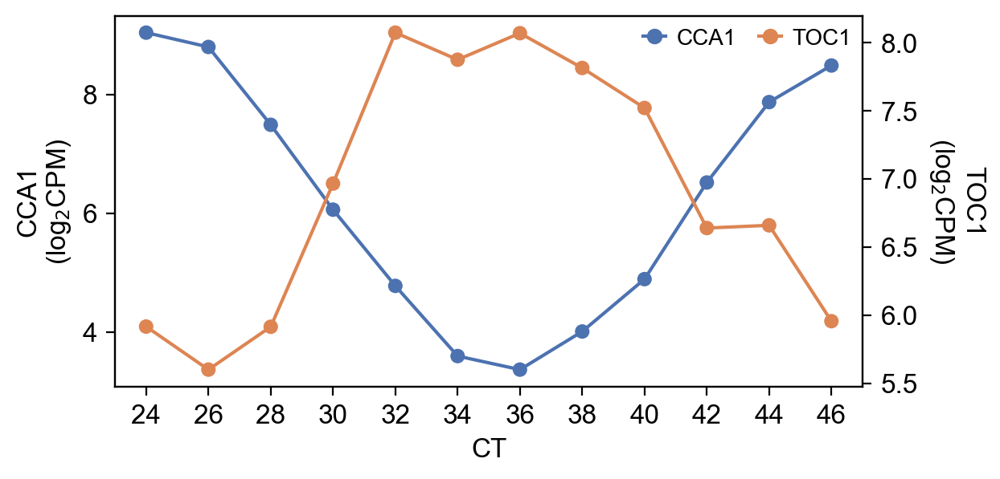

In [191]:
_df = (
    ad_mergeAllCt[:, ["AT2G46830", "AT5G61380"]]
    .to_df("normalize_log")
    .join(ad_mergeAllCt.obs[["CT"]])
)
_df = _df.melt("CT", var_name="gene", value_name="CPM")
_df["name"] = _df["gene"].map(dt_coreGene)
fig, ax1 = plt.subplots(figsize=(6, 3))
ax2 = ax1.twinx()

(
    so.Plot(_df.query("gene=='AT2G46830'"), x="CT", y="CPM")
    .add(so.Dot(color="#4C72B0"))
    .add(so.Line(color="#4C72B0"))
    .theme(dt_snsStyle)
    .label(color="", y="CCA1\n(log$_{2}$CPM)")
    .on(ax1)
    .plot()
)

(
    so.Plot(_df.query("gene=='AT5G61380'"), x="CT", y="CPM")
    .add(so.Dot(color="#DD8553"))
    .add(so.Line(color="#DD8553"))
    .theme(dt_snsStyle)
    .label(color="", y="TOC1\n(log$_{2}$CPM)")
    .on(ax2)
    .plot()
)

legendkit.legend(
    ax2,
    loc="upper right",
    ncol=2,
    legend_items=[
        ("line", "CCA1", {"color": "#4C72B0", "marker": "o"}),
        ("line", "TOC1", {"color": "#DD8553", "marker": "o"}),
    ],
)
ax2.set_ylabel(ax2.get_ylabel(), rotation=270, labelpad=30)
plt.show()

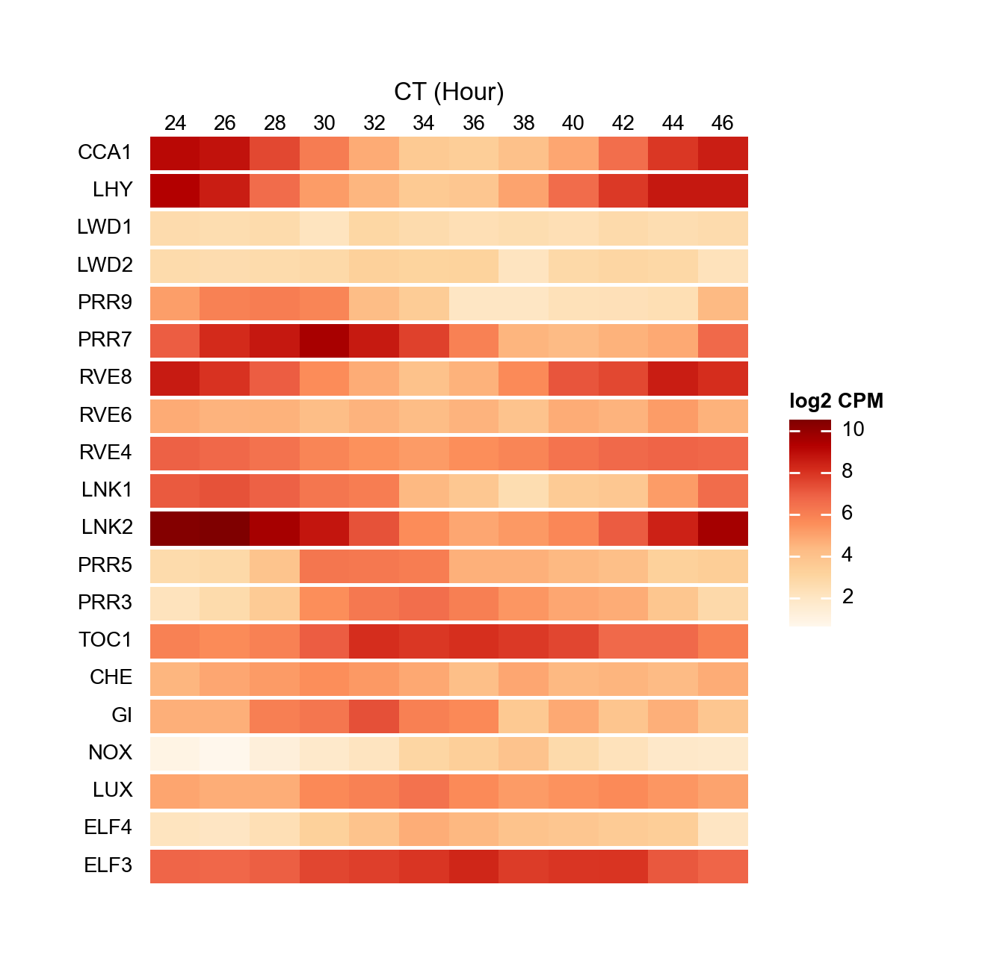

In [663]:
_df = ad_mergeAllCt[:, ls_coreGenes].to_df("normalize_log").T
# _ar = sklearn.preprocessing.minmax_scale(_df, axis=1)
# _df = pd.DataFrame(_ar, index=_df.index, columns=_df.columns)
# _df = _df.loc[_df.idxmax(axis=1).sort_values().index]

h = ma.Heatmap(_df, cmap="OrRd", label="log2 CPM", width=4, height=5)
h.hsplit(labels=_df.index, order=_df.index, spacing=0.005)
# h.add_dendrogram('right')
h.add_left(ma.plotter.Labels([dt_coreGene[x] for x in _df.index]), pad=0.1)
h.add_top(ma.plotter.Labels(_df.columns, rotation=0, align="center"), pad=0.01)
h.add_legends(
    pad=0.1,
)
h.add_top(ma.plotter.Title("CT (Hour)"))
h.add_legends()
h.render()

,24,26,28,30,32,34,36,38,40,42,44,46
AT2G46830,9.045261,8.803550,7.491546,6.060996,4.776358,3.592837,3.364502,4.007006,4.890057,6.519096,7.874255,8.491459
AT1G01060,9.255462,8.503685,6.578229,5.156116,4.430422,3.592837,3.751405,4.952992,6.591099,7.824445,8.630638,8.640116
AT5G02840,6.880252,6.680987,6.386915,5.810267,5.467898,5.186270,5.551034,5.789644,6.355585,6.672168,6.820388,6.732244
AT3G09600,8.569237,7.957153,6.957258,5.574714,4.703571,3.981884,4.578399,5.640011,7.146962,7.469275,8.522773,8.084369
AT3G54500,10.392892,10.515607,9.549563,8.699403,7.235198,5.577504,4.883212,5.243260,5.710371,7.022151,8.416871,9.622199
AT5G64170,7.062235,7.258868,6.907522,6.271379,6.023382,4.367482,3.718184,2.516821,3.502116,3.694445,5.162573,6.597267
AT2G46790,5.109116,5.919109,6.041890,5.801548,4.202883,3.490025,1.949118,1.965907,2.263267,2.298603,2.431034,4.336827
AT5G24470,2.672103,2.790192,3.866869,6.255505,6.194719,6.050665,4.596795,4.610837,4.363774,4.138531,3.229412,3.421117
AT5G08330,4.454746,4.869555,5.178640,5.533182,5.216463,4.834199,4.125399,4.865796,4.384117,4.501586,4.312721,4.702360
AT5G02810,6.987034,8.177031,8.639287,9.524357,8.586373,7.631146,5.935253,4.499380,4.293816,4.559834,4.782382,6.647822


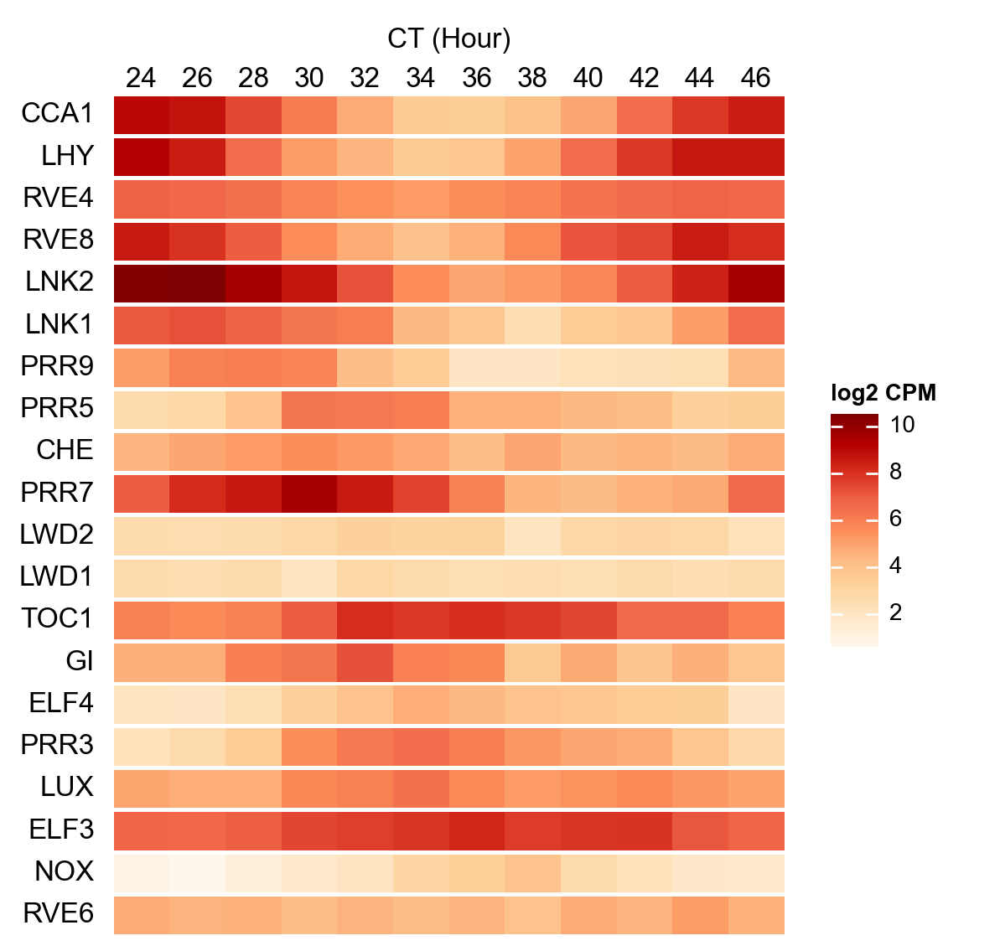

In [298]:
_df = ad_mergeAllCt[:, ls_coreGenes].to_df("normalize_log").T
_df = _df.assign(temp=_df.idxmax(1)).sort_values('temp').drop(columns='temp')
# _ar = sklearn.preprocessing.minmax_scale(_df, axis=1)
# _df = pd.DataFrame(_ar, index=_df.index, columns=_df.columns)
# _df = _df.loc[_df.idxmax(axis=1).sort_values().index]

h = ma.Heatmap(_df.values, cmap="OrRd", label="log2 CPM", width=4, height=5)
h.hsplit(labels=_df.index, order=_df.index, spacing=0.005)
# h.add_dendrogram('right')
h.add_left(ma.plotter.Labels([dt_coreGene[x] for x in _df.index]), pad=0.1)
h.add_top(ma.plotter.Labels(_df.columns, rotation=0, align="center"), pad=0.01)
h.add_legends(
    pad=0.1,
)
h.add_top(ma.plotter.Title("CT (Hour)"))
# h.add_dendrogram('left', method='ward')
h.add_legends()
h.render()

<Figure size 640x480 with 0 Axes>

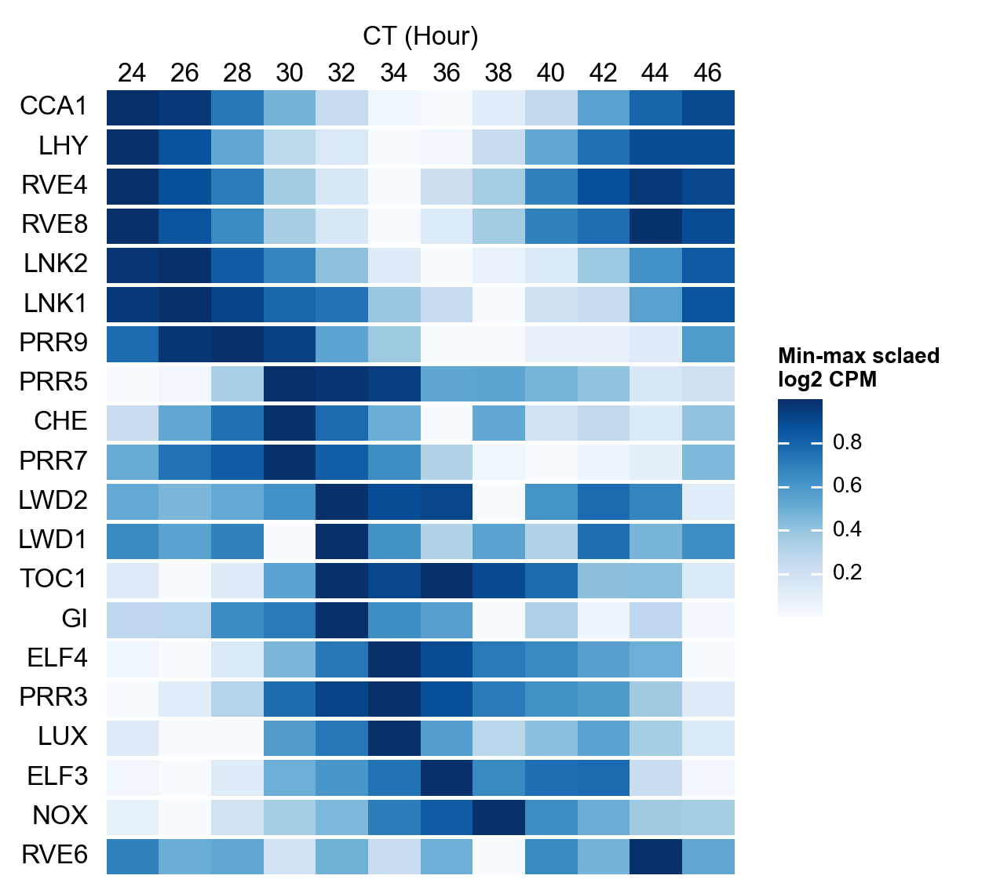

In [300]:
import sklearn

_df = ad_mergeAllCt[:, ls_coreGenes].to_df("normalize_log").T
_df = _df.assign(temp=_df.idxmax(1)).sort_values('temp').drop(columns='temp')

_ar = sklearn.preprocessing.minmax_scale(_df, axis=1)
_df = pd.DataFrame(_ar, index=_df.index, columns=_df.columns)
# _df = _df.loc[_df.idxmax(axis=1).sort_values().index]
h1 = ma.Heatmap(
    _df.values, cmap="Blues", label="Min-max sclaed\nlog2 CPM", width=4, height=5
)
h1.hsplit(labels=_df.index, order=_df.index, spacing=0.005)
# h1.add_dendrogram('right')
h1.add_left(ma.plotter.Labels([dt_coreGene[x] for x in _df.index]), pad=0.1)
h1.add_top(ma.plotter.Labels(_df.columns, rotation=0, align="center"), pad=0.01)
h1.add_legends(
    pad=0.1,
)
h1.add_top(ma.plotter.Title("CT (Hour)"))
# h1.add_dendrogram('left', method='ward')

h1.add_legends()
h1.render()

In [306]:
ls_coreGenes

['AT2G46830',
 'AT1G01060',
 'AT1G12910',
 'AT3G26640',
 'AT2G46790',
 'AT5G02810',
 'AT3G09600',
 'AT5G52660',
 'AT5G02840',
 'AT5G64170',
 'AT3G54500',
 'AT5G24470',
 'AT5G60100',
 'AT5G61380',
 'AT5G08330',
 'AT1G22770',
 'AT5G59570',
 'AT3G46640',
 'AT2G40080',
 'AT2G25930']

In [311]:
dt_coreGene

{'AT2G46830': 'CCA1',
 'AT1G01060': 'LHY',
 'AT2G46790': 'PRR9',
 'AT5G02810': 'PRR7',
 'AT3G09600': 'RVE8',
 'AT5G52660': 'RVE6',
 'AT5G02840': 'RVE4',
 'AT5G64170': 'LNK1',
 'AT3G54500': 'LNK2',
 'AT5G24470': 'PRR5',
 'AT5G60100': 'PRR3',
 'AT5G61380': 'TOC1',
 'AT1G22770': 'GI',
 'AT5G59570': 'BOA',
 'AT3G46640': 'LUX',
 'AT2G40080': 'ELF4',
 'AT2G25930': 'ELF3'}

In [336]:
['AT2G46830',
 'AT4G38960',
 'AT2G21320',
 'AT5G02840',
 'AT3G09600',
 'AT1G01060',
 'AT5G64170',
 'AT3G54500',
 'AT2G46790',
 'AT5G02810',
 'AT5G24470',
 'AT5G60100',
 'AT5G61380',
 'AT1G22770',
 'AT3G46640',
 'AT2G40080',
 'AT2G25930',
 'AT5G59570',
 'AT5G57360',
 'AT5G52660'] >> F(lambda _: [dt_coreGene[x] for x in _])

['CCA1',
 'BBX19',
 'BBX18',
 'RVE4',
 'RVE8',
 'LHY',
 'LNK1',
 'LNK2',
 'PRR9',
 'PRR7',
 'PRR5',
 'PRR3',
 'TOC1',
 'GI',
 'LUX',
 'ELF4',
 'ELF3',
 'BOA',
 'ZTL',
 'RVE6']

In [337]:
ls_adjOrder = ['AT2G46830',
 'AT4G38960',
 'AT2G21320',
 'AT5G02840',
 'AT3G09600',
 'AT1G01060',
 'AT5G64170',
 'AT3G54500',
 'AT2G46790',
 'AT5G02810',
 'AT5G24470',
 'AT5G60100',
 'AT5G61380',
 'AT1G22770',
 'AT3G46640',
 'AT2G40080',
 'AT2G25930',
 'AT5G59570',
 'AT5G57360',
 'AT5G52660']

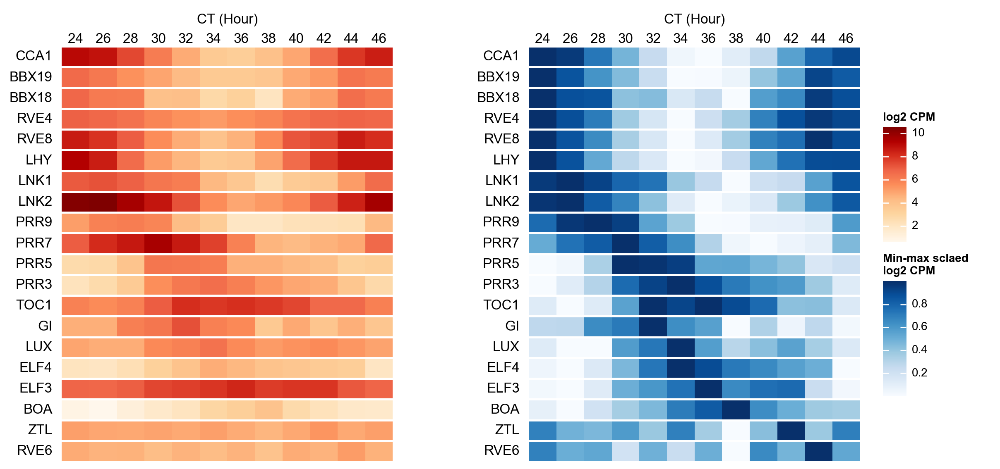

In [339]:
# _ls = ['8:00', '10:00', '12:00', '14:00', '16:00', '18:00', '20:00', '22:00', '0:00', '2:00', '4:00', '6:00']

_df = ad_mergeAllCt[:, ls_coreGenes].to_df("normalize_log").T
_df = _df.assign(temp=_df.idxmax(1)).sort_values('temp').drop(columns='temp')
_df = _df.loc[ls_adjOrder]
# _ar = sklearn.preprocessing.minmax_scale(_df, axis=1)
# _df = pd.DataFrame(_ar, index=_df.index, columns=_df.columns)
# _df = _df.loc[_df.idxmax(axis=1).sort_values().index]

h = ma.Heatmap(_df, cmap="OrRd", label="log2 CPM", width=4, height=5)
h.hsplit(labels=_df.index, order=_df.index, spacing=0.005)
# h.add_dendrogram('right')
h.add_left(ma.plotter.Labels([dt_coreGene[x] for x in _df.index]), pad=0.1)
h.add_top(ma.plotter.Labels(_df.columns, rotation=0, align="center"), pad=0.01)
h.add_legends(
    pad=0.1,
)
h.add_top(ma.plotter.Title("CT (Hour)"))

import sklearn

_df = ad_mergeAllCt[:, ls_coreGenes].to_df("normalize_log").T
_ar = sklearn.preprocessing.minmax_scale(_df, axis=1)
_df = pd.DataFrame(_ar, index=_df.index, columns=_df.columns)
_df = _df.assign(temp=_df.idxmax(1)).sort_values('temp').drop(columns='temp')
_df = _df.loc[ls_adjOrder]

# _df = _df.loc[_df.idxmax(axis=1).sort_values().index]
h1 = ma.Heatmap(
    _df, cmap="Blues", label="Min-max sclaed\nlog2 CPM", width=4, height=5
)
h1.hsplit(labels=_df.index, order=_df.index, spacing=0.005)
# h1.add_dendrogram('right')
h1.add_left(ma.plotter.Labels([dt_coreGene[x] for x in _df.index]), pad=0.1)
h1.add_top(ma.plotter.Labels(_df.columns, rotation=0, align="center"), pad=0.01)
h1.add_legends(
    pad=0.1,
)
h1.add_top(ma.plotter.Title("CT (Hour)"))


h = h + 1 + h1
h.add_legends()
h.render()
# ax = h.get_main_ax()[0]
# ax.set_title('CT (Hour)', y=1.5)

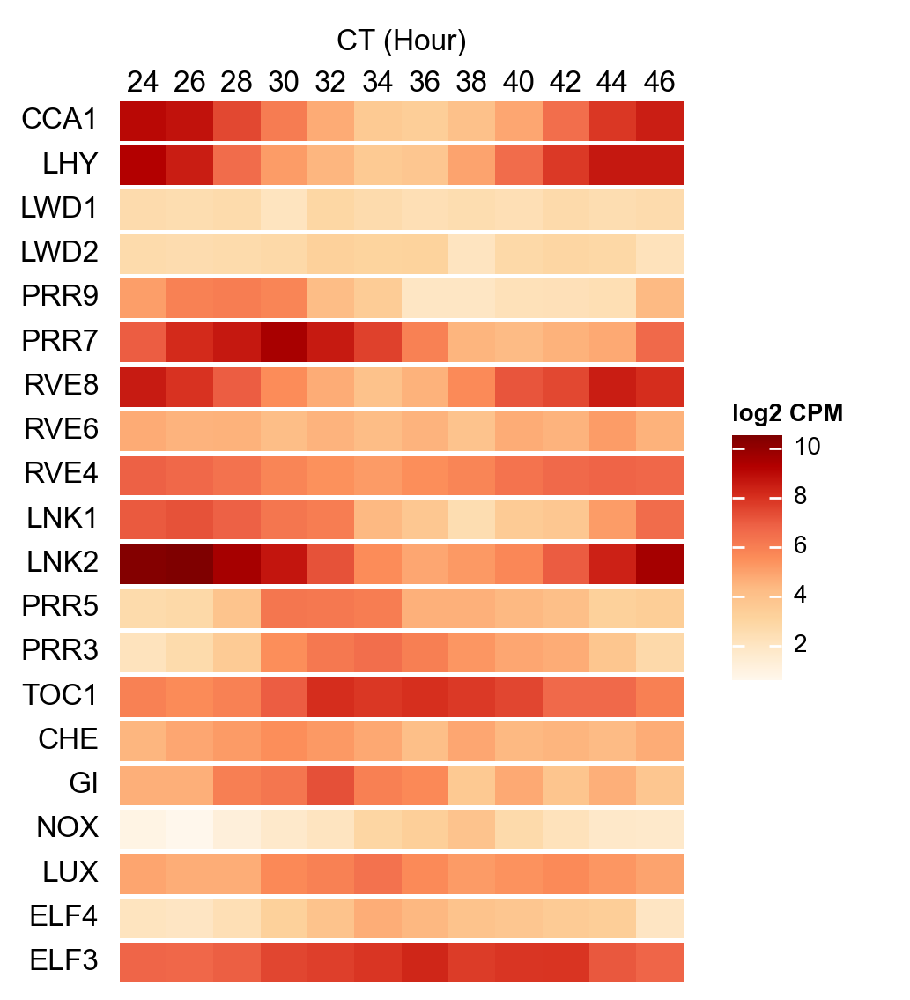

In [216]:
# _ls = ['8:00', '10:00', '12:00', '14:00', '16:00', '18:00', '20:00', '22:00', '0:00', '2:00', '4:00', '6:00']

_df = ad_mergeAllCt[:, ls_coreGenes].to_df("normalize_log").T
# _ar = sklearn.preprocessing.minmax_scale(_df, axis=1)
# _df = pd.DataFrame(_ar, index=_df.index, columns=_df.columns)
# _df = _df.loc[_df.idxmax(axis=1).sort_values().index]

h = ma.Heatmap(_df, cmap="OrRd", label="log2 CPM", width=3.2, height=5)
h.hsplit(labels=_df.index, order=_df.index, spacing=0.005)
# h.add_dendrogram('right')
h.add_left(ma.plotter.Labels([dt_coreGene[x] for x in _df.index]), pad=0.1)
h.add_top(ma.plotter.Labels(_df.columns, rotation=0, align="center"), pad=0.01)
h.add_legends(
    pad=0.1,
)
h.add_top(ma.plotter.Title("CT (Hour)"))

# import sklearn
# _df = ad_mergeAllCt[:, ls_coreGenes].to_df('normalize_log').T
# _ar = sklearn.preprocessing.minmax_scale(_df, axis=1)
# _df = pd.DataFrame(_ar, index=_df.index, columns=_df.columns)
# # _df = _df.loc[_df.idxmax(axis=1).sort_values().index]
# h1 = ma.Heatmap(_df, cmap='Blues', label="Min-max sclaed\nlog2 CPM", width=3.2, height=5)
# h1.hsplit(labels=_df.index, order=_df.index, spacing=0.005)
# # h1.add_dendrogram('right')
# h1.add_left(ma.plotter.Labels([dt_coreGene[x] for x in _df.index]), pad=0.1)
# h1.add_top(ma.plotter.Labels(_df.columns, rotation=0, align='center'), pad=0.01)
# h1.add_legends(pad=.1, )
# h1.add_top(ma.plotter.Title('CT (Hour)'))


# h = (h + .2 + h1)
h.add_legends()
h.render()
# ax = h.get_main_ax()[0]
# ax.set_title('CT (Hour)', y=1.5)

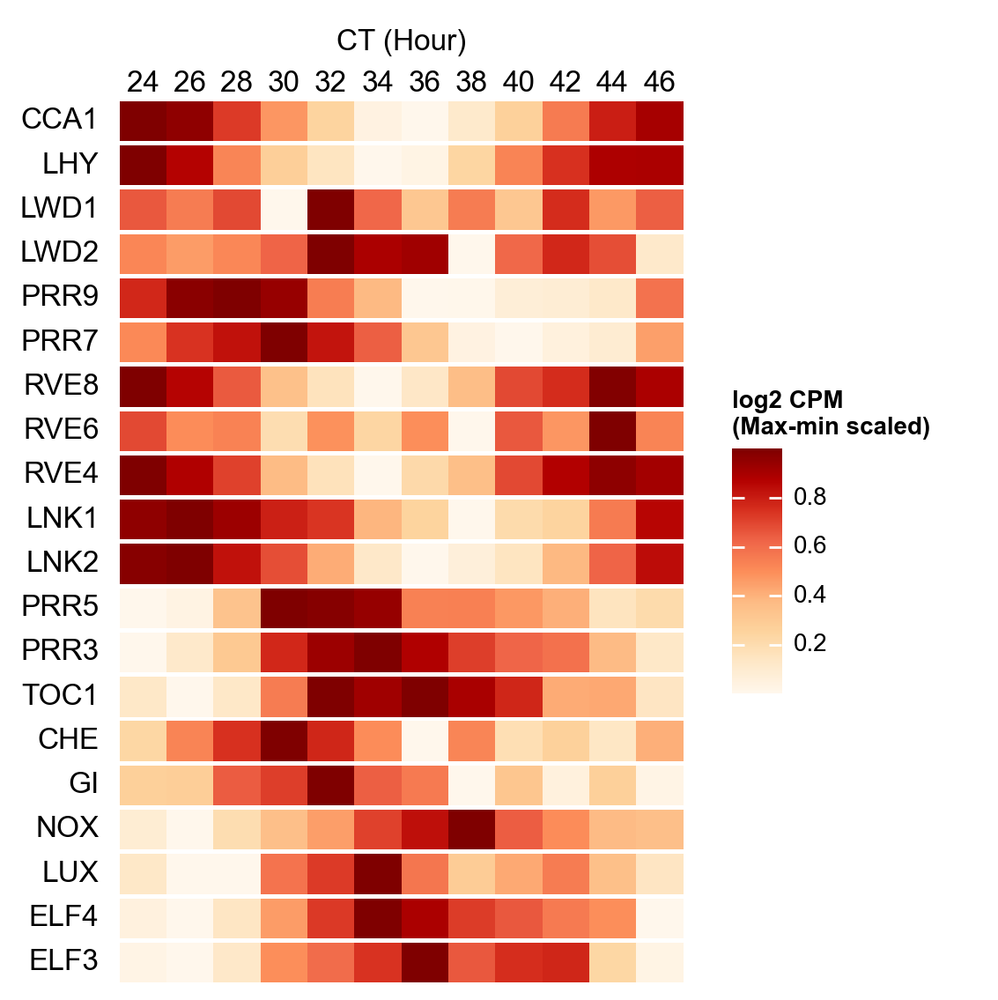

In [555]:
# _ls = ['8:00', '10:00', '12:00', '14:00', '16:00', '18:00', '20:00', '22:00', '0:00', '2:00', '4:00', '6:00']

_df = ad_mergeAllCt[:, ls_coreGenes].to_df("normalize_log").T
_df = _df.apply(lambda _: (_ - _.min()) / (_.max() - _.min()), axis=1)

# _ar = sklearn.preprocessing.minmax_scale(_df, axis=1)
# _df = pd.DataFrame(_ar, index=_df.index, columns=_df.columns)
# _df = _df.loc[_df.idxmax(axis=1).sort_values().index]

h = ma.Heatmap(_df, cmap="OrRd", label="log2 CPM\n(Max-min scaled)", width=3.2, height=5)
h.hsplit(labels=_df.index, order=_df.index, spacing=0.005)
# h.add_dendrogram('right')
h.add_left(ma.plotter.Labels([dt_coreGene[x] for x in _df.index]), pad=0.1)
h.add_top(ma.plotter.Labels(_df.columns, rotation=0, align="center"), pad=0.01)
h.add_legends(
    pad=0.1,
)
h.add_top(ma.plotter.Title("CT (Hour)"))

# import sklearn
# _df = ad_mergeAllCt[:, ls_coreGenes].to_df('normalize_log').T
# _ar = sklearn.preprocessing.minmax_scale(_df, axis=1)
# _df = pd.DataFrame(_ar, index=_df.index, columns=_df.columns)
# # _df = _df.loc[_df.idxmax(axis=1).sort_values().index]
# h1 = ma.Heatmap(_df, cmap='Blues', label="Min-max sclaed\nlog2 CPM", width=3.2, height=5)
# h1.hsplit(labels=_df.index, order=_df.index, spacing=0.005)
# # h1.add_dendrogram('right')
# h1.add_left(ma.plotter.Labels([dt_coreGene[x] for x in _df.index]), pad=0.1)
# h1.add_top(ma.plotter.Labels(_df.columns, rotation=0, align='center'), pad=0.01)
# h1.add_legends(pad=.1, )
# h1.add_top(ma.plotter.Title('CT (Hour)'))


# h = (h + .2 + h1)
h.add_legends()
h.render()
# ax = h.get_main_ax()[0]
# ax.set_title('CT (Hour)', y=1.5)

## SCT

In [23]:
from joblib import Parallel, delayed

In [24]:
# for sample, _ad in singleCellTools.basic.splitAdata(ad, "Sample", needName=True):
#     _ad.write_h5ad(
#         f"/data/Zhaijx/liuzj/projects/singleCell/02_jupyter/circadian/20221122/0628/{sample}.h5ad"
#     )

100%|██████████| 12/12 [00:36<00:00,  3.06s/it]


In [22]:
# from joblib import Parallel, delayed
# import os
# os.environ['R_HOME'] = '/public/home/liuzj/softwares/anaconda3/envs/circadian/lib/R'
# import rpy2
# import rpy2.robjects as ro
# from rpy2.robjects.packages import importr
# from jpy_tools.rTools import py2r, r2py, r_inline_plot, rHelp, trl, rSet, rGet, ad2so, so2ad, so2md, rcontext, Trl, r2py_re, py2r_re, RR, FR
# from jpy_tools import loadPkl, toPkl
# rBase = importr('base')
# rUtils = importr('utils')
# dplyr = importr('dplyr')
# reticulate = importr('reticulate')
# R = ro.r
# T = Trl()
# R("options(browser='firefox', shiny.port=6533, max.print=200)")
# importr("magrittr")
# import click
# import scanpy as sc
# from jpy_tools import loadPkl, toPkl
# from jpy_tools import singleCellTools
# @click.command()
# @click.option("--sample", default="sample", help="sample name")
# @click.option("--dir_path", default=".", help="dir path")
# def main(sample, dir_path):
#     ad = sc.read_h5ad(f"{dir_path}/{sample}.h5ad")
#     ad.X = ad.layers["sx"].copy()
#     sc.pp.filter_genes(ad, min_cells=1)
#     so_sample = singleCellTools.normalize.normalizeBySCT_r(
#         ad,
#         nTopGenes=3000,
#         returnSo=True,
#         layer='sx',
#     )
#     toPkl(
#         so_sample,
#         f"after_sct_{sample}.rds",
#         "ipf",
#         dir_path=dir_path,
#     )
# if __name__ == "__main__":
#     main()

AnnData object with n_obs × n_vars = 131152 × 24503
    obs: 'ambientRnaFractionEstimatedBySoupx', 'Sample', 'CT', 'n_genes', 'n_counts', 'percent_ct', 'outlier', '__group', 'Batch', 'leiden'
    var: 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'Batch_colors', 'CT_colors', 'Sample_colors', 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_pca_10', 'X_pca_harmony', 'X_umap', 'X_umap_concat_orig', 'X_umap_concat_orig_harmony', 'bulk_shared_circadian', 'scDblFinder'
    varm: 'PCs'
    layers: 'normalize_log', 'raw', 'soupX_corrected', 'sx', 'sx_log'
    obsp: 'connectivities', 'distances'

In [165]:
# def softMaskBySct(ad, sample, ls_continuousKeys):
#     import rpy2.robjects as ro

#     importr("magrittr")

#     ad.X = ad.layers["raw"].copy()
#     sc.pp.filter_genes(ad, min_cells=1)
#     so_sample = singleCellTools.normalize.normalizeBySCT_r(
#         ad,
#         nTopGenes=3000,
#         returnSo=True,
#     )
#     toPkl(
#         so_sample,
#         f"so_20230628_softMask_coreCircadian_sample_{sample}",
#         "ipf",
#         dir_path=dir_temp,
#     )

In [1]:
# Parallel(3)(
#     delayed(softMaskBySct)(ad_sample, sample, ls_coreGenes)
#     for sample, ad_sample in singleCellTools.basic.splitAdata(
#         ad, "Sample", needName=True
#     )
# )

In [25]:
dtAd_sctSample = {}
for sample in ls_sample:
    so_sample = loadPkl(
        f"after_sct_{sample}.rds",
        lambda **dt: ro.r.readRDS(**dt),
        arg_path="file",
        dir_path="/data/Zhaijx/liuzj/projects/singleCell/02_jupyter/circadian/20221122/0628/",
    )
    md_sample = so2md(so_sample)
    ad_sample = md_sample["SCT_scale.data"].copy()
    del md_sample
    dtAd_sctSample[sample] = ad_sample

2023-06-28 17:47:26 - WARNING - R[write to console]: Loading required package: SeuratObject

2023-06-28 17:47:26 - WARNING - R[write to console]: Loading required package: sp

2023-06-28 17:47:37 - WARNING - R[write to console]: 
Attaching package: ‘arrow’


2023-06-28 17:47:37 - WARNING - R[write to console]: The following object is masked from ‘package:utils’:

    timestamp


2023-06-28 17:47:38.441 | INFO     | jpy_tools.rTools:so2ad:573 - assay RNA: Variable features are already calculated. 4880 features are selected.
2023-06-28 17:48:02.810 | INFO     | jpy_tools.rTools:so2ad:573 - assay SCT: Variable features are already calculated. 3000 features are selected.
2023-06-28 17:48:28.025 | INFO     | jpy_tools.rTools:so2ad:573 - assay RNA: Variable features are already calculated. 4762 features are selected.
2023-06-28 17:48:46.028 | INFO     | jpy_tools.rTools:so2ad:573 - assay SCT: Variable features are already calculated. 3000 features are selected.
2023-06-28 17:49:30.346 | INFO

In [26]:
ls_hvg, df_remainGeneRank = singleCellTools.normalize.getHvgGeneFromSctAdata(
    dtAd_sctSample.values(), 3000, 3000
)

In [33]:
ad_sct = sc.concat(
    {x: y[:, y.var.index.isin(ls_hvg)] for x, y in dtAd_sctSample.items()}
)
del dtAd_sctSample

In [34]:
ad_sct.var["highly_variable"] = ad_sct.var.index.isin(ls_hvg)

In [35]:
ad_sct.X = ad_sct.layers["SCT_scale.data"]

In [37]:
sc.tl.pca(ad_sct)

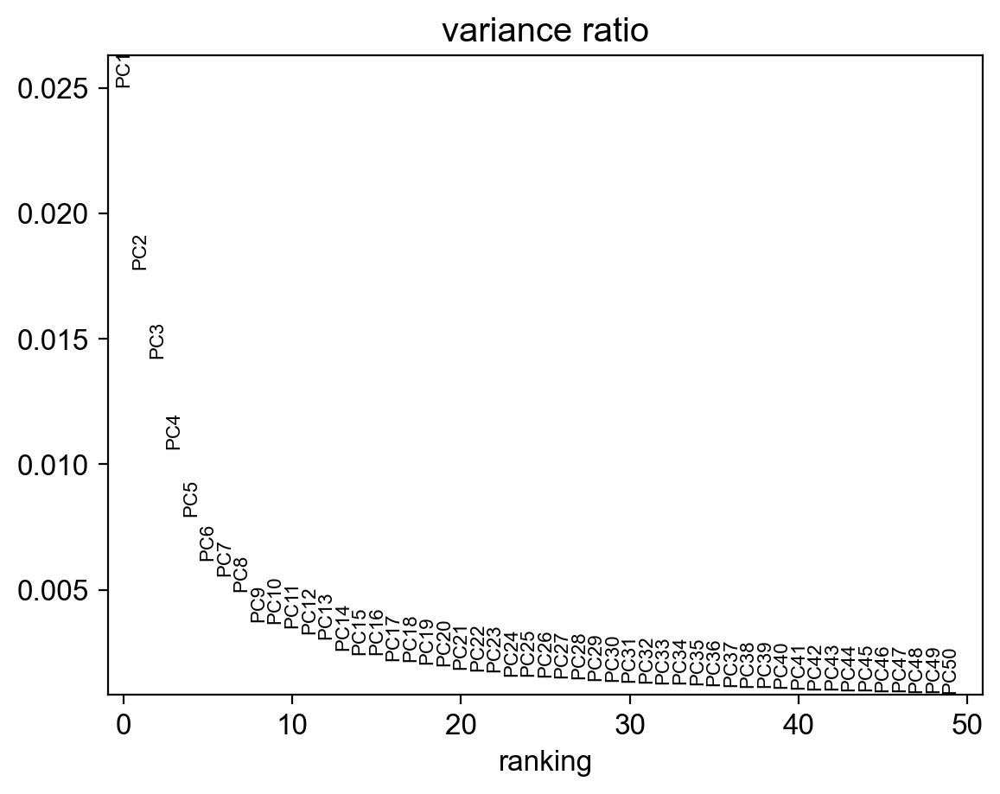

In [38]:
sc.pl.pca_variance_ratio(ad_sct, 50)

In [39]:
sc.pp.neighbors(ad_sct, n_pcs=30)

In [40]:
sc.tl.umap(ad_sct, 0.3)

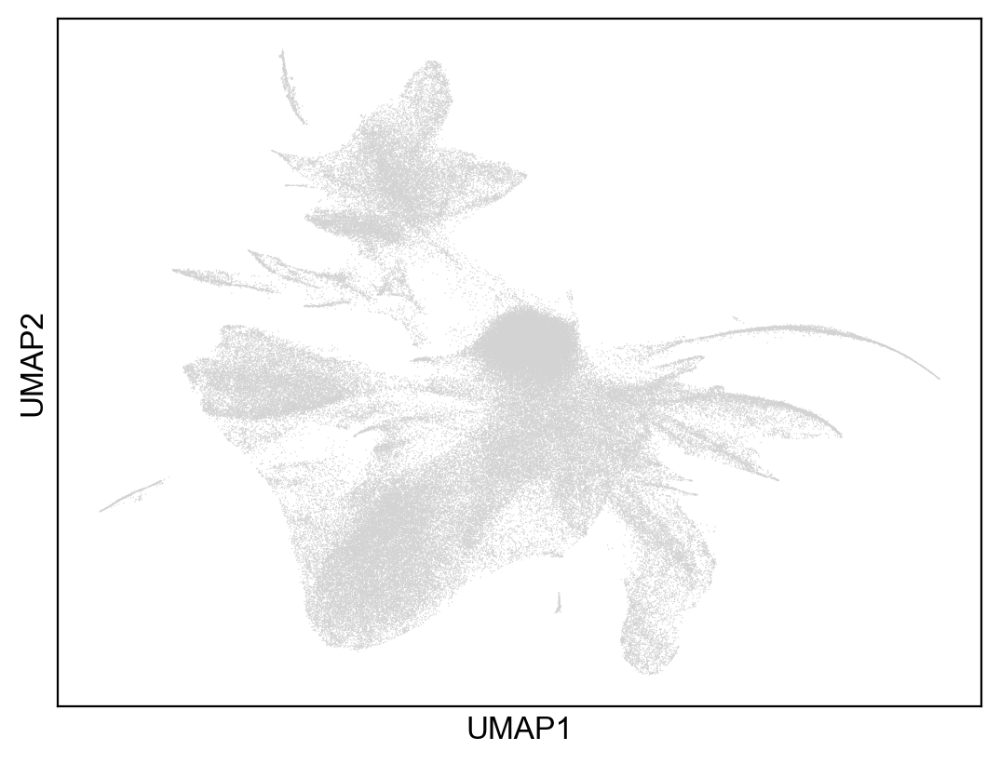

In [41]:
sc.pl.umap(ad_sct)

In [42]:
ad_sct.obs = ad.obs.copy()

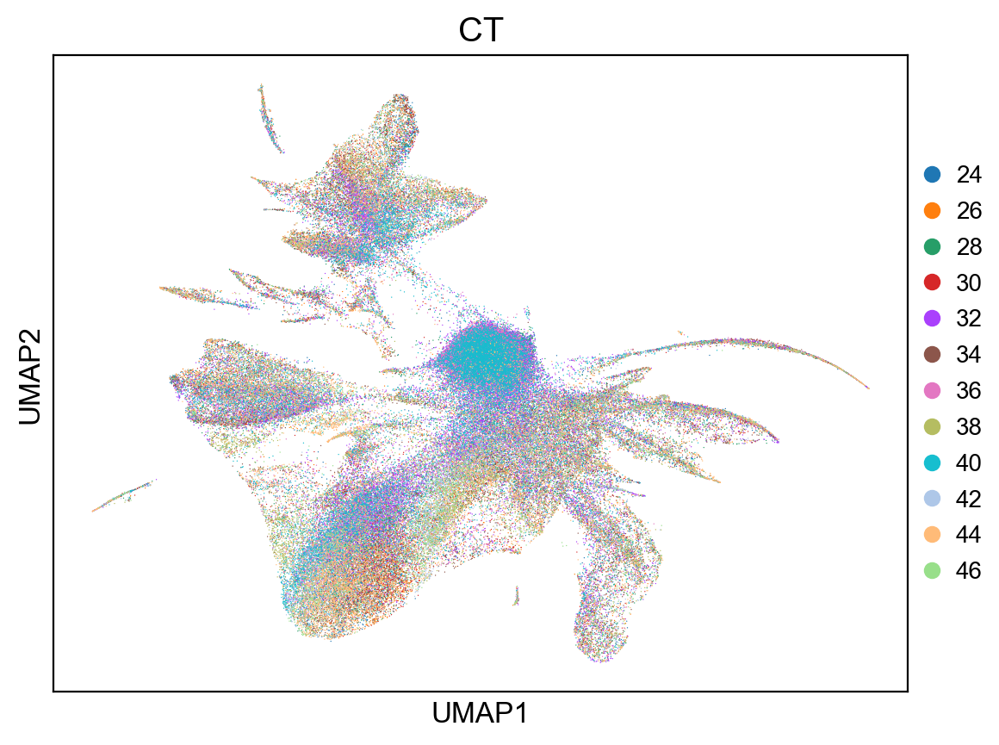

In [43]:
sc.pl.umap(ad_sct, color="CT")

## harmony

In [44]:
import scanpy.external as sce

In [45]:
ad_sct.obsm["X_pca_30"] = ad_sct.obsm["X_pca"][:, :30]

In [46]:
sce.pp.harmony_integrate(ad_sct, key="Batch", basis="X_pca_30")

2023-06-28 18:16:10,311 - harmonypy - INFO - Iteration 1 of 10
2023-06-28 18:16:10 - INFO - Iteration 1 of 10
2023-06-28 18:17:24,088 - harmonypy - INFO - Iteration 2 of 10
2023-06-28 18:17:24 - INFO - Iteration 2 of 10
2023-06-28 18:18:26,128 - harmonypy - INFO - Iteration 3 of 10
2023-06-28 18:18:26 - INFO - Iteration 3 of 10
2023-06-28 18:19:29,201 - harmonypy - INFO - Iteration 4 of 10
2023-06-28 18:19:29 - INFO - Iteration 4 of 10
2023-06-28 18:20:37,692 - harmonypy - INFO - Iteration 5 of 10
2023-06-28 18:20:37 - INFO - Iteration 5 of 10
2023-06-28 18:21:42,884 - harmonypy - INFO - Iteration 6 of 10
2023-06-28 18:21:42 - INFO - Iteration 6 of 10
2023-06-28 18:22:47,084 - harmonypy - INFO - Iteration 7 of 10
2023-06-28 18:22:47 - INFO - Iteration 7 of 10
2023-06-28 18:23:23,209 - harmonypy - INFO - Iteration 8 of 10
2023-06-28 18:23:23 - INFO - Iteration 8 of 10
2023-06-28 18:24:31,137 - harmonypy - INFO - Converged after 8 iterations
2023-06-28 18:24:31 - INFO - Converged after 8

In [47]:
sc.pp.neighbors(ad_sct, use_rep="X_pca_harmony")

In [48]:
sc.tl.umap(ad_sct, 0.3)

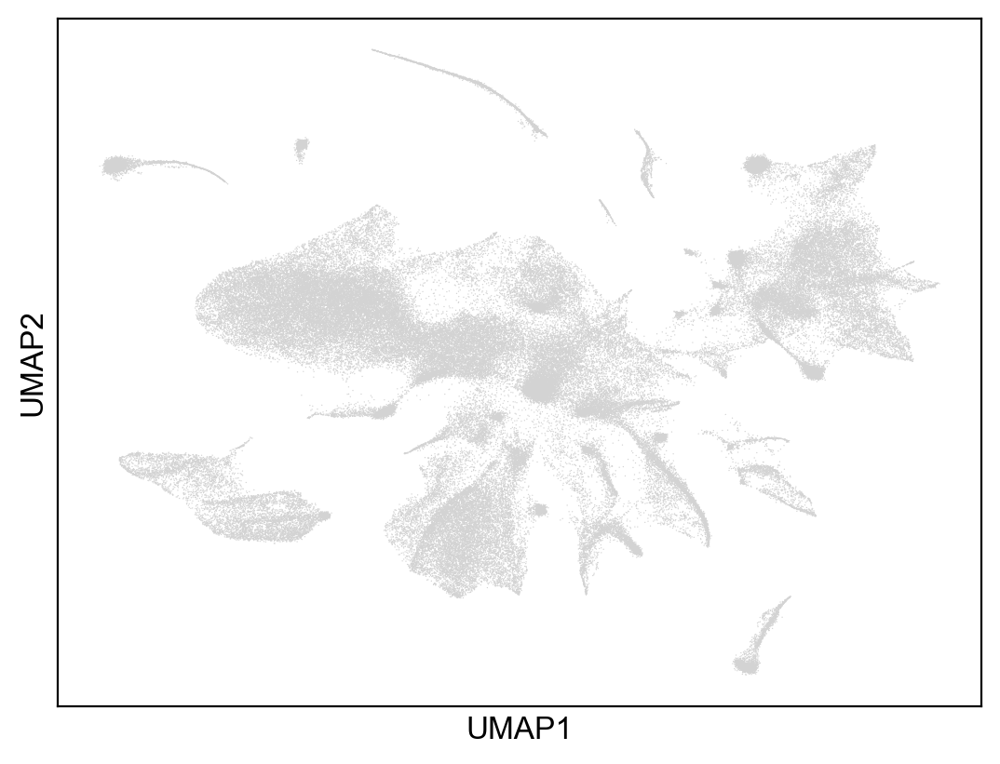

In [49]:
sc.pl.umap(ad_sct)

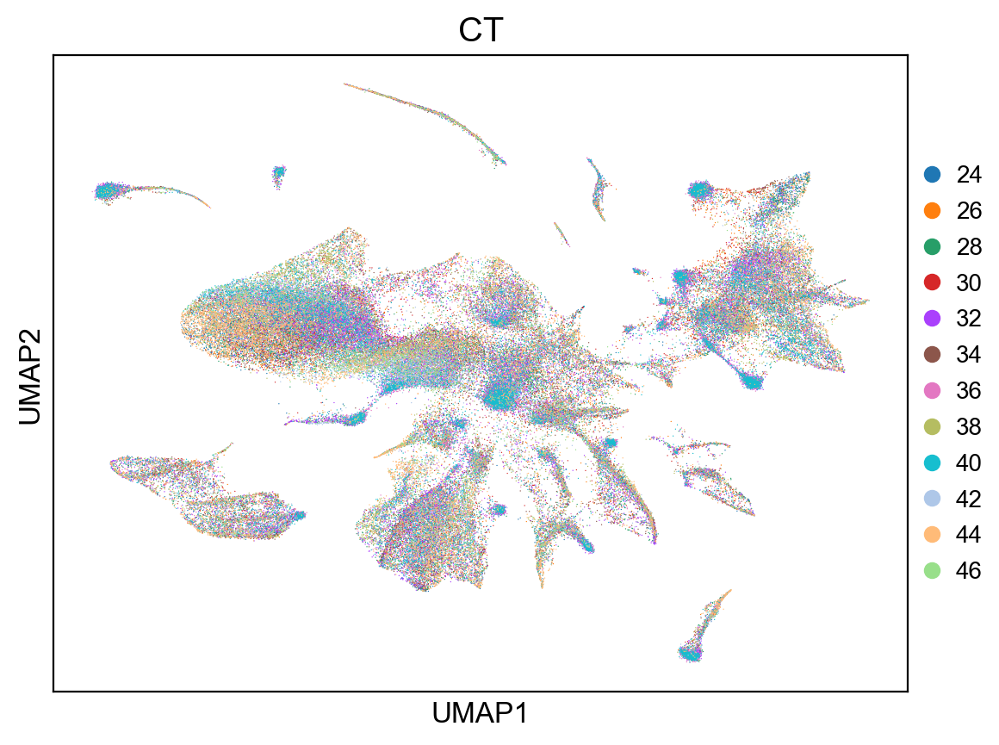

In [50]:
sc.pl.umap(ad_sct, color="CT")

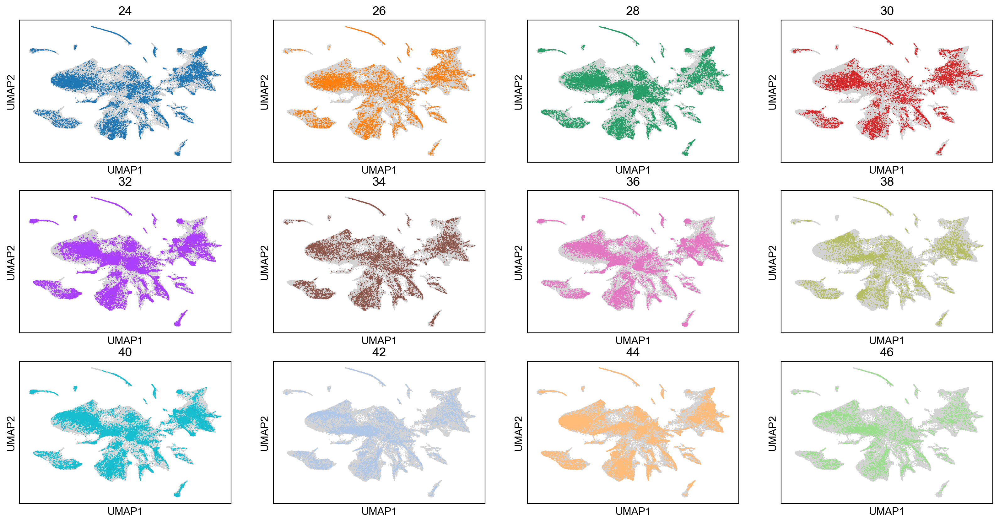

In [51]:
fig, axs = plt.subplots(3, 4, figsize=(20, 10))
axs = axs.reshape(-1)
for sample, ax in zip(ad_sct.obs["CT"].cat.categories, axs):
    sc.pl.umap(
        ad_sct, color="CT", groups=[sample], ax=ax, show=False, legend_loc=None, size=5
    )
    ax.set_title(sample)
plt.show()

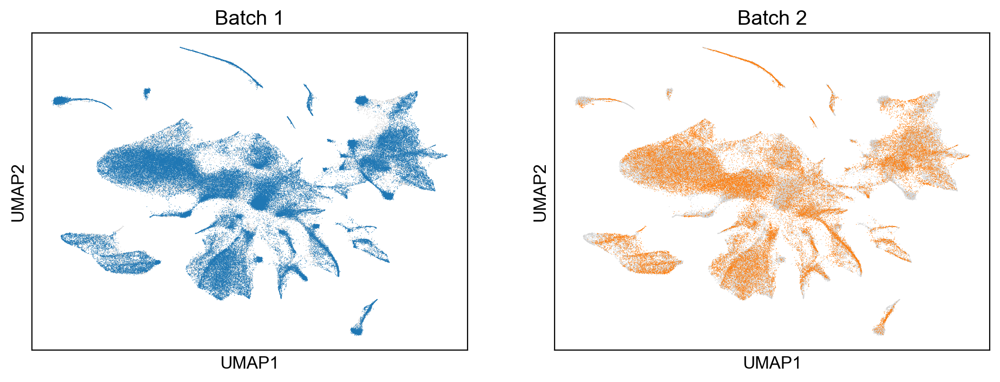

In [52]:
fig, axs = plt.subplots(1, 2, figsize=(12, 4))
sc.pl.embedding(
    ad_sct,
    "umap",
    color="Batch",
    groups=["1"],
    ax=axs[0],
    show=False,
    title="Batch 1",
    legend_loc=None,
)
sc.pl.embedding(
    ad_sct,
    "umap",
    color="Batch",
    groups=["2"],
    ax=axs[1],
    show=False,
    title="Batch 2",
    legend_loc=None,
)
plt.show()

In [53]:
toPkl(ad_sct, "ad_sct_20230628_after_sct", "ipf", dir_path=dir_temp)

2023-06-28 18:29:27.581 | INFO     | jpy_tools.otherTools:toPkl:476 - please run `loadPkl('ad_sct_20230628_after_sct', lambda **dt:sc.read_h5ad(**dt), arg_path='filename')` to get object


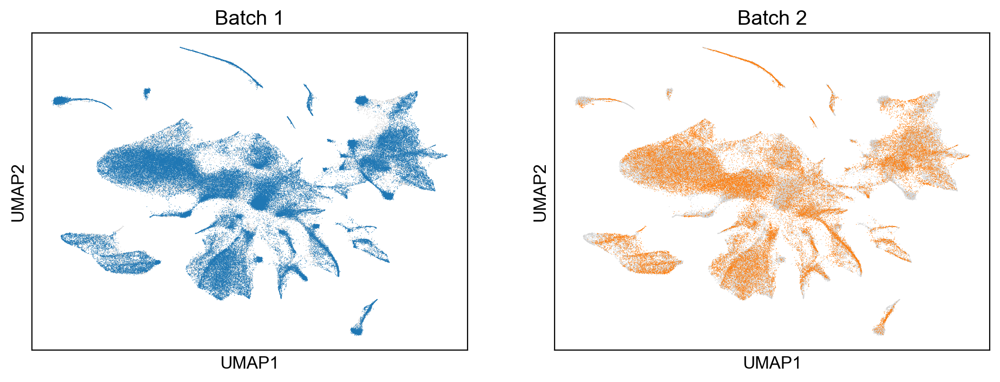

In [54]:
fig, axs = plt.subplots(1, 2, figsize=(12, 4))
sc.pl.umap(
    ad_sct,
    color="Batch",
    groups=["1"],
    ax=axs[0],
    show=False,
    title="Batch 1",
    legad_sctend_loc=None,
)
sc.pl.umap(
    ad_sct,
    color="Batch",
    groups=["2"],
    ax=axs[1],
    show=False,
    title="Batch 2",
    legend_loc=None,
)
for ax in axs:
    ax.set_xlabel("UMAP1")
    ax.set_ylabel("UMAP2")

plt.show()

In [56]:
ad.obsm["X_pca_30_sx"] = ad_sct.obsm["X_pca_30"].copy()
ad.obsm["X_pca_harmony_sx"] = ad_sct.obsm["X_pca_harmony"].copy()
ad.obsm["X_umap"] = ad_sct.obsm["X_umap"].copy()
ad.obsp["distances"] = ad_sct.obsp["distances"].copy()
ad.obsp["connectivities"] = ad_sct.obsp["connectivities"].copy()

In [144]:
ad.obs['CT_batchOrder'] = ad.obs['CT'].cat.set_categories([*ad.obs['CT'].cat.categories[::2], *ad.obs['CT'].cat.categories[1::2]])

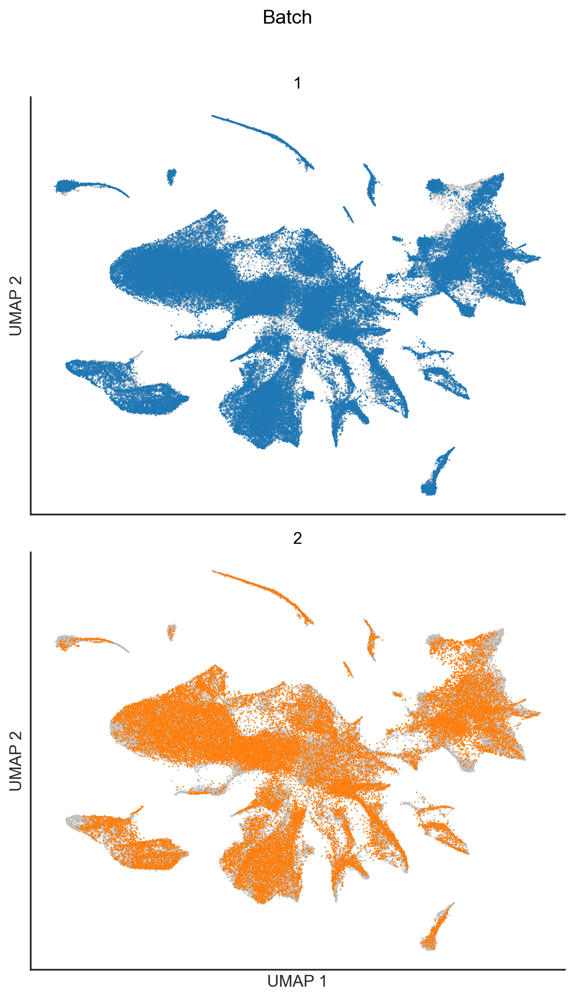

In [146]:
singleCellTools.plotting.PlotAnndata(ad, 'sx').embedding('umap', color='Batch', wrap=1, figsize=(6,10), groupby='Batch', addBackground=True, size=0.4, needLegend=False)[1]

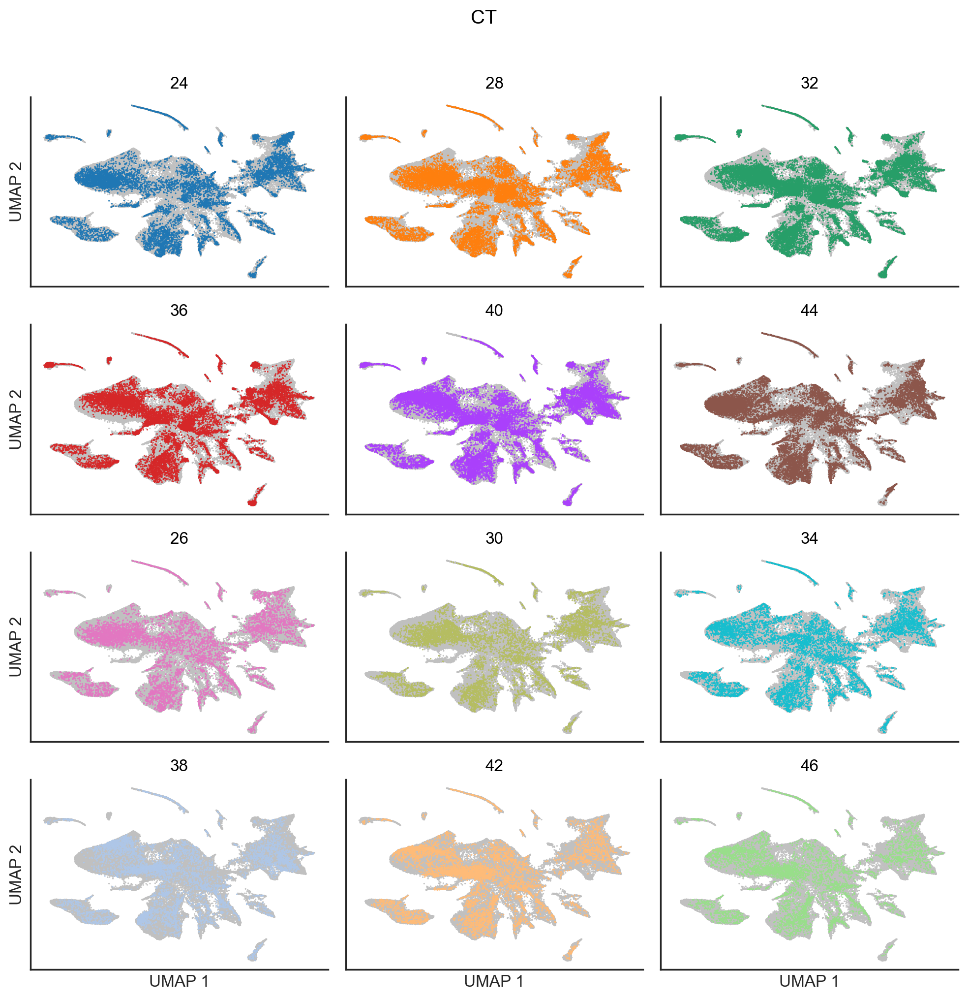

In [148]:
singleCellTools.plotting.PlotAnndata(ad, 'sx').embedding('umap', color='CT_batchOrder', title='CT', wrap=3, figsize=(10,10), groupby='CT_batchOrder', addBackground=True, size=0.4, needLegend=False)[1]

In [57]:
%store -r _df

In [59]:
ad.obs["prev_celltype"] = _df["celltype"]

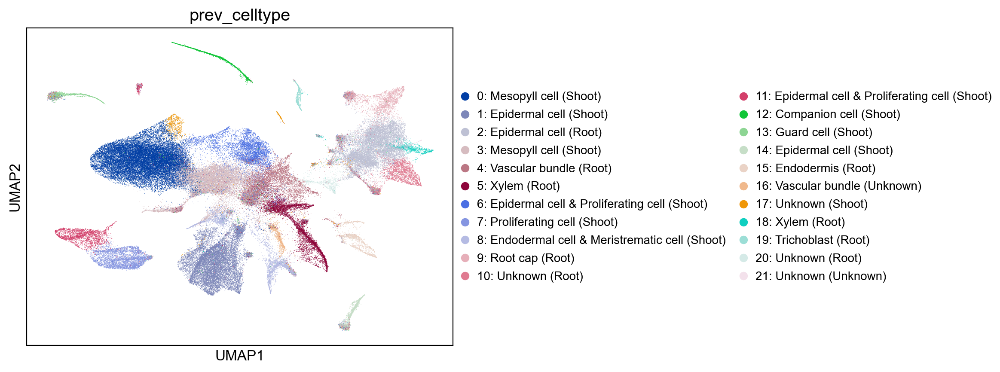

In [60]:
sc.pl.umap(ad, color="prev_celltype")

([<matplotlib.collections.PathCollection at 0x2ade58d99250>,
 ['24', '26', '28', '30', '32', '34', '36', '38', '40', '42', '44', '46'])

In [518]:
import legendkit

In [ ]:
plt.legend()

<ListLegend>

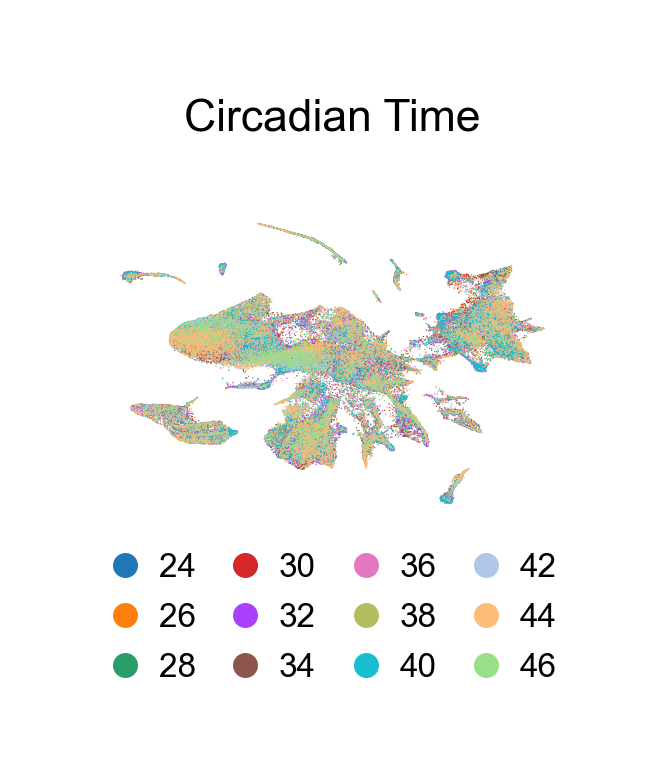

In [527]:
fig, ax = plt.subplots(figsize=(3,2))
sc.pl.umap(ad, color="CT", show=False, ax=ax)
sns.despine(top=True, right=True, left=True, bottom=True)
plt.xlabel('')
plt.ylabel('')
plt.title('Circadian Time', y =1.2, fontsize=16)
h, l = ax.get_legend_handles_labels()
ax.get_legend().remove()
legendkit.legend(ax=ax, handles=h, labels=l, loc='out lower center', frameon=False, ncol=4, prop={'size': 12}, markerscale=3)


In [61]:
# toPkl(ad, "ad_sct_sx_20230628", "ipf", dir_path=dir_temp)

2023-06-28 21:03:26.645 | INFO     | jpy_tools.otherTools:toPkl:476 - please run `loadPkl('ad_sct_sx_20230628', lambda **dt:sc.read_h5ad(**dt), arg_path='filename')` to get object


In [154]:
ad = loadPkl(
    "ad_sct_sx_20230628",
    lambda **dt: sc.read_h5ad(**dt),
    arg_path="filename",
    dir_path=dir_temp,
)

## harmony sample level

In [160]:
import scanpy.external as sce

In [155]:
ad_test = loadPkl('ad_sct_20230628_after_sct', lambda **dt:sc.read_h5ad(**dt), arg_path='filename', dir_path=dir_temp)

In [158]:
ad_test.obsm["X_pca_30"] = ad_test.obsm["X_pca"][:, :30]

In [161]:
sce.pp.harmony_integrate(ad_test, key="CT", basis="X_pca_30")

2023-11-23 15:09:12,134 - harmonypy - INFO - Iteration 1 of 10
2023-11-23 15:09:12 - INFO - Iteration 1 of 10
2023-11-23 15:10:32,937 - harmonypy - INFO - Iteration 2 of 10
2023-11-23 15:10:32 - INFO - Iteration 2 of 10
2023-11-23 15:11:50,563 - harmonypy - INFO - Iteration 3 of 10
2023-11-23 15:11:50 - INFO - Iteration 3 of 10
2023-11-23 15:13:05,779 - harmonypy - INFO - Iteration 4 of 10
2023-11-23 15:13:05 - INFO - Iteration 4 of 10
2023-11-23 15:14:25,468 - harmonypy - INFO - Iteration 5 of 10
2023-11-23 15:14:25 - INFO - Iteration 5 of 10
2023-11-23 15:15:40,436 - harmonypy - INFO - Iteration 6 of 10
2023-11-23 15:15:40 - INFO - Iteration 6 of 10
2023-11-23 15:16:53,594 - harmonypy - INFO - Iteration 7 of 10
2023-11-23 15:16:53 - INFO - Iteration 7 of 10
2023-11-23 15:18:17,531 - harmonypy - INFO - Iteration 8 of 10
2023-11-23 15:18:17 - INFO - Iteration 8 of 10
2023-11-23 15:19:09,029 - harmonypy - INFO - Iteration 9 of 10
2023-11-23 15:19:09 - INFO - Iteration 9 of 10
2023-11-23

In [162]:
sc.pp.neighbors(ad_test, use_rep="X_pca_harmony")

In [163]:
sc.tl.umap(ad_test, 0.3)

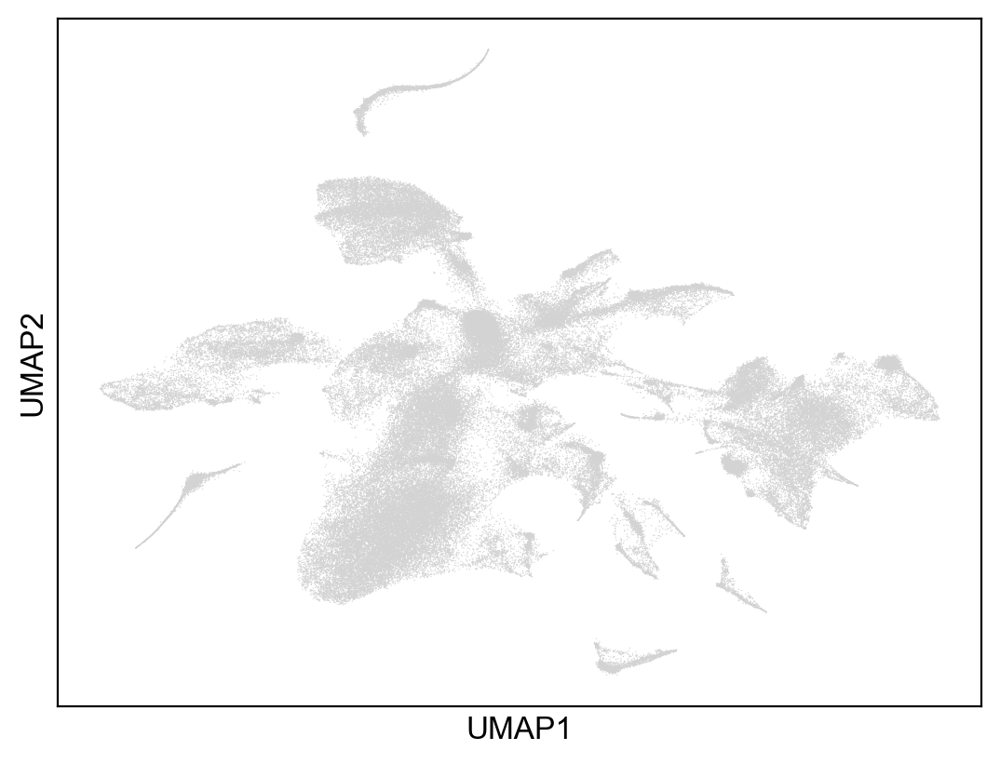

In [164]:
sc.pl.umap(ad_test)

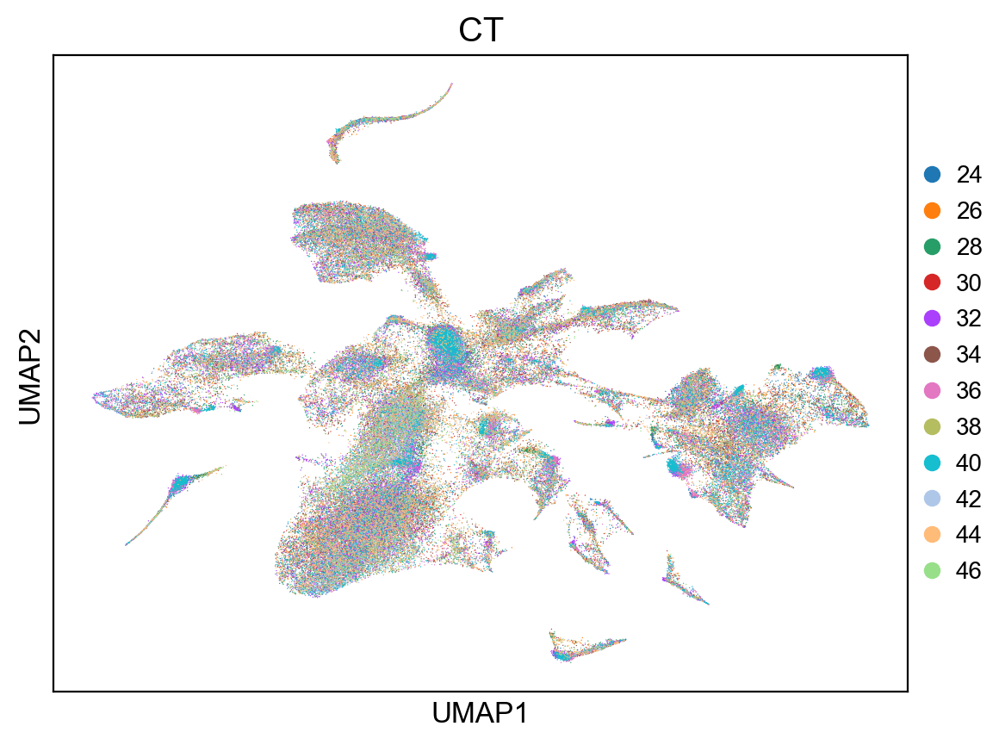

In [165]:
sc.pl.umap(ad_test, color="CT")

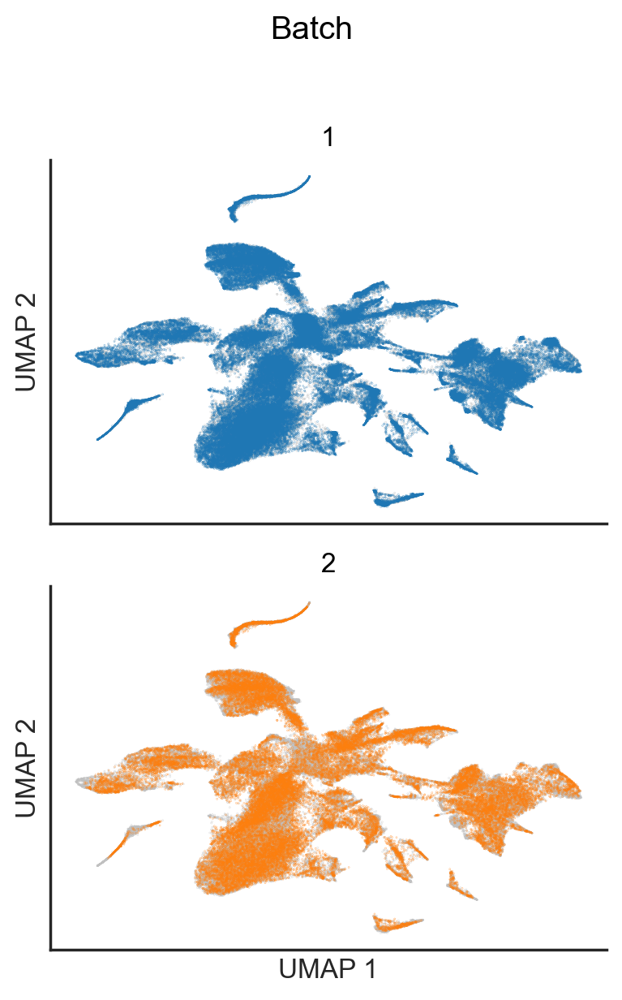

In [166]:
singleCellTools.plotting.PlotAnndata(ad_test, 'sx').embedding('umap', color='Batch', wrap=1, figsize=(4,6), groupby='Batch', addBackground=True, size=0.1, needLegend=False)[1]

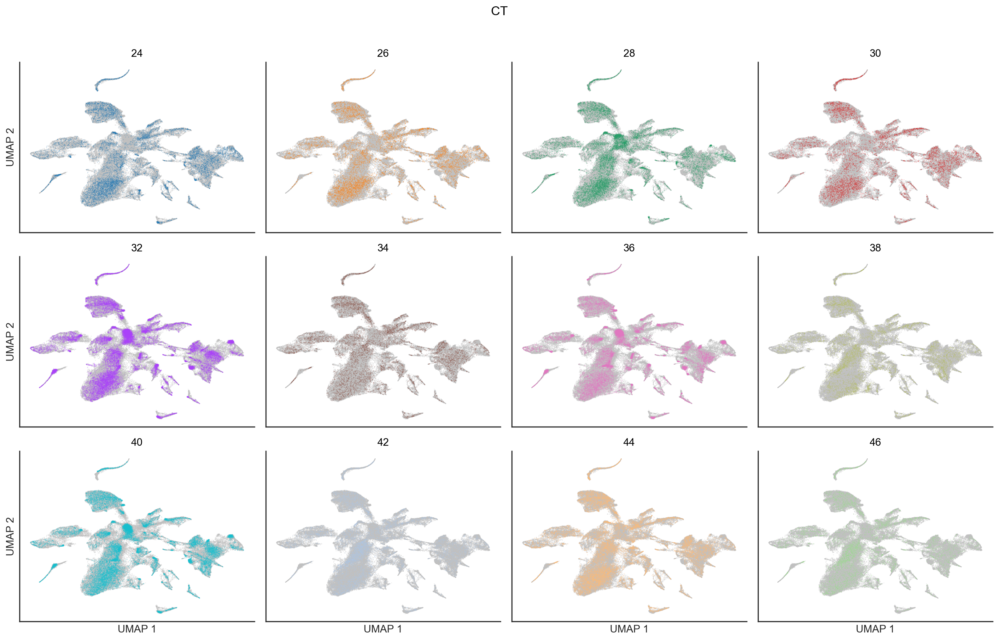

In [167]:
singleCellTools.plotting.PlotAnndata(ad_test, 'sx').embedding('umap', color='CT', wrap=4, figsize=(16,10), groupby='CT', addBackground=True, size=0.1, needLegend=False)[1]

In [168]:
ad.obsm['X_pca_sct_sample_harmony_sample'] = ad_test.obsm['X_pca_harmony']

# get reasonable clusters res

In [87]:
import tqdm
import sklearn

In [83]:
for res in tqdm.tqdm(np.linspace(0.05, 1.5, 30)):
    res = round(res, 2)
    sc.tl.leiden(ad, resolution=res, key_added=f"leiden_{res}")

100%|██████████| 30/30 [35:47<00:00, 71.59s/it]


In [123]:
ad_forSi = sc.pp.subsample(ad, n_obs=10000, copy=True)

In [136]:
ar_distance = sklearn.metrics.pairwise_distances(ad_forSi.obsm["X_pca_harmony_sx"])

In [137]:
ls_res = [round(res, 2) for res in np.linspace(0.05, 1.5, 30)]

In [138]:
dt_silhouScore = {}
for res in tqdm.tqdm(ls_res):
    dt_silhouScore[res] = sklearn.metrics.silhouette_score(
        ar_distance, ad_forSi.obs[f"leiden_{res}"], metric="precomputed"
    )
del ar_distance

  0%|          | 0/30 [00:00<?, ?it/s]

100%|██████████| 30/30 [00:15<00:00,  1.94it/s]


In [139]:
ad.uns["leiden_silhouScore"] = pd.Series(dt_silhouScore).rename("ss").to_frame()

In [140]:
dt_silhouScore = ad.uns["leiden_silhouScore"]["ss"].to_dict()

In [121]:
sc.tl.leiden(ad, resolution=0.4)

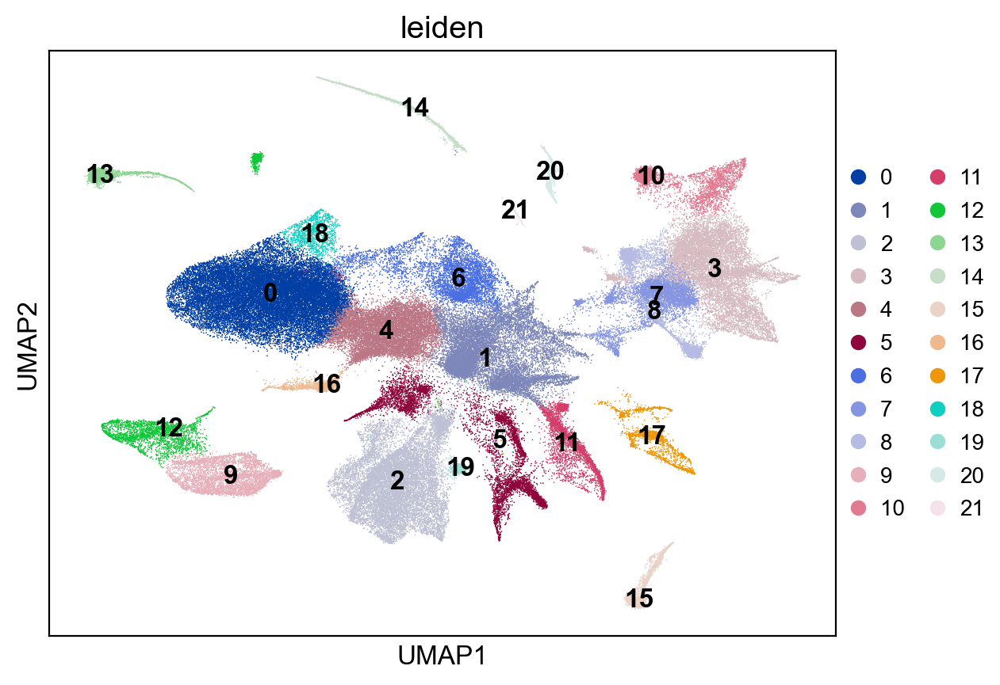

In [142]:
ax = sc.pl.umap(ad, color="leiden", legend_loc="on data", show=False)
sc.pl.umap(
    ad,
    color="leiden",
    ax=ax,
)

In [143]:
_ = singleCellTools.plotting.plotClusterSankey(
    ad, ["prev_celltype", "leiden"], figsize=[10, 12]
)
_.render_notebook()

<Axes: xlabel='Leiden', ylabel='Percentage'>

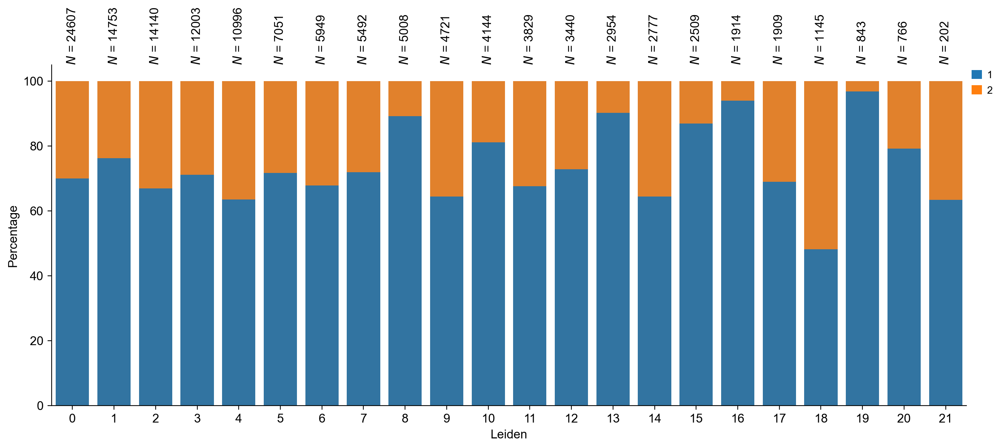

In [155]:
fig, ax = plt.subplots(figsize=(16, 6))
singleCellTools.plotting.plotLabelPercentageInCluster(ad, "leiden", "Batch", ax=ax)

In [ ]:
fig, ax = plt.subplots(figsize=(12, 6))
singleCellTools.plotting.plotLabelPercentageInCluster(ad, "leiden", "CT", ax=ax)

In [17]:
ad.obs["Cluster"] = ad.obs["leiden"]

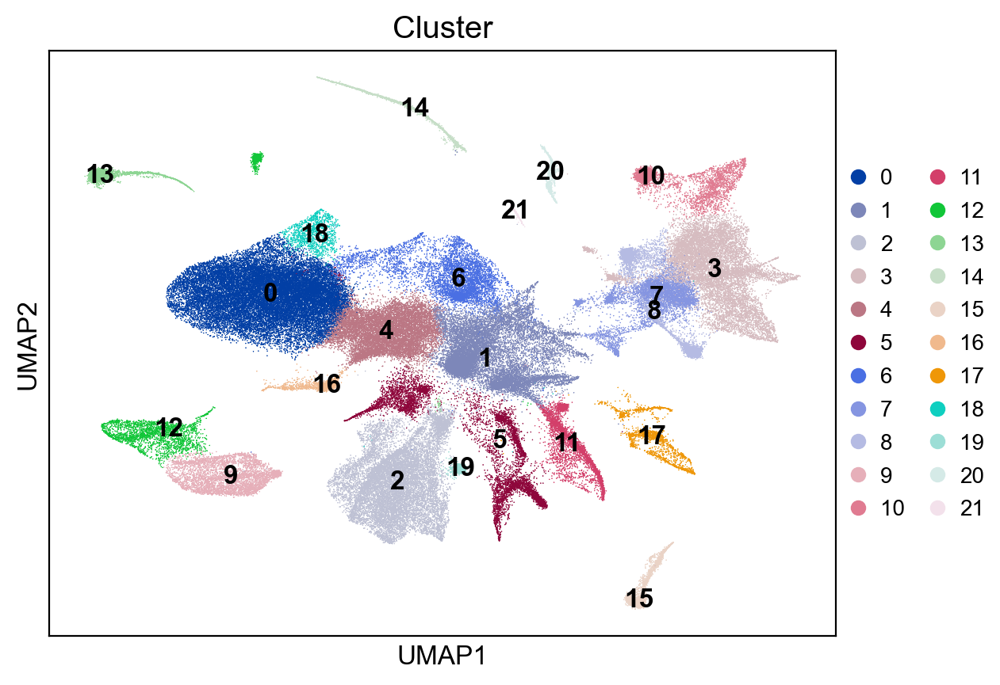

In [18]:
ax = sc.pl.umap(ad, color="Cluster", show=False, legend_loc="on data")
sc.pl.umap(ad, color="Cluster", ax=ax)

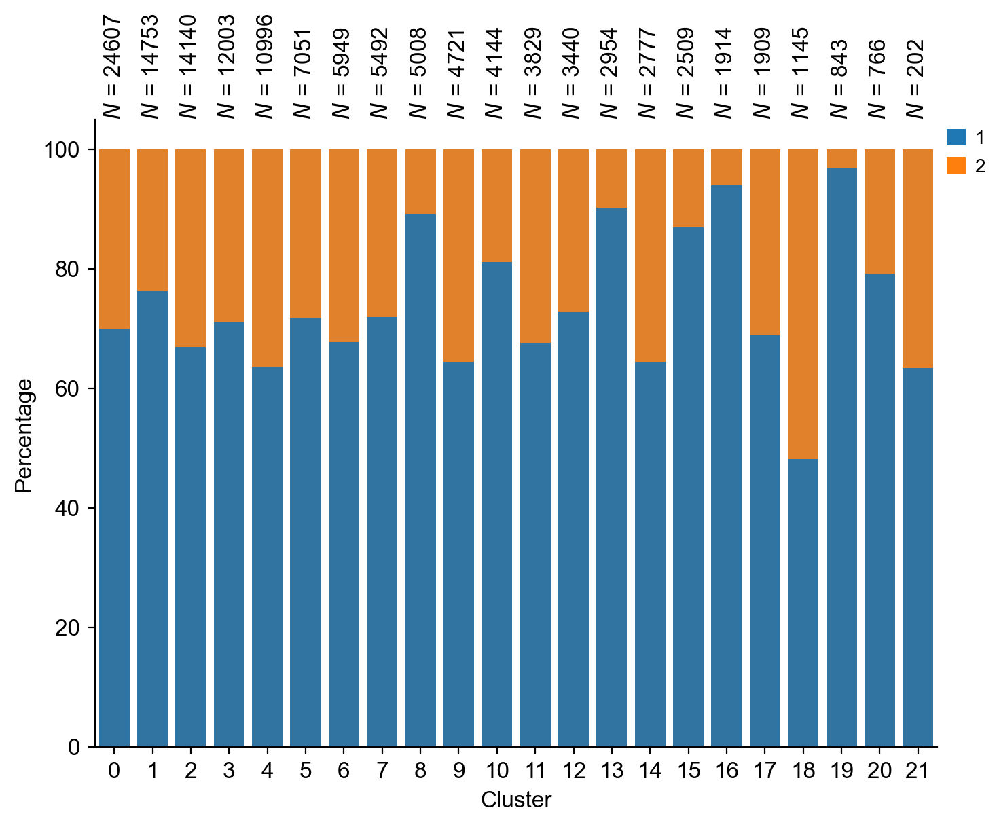

In [20]:
fig, ax = plt.subplots(figsize=(8, 6))
singleCellTools.plotting.plotLabelPercentageInCluster(ad, "Cluster", "Batch", ax=ax)
plt.show()

# get spec gene of each cluster

In [21]:
singleCellTools.geneEnrichInfo.calculateEnrichScoreByCellex(ad, "raw", "Cluster")

In [22]:
toPkl(ad, "ad_sct_sx_20230628", "ipf", dir_path=dir_temp)

2023-06-28 21:26:11.245 | INFO     | jpy_tools.otherTools:toPkl:476 - please run `loadPkl('ad_sct_sx_20230628', lambda **dt:sc.read_h5ad(**dt), arg_path='filename')` to get object


In [13]:
ad = loadPkl('ad_20230506_after_sct', lambda **dt:sc.read_h5ad(**dt), arg_path='filename', dir_path=dir_temp)

In [23]:
ls_cluster = ad.uns["Cluster_cellexES"]["Cluster"].unique().tolist() >> F(
    sorted, key=lambda x: int(x.split("-")[0])
)

In [24]:
ad.uns["Cluster_cellexES"]["Cluster"] = (
    ad.uns["Cluster_cellexES"]["Cluster"]
    .astype("category")
    .cat.set_categories(ls_cluster)
)

In [25]:
def _cutSpecGenes(df, cutoff):
    df = df.query("enrichScore > @cutoff")
    return df.value_counts("Cluster", sort=False).rename(cutoff)


pd.concat(
    [
        _cutSpecGenes(ad.uns["Cluster_cellexES"], x)
        for x in (0.8, 0.85, 0.9, 0.95, 0.98, 0.99)
    ],
    axis=1,
)

,0.80,0.85,0.90,0.95,0.98,0.99
Cluster,,,,,,
0,799,535,297,80,13,2
1,465,341,211,75,10,1
2,613,429,278,110,19,2
3,817,545,273,79,10,0
4,456,312,174,70,29,12
5,320,243,149,67,14,2
6,353,284,206,112,43,13
7,595,402,235,98,13,1
8,35,21,14,3,0,0


In [57]:
dt_specGenes = (
    ad.uns["Cluster_cellexES"]
    .query("enrichScore > 0.9")
    .sort_values(["Cluster", "enrichScore"], ascending=[True, False])
    .groupby("Cluster")["gene"]
    .agg(list)
    .to_dict()
)

In [342]:
_df = ad.uns["Cluster_cellexES"].query("enrichScore > 0.9").sort_values(["Cluster", "enrichScore"], ascending=[True, False])

In [344]:
_df.to_csv(f"{dir_result}/20230825_spec_genes.csv")

In [345]:
f"{dir_result}/20230825_spec_genes.csv"

'/data/Zhaijx/liuzj/projects/circadian/03_analysis//20230825_spec_genes.csv'

In [581]:
{x:len(y) for x,y in dt_specGenes.items()}

{'0': 297,
 '1': 211,
 '2': 278,
 '3': 273,
 '4': 174,
 '5': 149,
 '6': 206,
 '7': 235,
 '8': 14,
 '9': 268,
 '10': 152,
 '11': 199,
 '12': 160,
 '13': 88,
 '14': 193,
 '15': 94,
 '16': 15,
 '17': 196,
 '18': 189,
 '19': 25,
 '20': 218,
 '21': 118}

In [63]:
dt_geneSetCounts = {x:len(y) for x,y in dt_specGenes.items()}
ls_cluster = dt_specGenes.keys()
ls_genes = sum([dt_specGenes[x] for x in ls_cluster], [])
ls_geneCategory = [[x] * dt_geneSetCounts[x] for x in ls_cluster] >> F(lambda _: sum(_, []))
# _ad = sc.pp.subsample(ad, n_obs=10000, copy=True)
_ad = ad

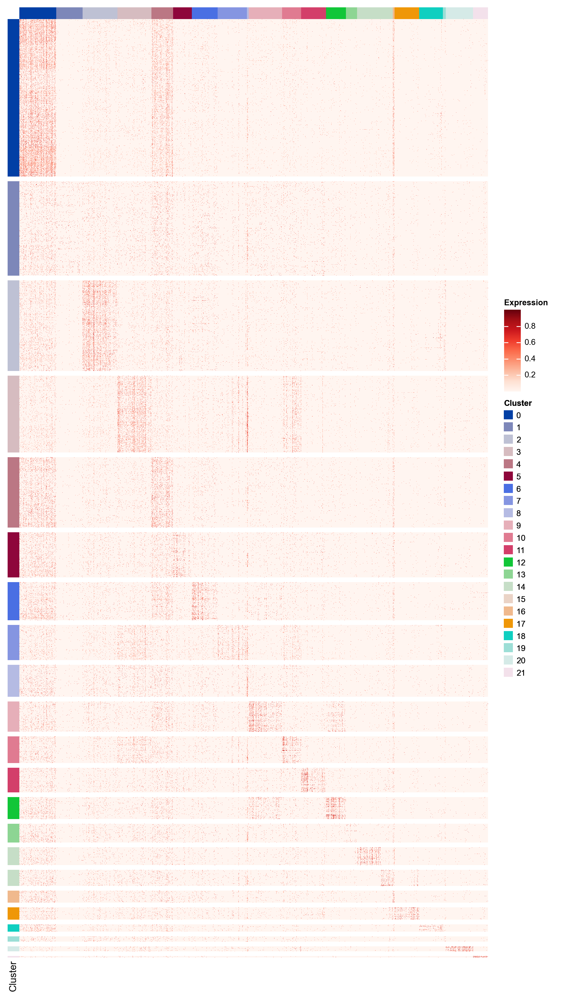

In [64]:

df_mtx = _ad[:, ls_genes].to_df('normalize_log')
df_mtx = df_mtx.pipe(lambda _: (_ - _.min(0)) / (_.max(0) - _.min(0))).fillna(0)
m = ma.Heatmap(df_mtx.values, cmap='Reds', width=8, height=16, label='Expression')
m.hsplit(labels=_ad.obs['Cluster'], order=_ad.obs['Cluster'].cat.categories, spacing=0.005)
m.add_left(mp.Colors(data=_ad.obs['Cluster'], palette=singleCellTools.basic.getadataColor(_ad, 'Cluster'), label='Cluster'), size=0.2)
m.add_top(mp.Colors(data=ls_geneCategory, palette=singleCellTools.basic.getadataColor(_ad, 'Cluster')), size=0.2, legend=False)
m.add_legends()
m.render()

# Call marker for each circadian time

In [652]:
ad.uns['leiden_subcluster_cellexES']

,gene,leiden_subcluster,enrichScore,expressed_ratio,expressed_ratio_others,det_pvals,det_esw_s,ep_pvals,ep_esw_s,ges_pvals,ges_esw_s,nsi_pvals,nsi_esw_s,significantCounts
0,AT1G01010,0,0.000000,0.015036,0.024957,1.000000,0.000000,0.995146,0.000000,0.996666,0.000000,0.975336,0.000000,0.0
1,AT1G01020,0,0.011383,0.093144,0.076550,0.072619,0.000000,0.914926,0.000000,0.034226,0.045534,0.418849,0.000000,1.0
2,AT1G01030,0,0.715670,0.076807,0.029077,0.000539,0.739105,0.005001,0.645823,0.000049,0.875720,0.003923,0.602031,4.0
3,AT1G01040,0,0.223642,0.267322,0.197766,0.001912,0.597662,0.676866,0.000000,0.006620,0.296906,0.139110,0.000000,2.0
4,AT1G03993,0,0.000000,0.000325,0.000300,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
588067,AT5G67600,9,0.000000,0.016734,0.021506,0.978523,0.000000,0.956997,0.000000,0.926988,0.000000,0.702707,0.000000,0.0
588068,AT5G67610,9,0.000000,0.034315,0.031377,0.054085,0.000000,0.085564,0.000000,0.124939,0.000000,0.242522,0.000000,0.0
588069,AT5G67620,9,0.000000,0.004660,0.013043,1.000000,0.000000,0.976611,0.000000,0.982005,0.000000,0.915760,0.000000,0.0
588070,AT5G67630,9,0.004373,0.026266,0.023072,0.043199,0.017491,0.121751,0.000000,0.083946,0.000000,0.336030,0.000000,1.0


In [653]:
_dt = {}
for ct, _ad in singleCellTools.basic.splitAdata(ad, 'CT', needName=True):
    singleCellTools.geneEnrichInfo.calculateEnrichScoreByCellex(_ad, 'raw', 'leiden_subcluster')
    _dt[ct] = _ad.uns['leiden_subcluster_cellexES'].copy()

  0%|          | 0/12 [00:00<?, ?it/s]

100%|██████████| 12/12 [54:07<00:00, 270.60s/it]


In [658]:
for ct in _dt.keys():
    _dt[ct] = _dt[ct].assign(ct=ct)

In [665]:
df_cellexScoreForEachCt = pd.concat(_dt.values())

In [717]:
def sMod(N, m, n1, n2):
    import math

    p = 0
    denominator = math.comb(N, n1) * math.comb(N, n2)
    for i in range(m, min(n1, n2) + 1):
        numerator = (
            math.comb(N, i) * math.comb(N - i, n1 - i) * math.comb(N - n1, n2 - i)
        )
        p += numerator / denominator
    return p

def sModForSpec(df_spec, compareKey):
    from itertools import product
    from joblib import Parallel, delayed
    from tqdm import tqdm

    df_smod = pd.DataFrame(
        index=df_spec[compareKey].unique(), columns=df_spec[compareKey].unique()
    )
    df_smod = df_smod.melt(ignore_index=False).reset_index()
    df_smod.columns = ["compareA", "compareB", "sMod_p"]

    N = len(df_spec["gene"].unique())

    for tp_line in tqdm(df_smod.itertuples(), total=df_smod.shape[0]):
        x = tp_line.compareA
        y = tp_line.compareB
        m = len(
            set(df_spec.query(f"{compareKey} == @x")["gene"])
            & set(df_spec.query(f"{compareKey} == @y")["gene"])
        )
        n = len(
            set(df_spec.query(f"{compareKey} == @x")["gene"])
            | set(df_spec.query(f"{compareKey} == @y")["gene"])
        )
        n1 = len(df_spec.query(f"{compareKey} == @x")["gene"].unique())
        n2 = len(df_spec.query(f"{compareKey} == @y")["gene"].unique())
        df_smod.loc[tp_line.Index, "N"] = N
        df_smod.loc[tp_line.Index, "m"] = m
        df_smod.loc[tp_line.Index, "n1"] = n1
        df_smod.loc[tp_line.Index, "n2"] = n2
        df_smod.loc[tp_line.Index, "n"] = n
    df_smod["N"] = df_smod["N"].astype(int)
    df_smod["m"] = df_smod["m"].astype(int)
    df_smod["n1"] = df_smod["n1"].astype(int)
    df_smod["n2"] = df_smod["n2"].astype(int)

    ls_modP = Parallel(n_jobs=64)(
        delayed(sMod)(N, m, n1, n2)
        for (N, m, n1, n2) in df_smod[["N", "m", "n1", "n2"]].itertuples(index=False)
    )
    df_smod["sMod_p"] = ls_modP
    df_smod.loc[df_smod["compareA"] == df_smod["compareB"], "sMod_p"] = np.nan
    df_smod["sMod"] = -np.log10(df_smod["sMod_p"])
    df_smod['jacIndex'] = df_smod['m'] / df_smod['n']
    df_smod.loc[df_smod["compareA"] == df_smod["compareB"], "jacIndex"] = np.nan

    return df_smod

In [786]:
def plotSmodRes(df_sMod, vmax, height=5, width=5, sizes=[0, 0.1, 0.2, 0.3]):
    _df_jacIndex = df_sMod.pivot_table(index='compareA', columns='compareB', values='jacIndex')
    _df_sModP = df_sMod.pivot_table(index='compareA', columns='compareB', values='sMod_p')
    _df_sMod = df_sMod.pivot_table(index='compareA', columns='compareB', values='sMod')
    
    ls_ct = _df_sMod.index

    h = ma.Heatmap(_df_sMod.values, cmap='Reds', label='S-MOD', height=height, width=width, linewidth=1, vmax=vmax)
    _sr = _df_jacIndex.fillna(0).values.reshape(-1)

    h.add_layer(
        mp.SizedMesh(
            _df_jacIndex.fillna(0).values, color="none", edgecolor="#6E75A4", 
            size_legend_kws=dict(
                title='Jaccard Index', 
                show_at=np.interp(sizes, [_sr.min(), _sr.max()], [0,1]), 
                spacing='uniform'
            )
        )
    )
    h.add_left(mp.Colors(ls_ct, label='Circadian Time'), size=0.2, pad=0.05)

    h.add_top(mp.Colors(ls_ct, label='Circadian Time'), size=0.2, pad=0.05, legend=False)

    h.add_legends(stack_size=4)

    return h

In [787]:
def plotJacRes(df_sMod, vmax, height=5, width=5):
    _df_jacIndex = df_sMod.pivot_table(index='compareA', columns='compareB', values='jacIndex')
    _df_sModP = df_sMod.pivot_table(index='compareA', columns='compareB', values='sMod_p')
    _df_sMod = df_sMod.pivot_table(index='compareA', columns='compareB', values='sMod')
    
    ls_ct = _df_sMod.index

    h = ma.Heatmap(_df_jacIndex.values, cmap='Reds', label='Jaccard Index', height=height, width=width, linewidth=1, vmax=vmax, annot=True, fmt=lambda _: round(_,2))
    _sr = _df_jacIndex.fillna(0).values.reshape(-1)

    h.add_left(mp.Colors(ls_ct, label='Circadian Time'), size=0.2, pad=0.05)

    h.add_top(mp.Colors(ls_ct, label='Circadian Time'), size=0.2, pad=0.05, legend=False)

    h.add_legends(stack_size=4)

    return h

In [971]:
class OverlapBetweenCircadianTime(object):
    def __init__(self, df_cellexScoreForEachCt, enrichScoreCutoff, label):
        self.rawData = df_cellexScoreForEachCt
        self.data = df_cellexScoreForEachCt.assign(spec=lambda _: np.where(_.enrichScore>enrichScoreCutoff, True, False)).query("spec")
        self.enrichScoreCutoff = enrichScoreCutoff
        self.label = label
    def onlyKeepSpecGenes(self):
        _ls = self.rawData.query("enrichScore > @self.enrichScoreCutoff")['gene'].unique()
        self.rawData = self.rawData.query("gene in @_ls")
    def getIccValue(self):
        import pingouin as pg
        icc = pg.intraclass_corr(data=self.rawData, targets='gene', raters='ct',
                                ratings='enrichScore')
        self.icc = icc
    def getSmodAndJacIndex(self):
        self.sMod = sModForSpec(self.data, 'ct')

    def plotSmodRes(self, vmax, height=5, width=5, sizes=[0, 0.1, 0.2, 0.3]):
        return plotSmodRes(self.sMod, vmax, height, width, sizes=sizes)
    
    def plotJacRes(self, vmax=1, height=5, width=5):
        return plotJacRes(self.sMod, vmax, height, width)
    
    def plotSpecGeneCounts(self):
        _df = self.data.value_counts("gene").value_counts().to_frame().reset_index().rename(columns={'index':'geneCounts', 0:'ctCounts'}).sort_values('geneCounts')
        g = (
            so.Plot(_df, x='geneCounts', y='ctCounts', text='ctCounts')
            .add(so.Bar())
            .add(so.Text(valign='bottom'))
            .label(title=self.label)
            .scale(x=so.Continuous().tick(every=1))
        )
        fig = g.plot()._figure
        ax = fig.axes[0]
        for text in ax.texts:
            text.set(clip_on=False)
        return fig

## overlap

In [972]:
ls_allSubcluster = df_cellexScoreForEachCt['leiden_subcluster'].unique()

In [974]:
from tqdm import tqdm
dt_specOverlapInfo = {}
for cluster in tqdm(ls_allSubcluster):
    df_forIcc = df_cellexScoreForEachCt.query("leiden_subcluster == @cluster")
    overlapSpec = OverlapBetweenCircadianTime(df_forIcc, 0.8, f'Cluster {cluster}')
    overlapSpec.onlyKeepSpecGenes()
    overlapSpec.getIccValue()
    overlapSpec.getSmodAndJacIndex()
    dt_specOverlapInfo[cluster] = overlapSpec

100%|██████████| 24/24 [03:26<00:00,  8.61s/it]


In [975]:
dt_icc = {}
for cluster, overlapSpec in tqdm(dt_specOverlapInfo.items()):
    pval = overlapSpec.icc.set_index("Type").loc['ICC2', 'pval']
    if pval < 0.05:
        dt_icc[cluster] = overlapSpec.icc.set_index("Type").loc['ICC2', 'ICC']
    else:
        dt_icc[cluster] = 0.0
dt_icc = {x:dt_icc[x] for x in sorted(dt_icc.keys(), key=lambda _: int(_.split(',')[0]))}

100%|██████████| 24/24 [00:00<00:00, 760.46it/s]


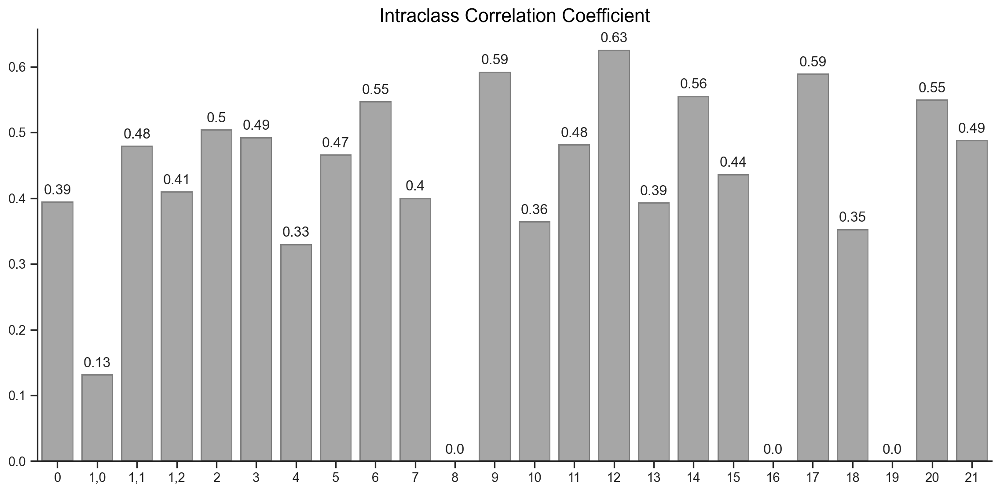

In [976]:
(
    so.Plot(x=dt_icc.keys(), y=dt_icc.values(), text=list(dt_icc.values()) >> F(map, partial(round, ndigits=2)) >> F(list))
    .add(so.Bar())
    .add(so.Text(valign="bottom"))
    .layout(size=(12,6))
    .label(title='Intraclass Correlation Coefficient')
    .theme({'axes.titlesize':16})
)

In [977]:
from IPython import display

In [ ]:
for cluster, overlapSpec in tqdm(dt_specOverlapInfo.items()):
    h = overlapSpec.plotSmodRes(None, sizes=[0,0.2,0.4])
    h.add_top(
        mp.Title(overlapSpec.label)
    )
    h.add_legends(stack_size=2)
    display.display(h.render())

In [986]:
from jpy_tools.otherTools import FigConcate

In [1000]:
lsFig = []
dtFig = {}
for cluster, overlapSpec in tqdm(dt_specOverlapInfo.items()):
    h = overlapSpec.plotSmodRes(None, sizes=[0,0.2,0.4])
    h.add_top(
        mp.Title(overlapSpec.label)
    )
    h.add_legends(stack_size=2)
    fig, ax = plt.subplots()
    ax.remove()
    h.render(fig)
    plt.close()
    lsFig.append(FigConcate(fig))
    dtFig[cluster] = fig


100%|██████████| 24/24 [00:22<00:00,  1.09it/s]


In [997]:
_ls = []
for i in range(0, len(lsFig), 4):
    _ls.append(reduce(lambda x,y: x|y, lsFig[i:i+8]))

In [998]:
fig = reduce(lambda x,y: x/y, _ls)

In [ ]:
fig.show([20, 15])

In [1006]:
lsFig = []
for cluster, overlapSpec in tqdm(dt_specOverlapInfo.items()):
    fig = overlapSpec.plotSpecGeneCounts()
    lsFig.append(FigConcate(fig))

100%|██████████| 24/24 [00:13<00:00,  1.79it/s]


In [1007]:
_ls = []
for i in range(0, len(lsFig), 4):
    _ls.append(reduce(lambda x,y: x|y, lsFig[i:i+8]))

In [1008]:
fig = reduce(lambda x,y: x/y, _ls)

In [1010]:
fig.show([20, 15])

# annotate

## load public data

In [28]:
ad_pub = sc.read_h5ad(f"{dir_result}/ad_pub_after_calc_sn_auc.h5ad")

## overlap method

In [ ]:
dt_pubSpecGenes = (
    ad_pub.uns["pub_cellex_cellexES"]
    .query("enrichScore > 0.9")
    .sort_values(["celltype", "enrichScore"], ascending=[True, False])
    .groupby("celltype")["gene"]
    .agg(list)
    .to_dict()
)

In [102]:
df_specGeneJarccard = pd.DataFrame(
    index=dt_pubSpecGenes.keys(), columns=dt_specGenes.keys()
)
for k1, v1 in dt_pubSpecGenes.items():
    for k2, v2 in dt_specGenes.items():
        df_specGeneJarccard.loc[k1, k2] = len(set(v1) & set(v2)) / len(
            set(v1) | set(v2)
        )
df_specGeneJarccard = df_specGeneJarccard.astype(float)

In [103]:
ls_geneCat = np.where(df_specGeneJarccard.index.str.contains(":"), "Shoot", "Root")

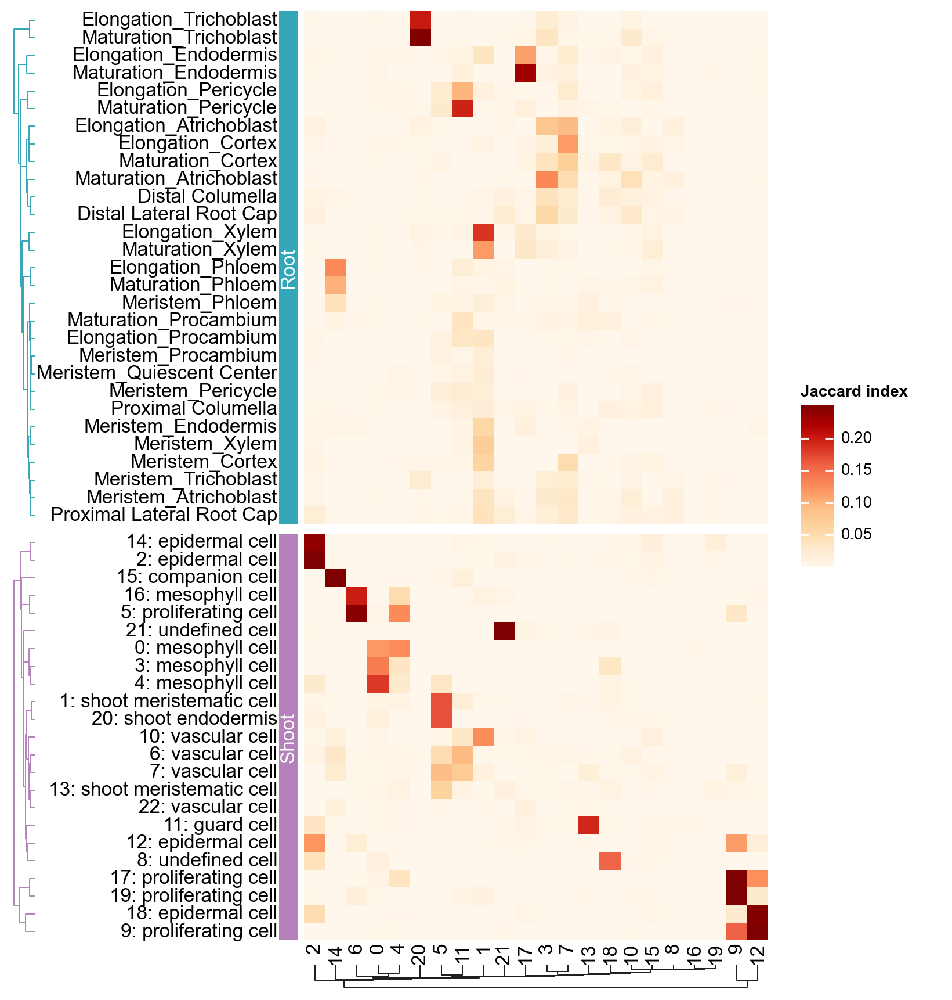

In [217]:
g = ma.Heatmap(
    df_specGeneJarccard.values,
    cmap="OrRd",
    width=4,
    height=8,
    vmax=0.25,
    label="Jaccard index",
)

g.hsplit(labels=ls_geneCat, order=["Root", "Shoot"])

g.add_left(
    ma.plotter.Chunk(
        ["Root", "Shoot"],
        fill_colors=["#33A6B8", "#B481BB"],
        color="white",
        padding=1.2,
    ),
    pad=0.05,
)
g.add_left(mp.Labels(df_specGeneJarccard.index))

g.add_dendrogram(
    "left",
    colors=["#33A6B8", "#B481BB"],
    method="ward",
    metric="euclidean",
    add_meta=False,
    size=0.2,
)
g.add_bottom(mp.Labels(df_specGeneJarccard.columns))
g.add_dendrogram("bottom", method="ward", metric="euclidean", size=0.2)
g.add_legends(pad=-0.5)

g.render()

## AUC method

In [108]:
_dt = {
    x: y >> F(filter, lambda x: x in ad_pub.var.index) >> F(list)
    for x, y in dt_specGenes.items()
}
{x: len(y) for x, y in _dt.items()}

{'0': 287,
 '1': 196,
 '2': 266,
 '3': 212,
 '4': 171,
 '5': 138,
 '6': 206,
 '7': 175,
 '8': 8,
 '9': 250,
 '10': 116,
 '11': 184,
 '12': 149,
 '13': 83,
 '14': 172,
 '15': 70,
 '16': 14,
 '17': 155,
 '18': 169,
 '19': 18,
 '20': 126,
 '21': 100}

In [109]:
singleCellTools.geneEnrichInfo.getAUCellScore(
    ad_pub, _dt, "normalize_log", label="snCircadian_AUC", chunksize=25000
)

Create regulons from a dataframe of enriched features.
Additional columns saved: []


100%|██████████| 3/3 [08:35<00:00, 171.90s/it]


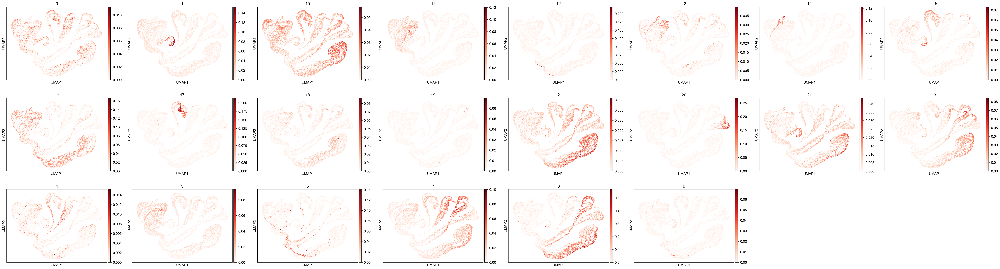

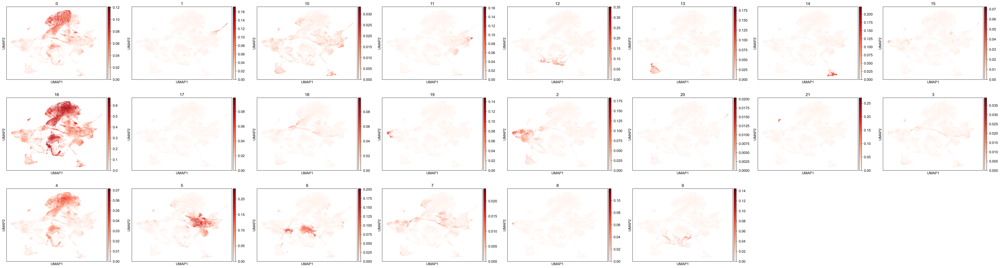

In [110]:
_ad = singleCellTools.plotting.obsmToObs(ad_pub, "snCircadian_AUC")

sc.pl.umap(
    _ad[_ad.obs.eval("tissue == 'Root'")],
    color=_ad.uns["plot_obsm"],
    cmap="Reds",
    ncols=8,
)
sc.pl.umap(
    _ad[_ad.obs.eval("tissue == 'Shoot'")],
    color=_ad.uns["plot_obsm"],
    cmap="Reds",
    ncols=8,
)

In [114]:
_df = ad_pub.obsm["snCircadian_AUC"].groupby(ad_pub.obs["celltype"]).agg("mean")

In [115]:
import scipy

In [116]:
_df = pd.DataFrame(_df >> F(scipy.stats.zscore), index=_df.index, columns=_df.columns)
ls_geneCat = np.where(_df.columns.str.contains(":"), "Shoot", "Root")

In [117]:
ls_geneCat = np.where(_df.index.str.contains(":"), "Shoot", "Root")

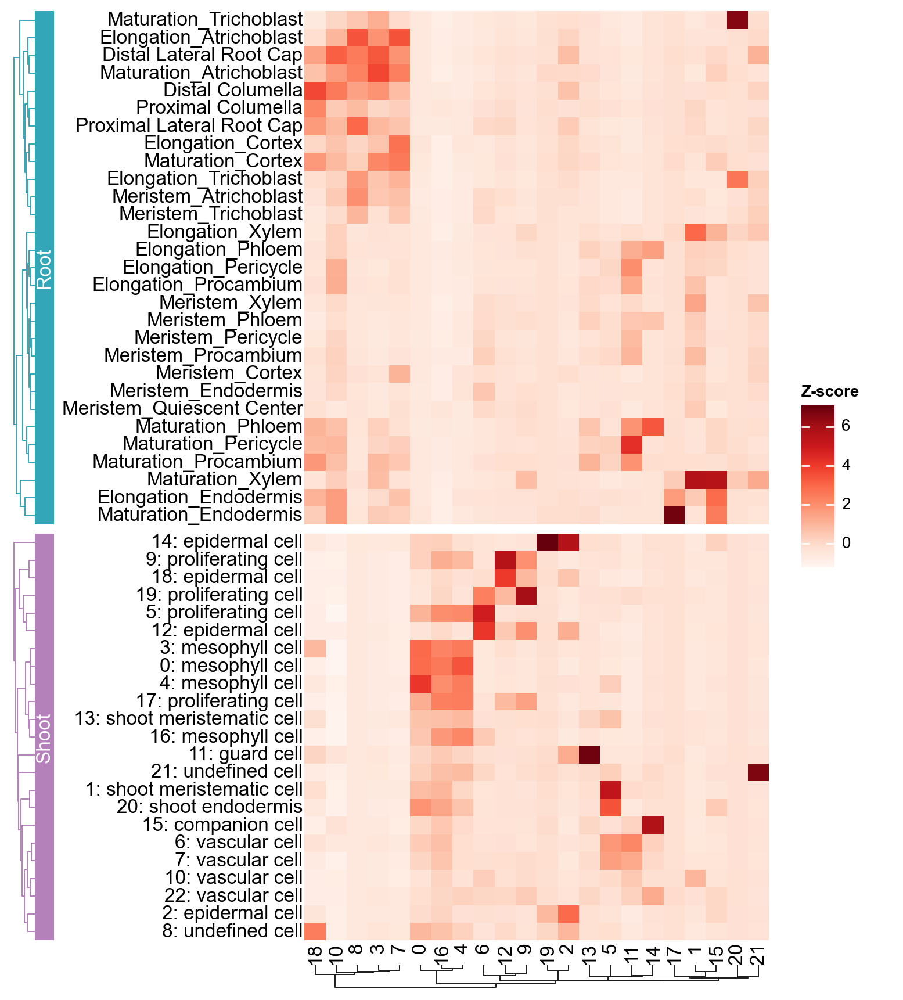

In [120]:
h = ma.Heatmap(_df.values, cmap="Reds", width=4, height=8, label="Z-score")
h.hsplit(labels=ls_geneCat, order=["Root", "Shoot"])

h.add_left(ma.plotter.Labels(_df.index, align="right"))
h.add_bottom(ma.plotter.Labels(_df.columns, align="right"))

h.add_left(
    ma.plotter.Chunk(
        ["Root", "Shoot"],
        fill_colors=["#33A6B8", "#B481BB"],
        color="white",
        padding=1.2,
    ),
    pad=0.05,
)

h.add_dendrogram(
    "left", colors=["#33A6B8", "#B481BB"], method="ward", add_meta=False, size=0.2
)
h.add_dendrogram("bottom", method="ward", size=0.2)
h.add_legends(pad=-0.5)

h.render()

In [245]:
dt_anno = {
    "0": "Mesophyll cell (Shoot)",
    "1": "Vascular cell (Unknown)",
    "2": "Epidermal cell (Shoot)",
    "3": "Atrichoblast (Root)",
    "4": "Proliferating cell & Mesophyll cell (Shoot)",
    "5": "Meristem & Endodermis (Shoot)",
    "6": "Proliferating cell & Mesophyll cell (Shoot)",
    "7": "Cortex (Root)",
    "8": "Unknown (Root)",
    "9": "Proliferating cell (Shoot)",
    "10": "Unknown (Root)",
    "11": "Vascular cell (Unknown)",
    "12": "Proliferating cell & Epidermal cell (Shoot)",
    "13": "Guard cell (Shoot)",
    "14": "Vascular cell (Unknown)",
    "15": "Unknown (Root)",
    "16": "Unknown (Shoot)",
    "17": "Endodermis (Root)",
    "18": "Unknown (Shoot)",
    "19": "Epidermal cell (Shoot)",
    "20": "Trichoblast (Root)",
    "21": "Unknown (Shoot)",
}
dt_anno = {i: f"{i}: {j}" for i, j in dt_anno.items()}
ad.obs["celltype"] = ad.obs["Cluster"].map(dt_anno)

In [148]:
dt_annoForPlot = {}
for k, v in dt_anno.items():
    v = v.split(": ")[1]
    _ls = dt_annoForPlot.get(v, [])
    _ls.append(k)
    dt_annoForPlot[v] = _ls

In [149]:
dt_annoForPlot

{'Mesophyll cell (Shoot)': ['0'],
 'Vascular cell (Unknown)': ['1', '11', '14'],
 'Epidermal cell (Shoot)': ['2', '19'],
 'Atrichoblast (Root)': ['3'],
 'Proliferating cell & Mesophyll cell (Shoot)': ['4', '6'],
 'Meristem & Endodermis (Shoot)': ['5'],
 'Cortex (Root)': ['7'],
 'Unknown (Root)': ['8', '10', '15'],
 'Proliferating cell (Shoot)': ['9'],
 'Proliferating cell & Epidermal cell (Shoot)': ['12'],
 'Guard cell (Shoot)': ['13'],
 'Unknown (Shoot)': ['16', '18', '21'],
 'Endodermis (Root)': ['17'],
 'Trichoblast (Root)': ['20']}

In [150]:
dt_annoForPlot = {
    "Mesophyll cell (Shoot)": ["0"],
    "Guard cell (Shoot)": ["13"],
    "Proliferating cell & Mesophyll cell (Shoot)": ["4", "6"],
    'Proliferating cell & Epidermal cell (Shoot)': ['12'],
    "Proliferating cell (Shoot)": ["9"],
    "Epidermal cell (Shoot)": ["2", "19"],
    "Meristem & Endodermis (Shoot)": ["5"],
    "Unknown (Shoot)": ["16", "18", "21"],
    "Atrichoblast (Root)": ["3"],
    "Trichoblast (Root)": ["20"],
    "Cortex (Root)": ["7"],
    "Endodermis (Root)": ["17"],
    "Unknown (Root)": ["8", "10", "15"],
    "Vascular cell (Unknown)": ["1", "11", "14"],
}

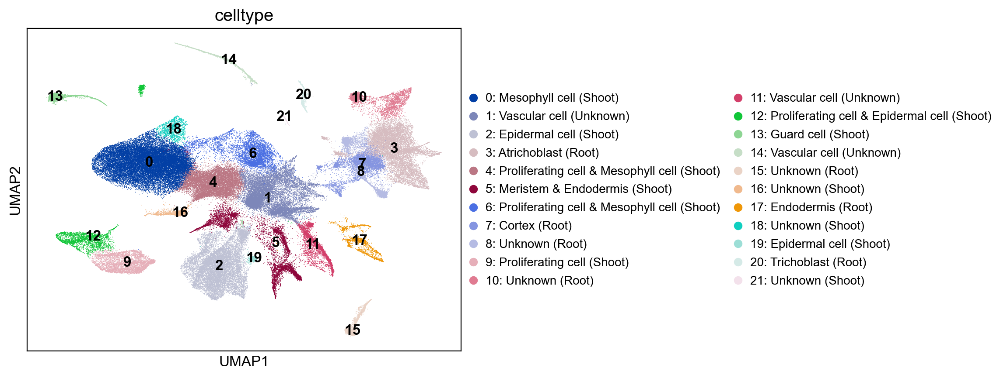

In [151]:
ax = sc.pl.umap(ad, color="Cluster", legend_loc="on data", show=False)
sc.pl.umap(ad, color="celltype", ax=ax)

In [152]:
dt_colors = singleCellTools.basic.getadataColor(ad, "Cluster")

In [153]:
import adjustText

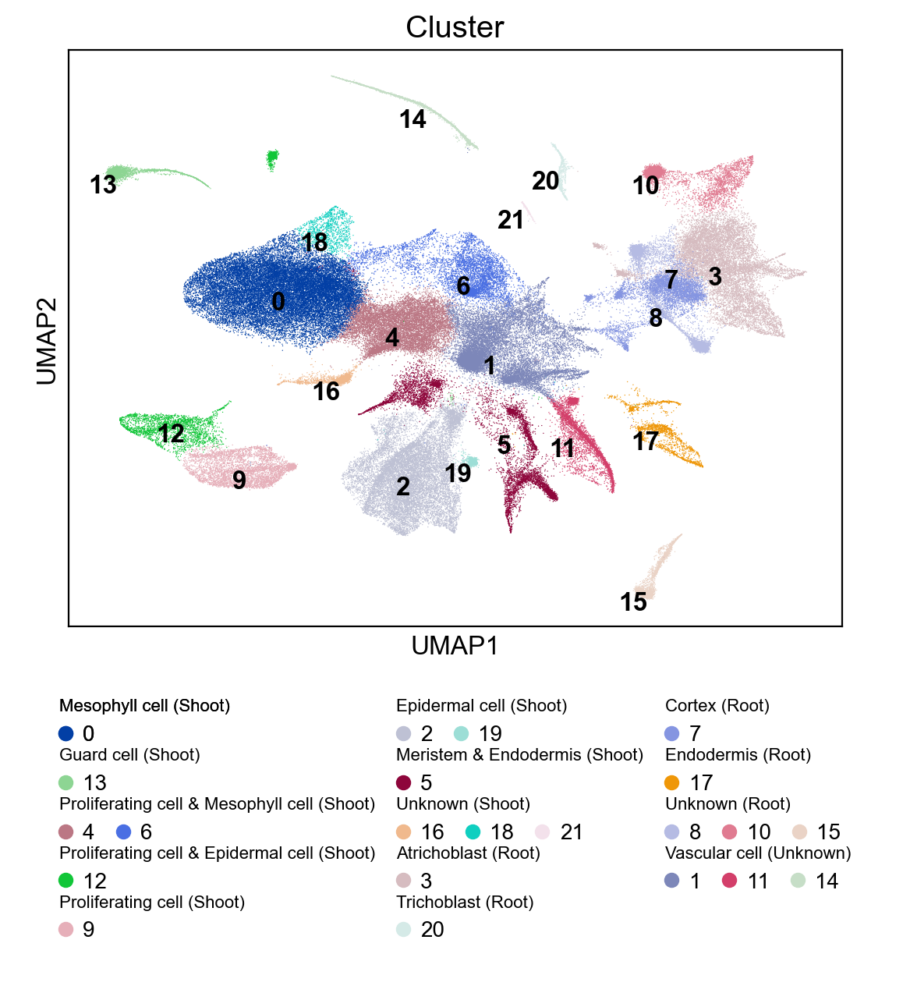

In [154]:
ax = sc.pl.umap(ad, color="Cluster", title="Cluster", legend_loc="on data", show=False)
# sc.pl.umap(ad, color='celltype', title='Cluster', ax=ax, show=False)
# ax.get_legend().remove()

adjustText.adjust_text(ax.texts)
ls_legends = []
for celltype, ls_clusters in dt_annoForPlot.items():
    # ls_legendArgs = [('circle', x, dict(color=dt_colors[x])) for x in ls_clusters]
    # ls_legendArgs = [
    #     ('circle', x, dict(color=dt_colors[x])) for x in ls_clusters
    # ]
    ls_legends.append(
        legendkit.cat_legend(
            colors=[dt_colors[x] for x in ls_clusters],
            labels=ls_clusters,
            size=0.6,
            handle="circle",
            title=celltype,
            ncol=len(ls_clusters),
            title_fontproperties={"size": 8},
        )
    )

    # ls_legends.append(legendkit.cat_legend(legend_items=ls_legendArgs, title=celltype, ncol=len(ls_clusters)))
ls_meteLegends = []
j = 0
for i in [5, 5, 5]:
    ls_meteLegends.append(
        legendkit.vstack(ls_legends[j : i + j], spacing=1, padding=-1)
    )
    j += i

legendkit.hstack(
    ls_meteLegends, loc="out lower center", spacing=10, frameon=False, ax=ax
)

# PCA

In [346]:
ad_merge.X = ad_merge.layers['normalize_log'].copy()

In [347]:
sc.tl.pca(ad_merge, use_highly_variable=False)

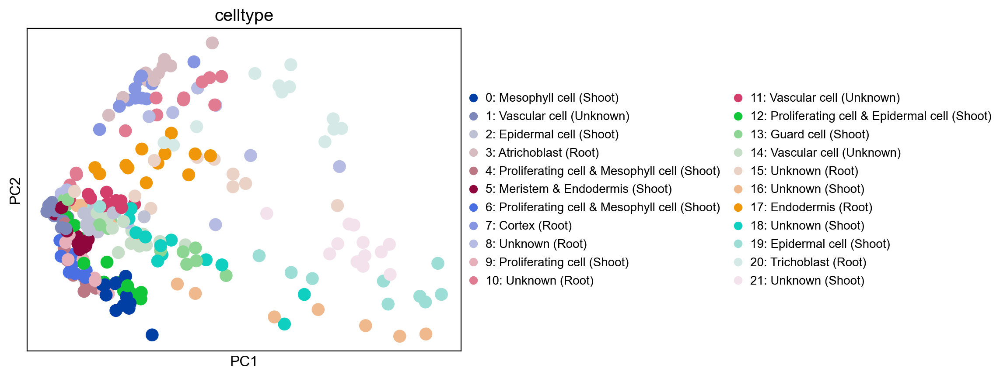

In [348]:
sc.pl.pca(ad_merge, color='celltype')

In [389]:
ad_merge.obs['CT'] = ad_merge.obs['CT'].astype(int)

  0%|          | 0/22 [00:00<?, ?it/s]

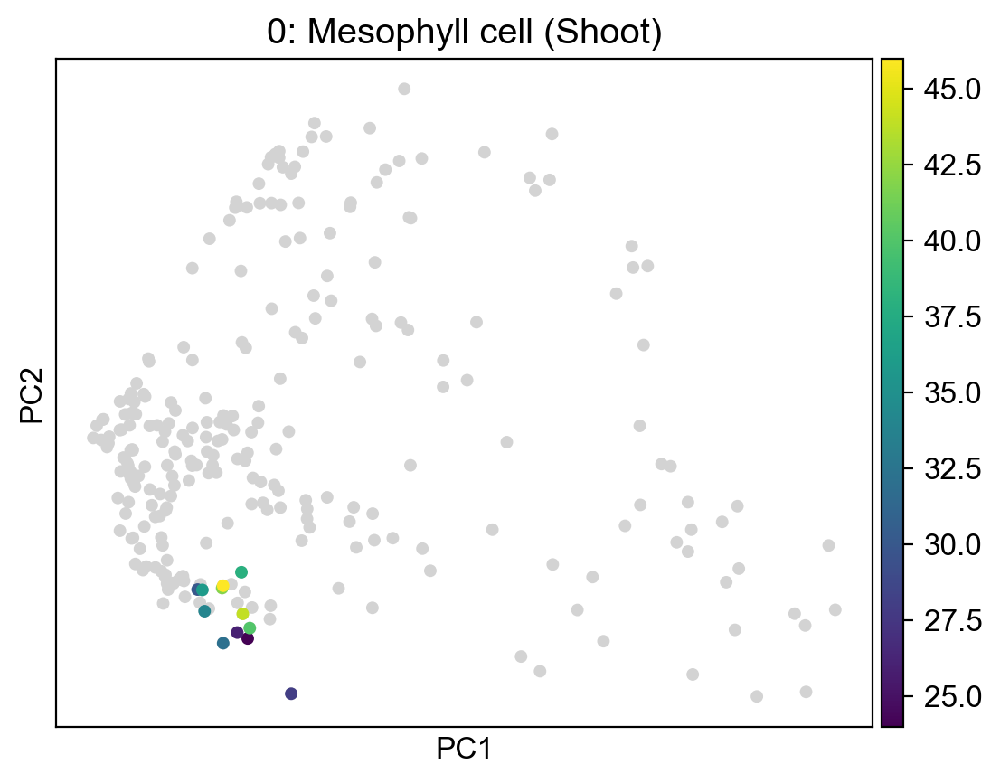

  5%|▍         | 1/22 [00:00<00:07,  2.73it/s]

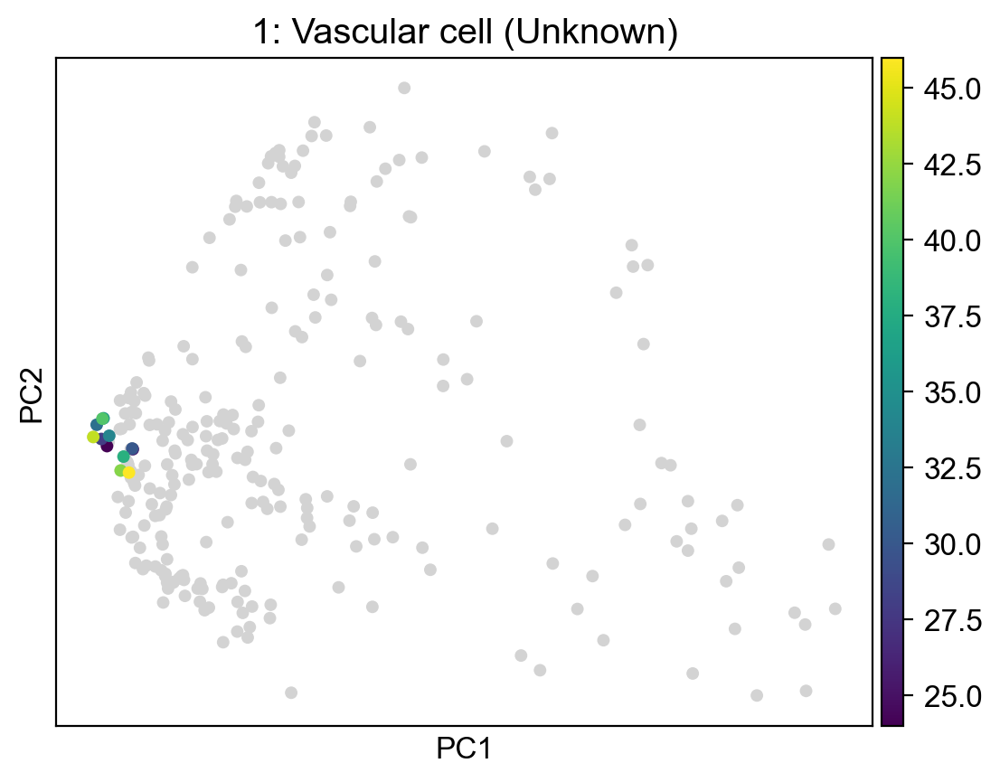

  9%|▉         | 2/22 [00:00<00:07,  2.66it/s]

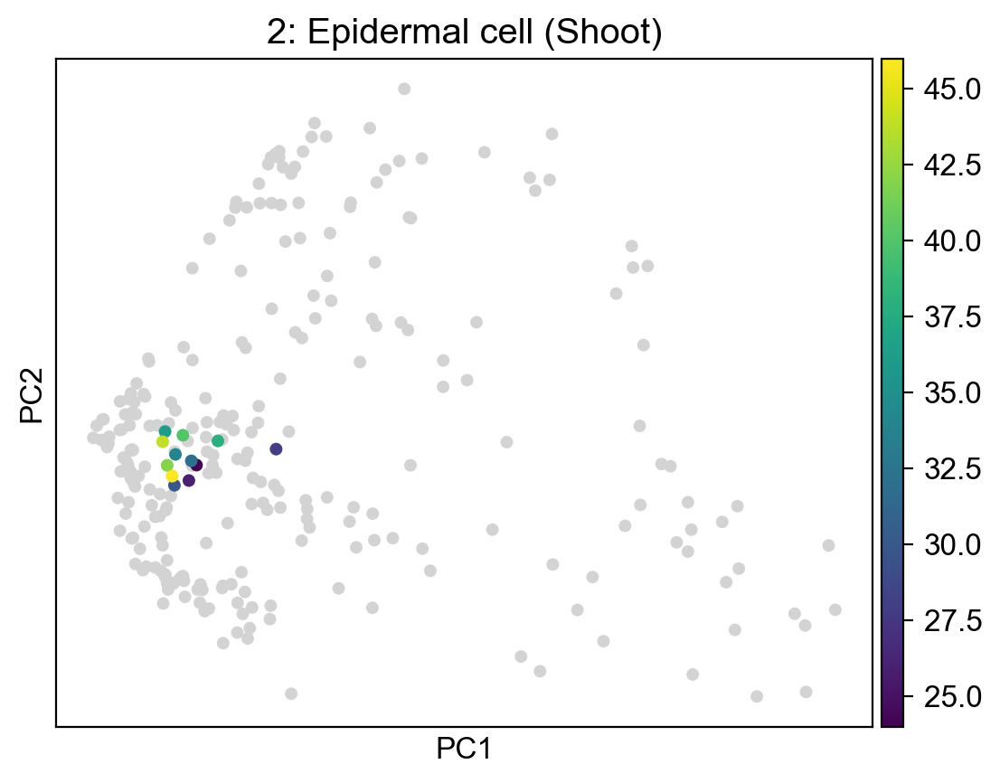

 14%|█▎        | 3/22 [00:01<00:07,  2.62it/s]

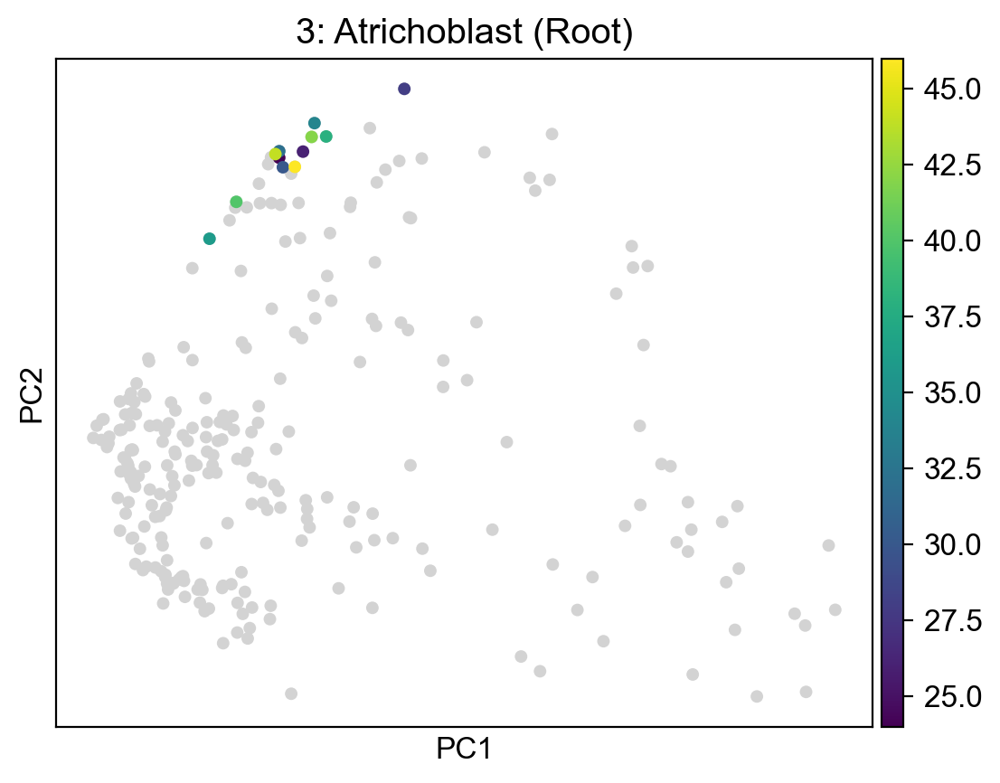

 18%|█▊        | 4/22 [00:01<00:06,  2.76it/s]

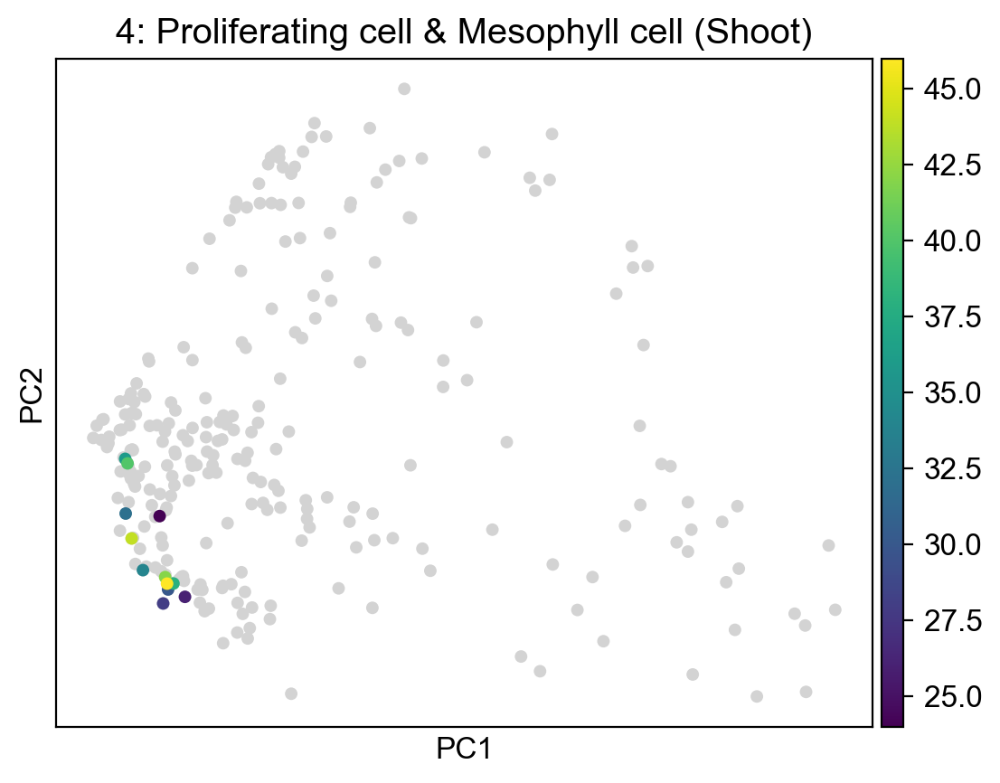

 23%|██▎       | 5/22 [00:01<00:06,  2.80it/s]

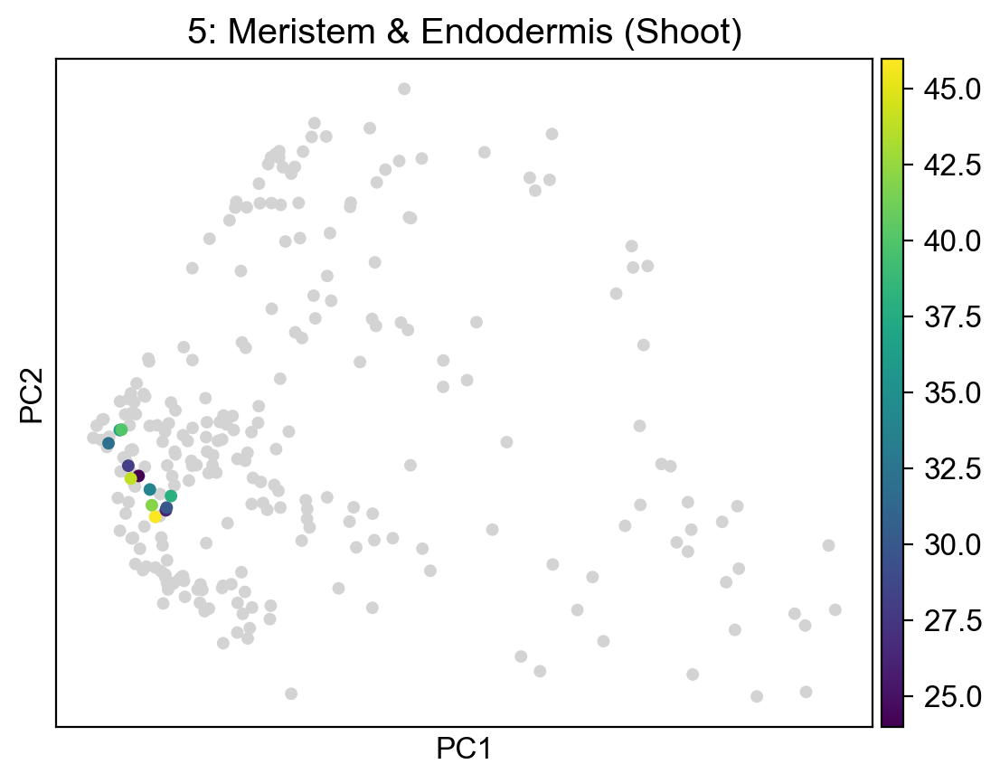

 27%|██▋       | 6/22 [00:02<00:05,  2.74it/s]

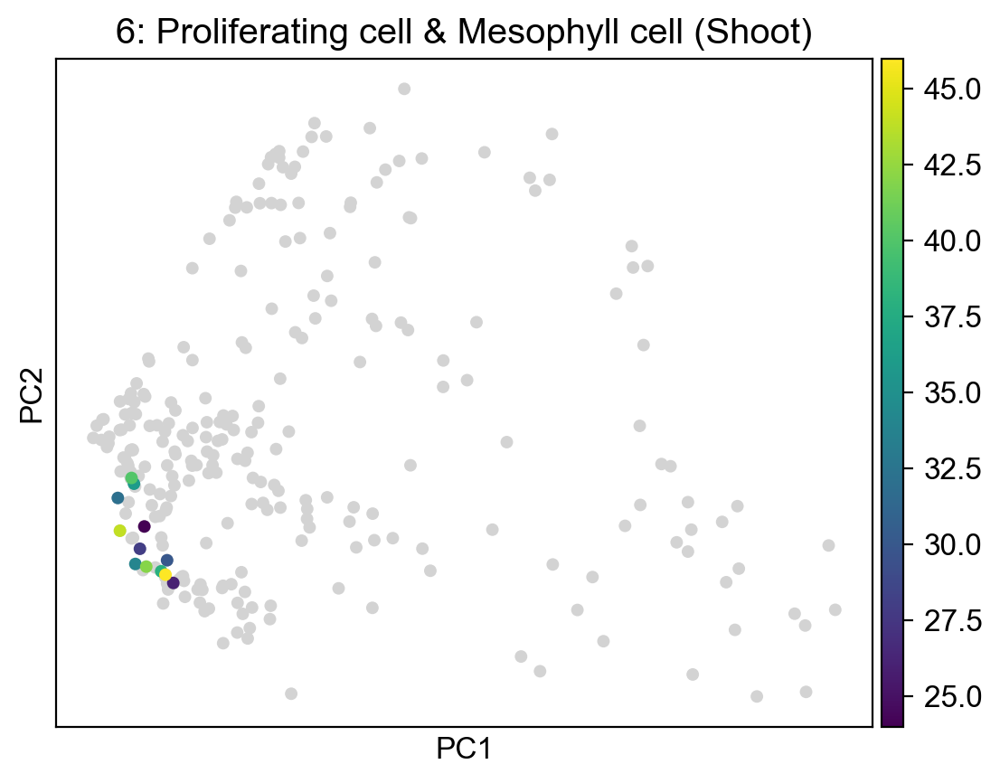

 32%|███▏      | 7/22 [00:02<00:05,  2.76it/s]

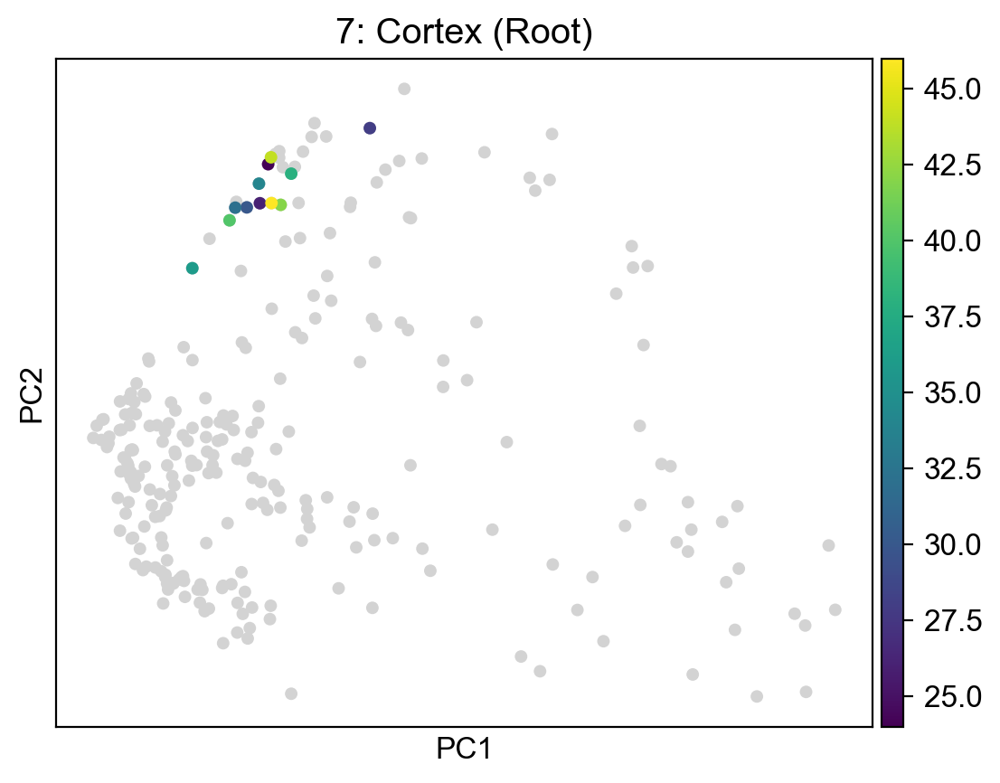

 36%|███▋      | 8/22 [00:02<00:05,  2.65it/s]

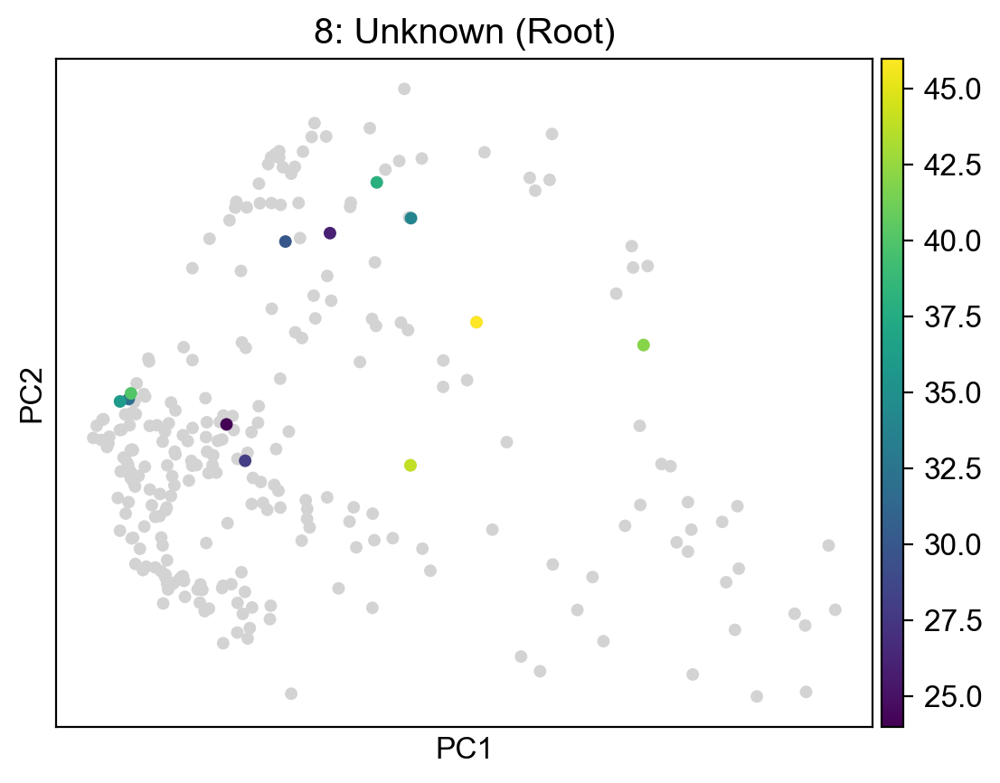

 41%|████      | 9/22 [00:03<00:04,  2.61it/s]

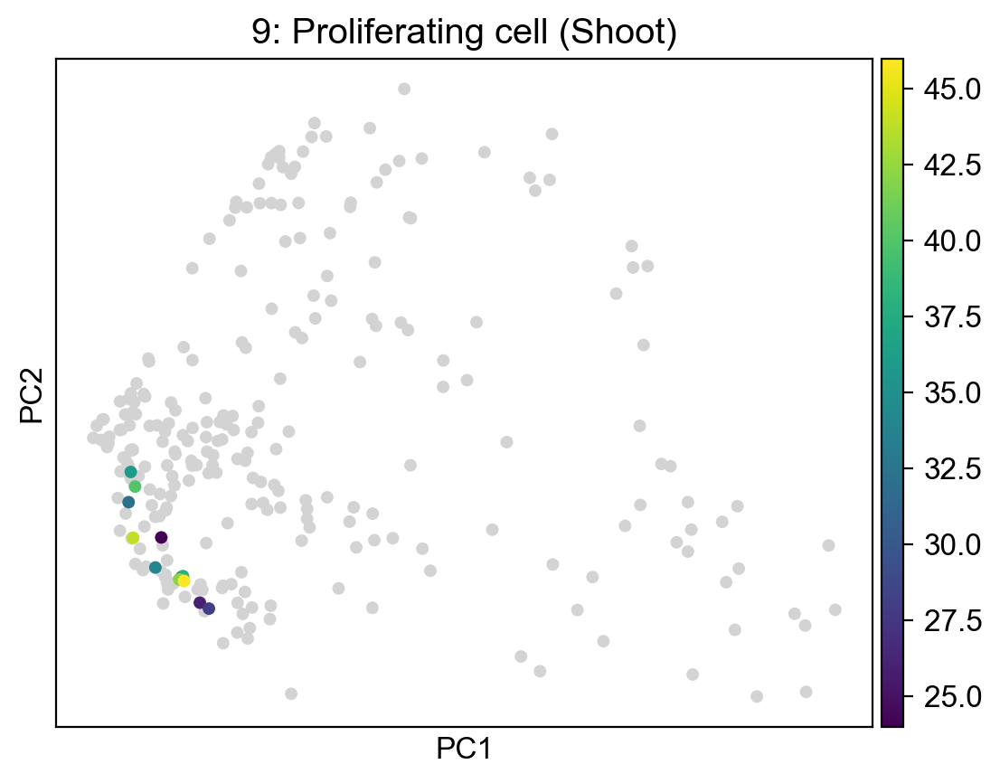

 45%|████▌     | 10/22 [00:03<00:04,  2.69it/s]

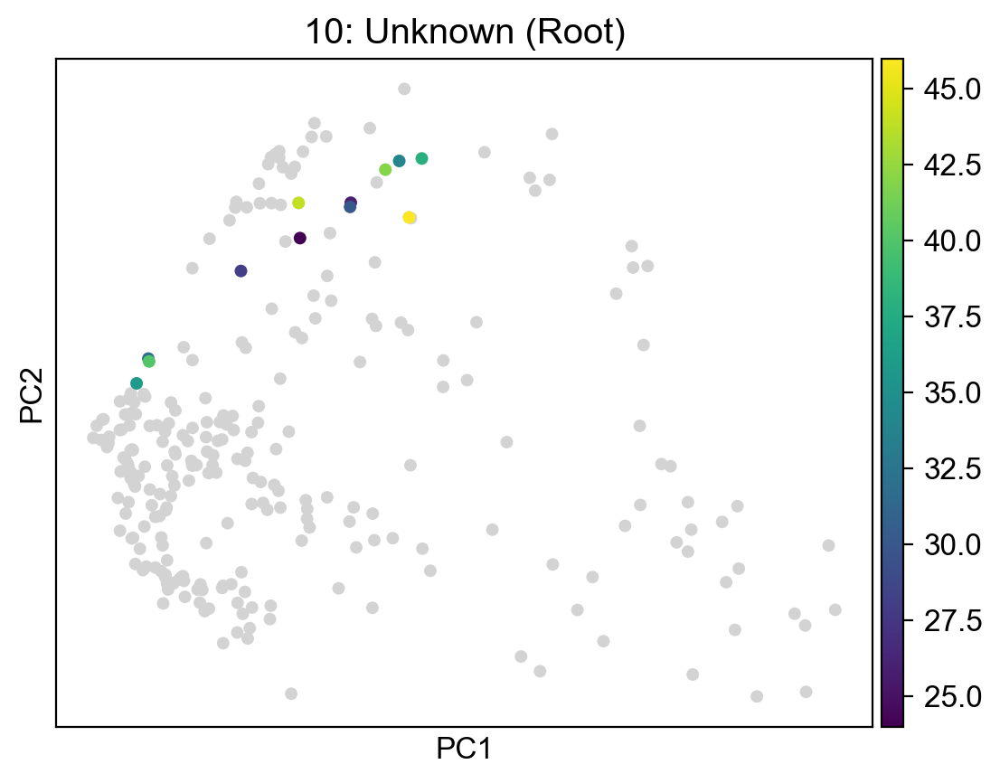

 50%|█████     | 11/22 [00:04<00:04,  2.75it/s]

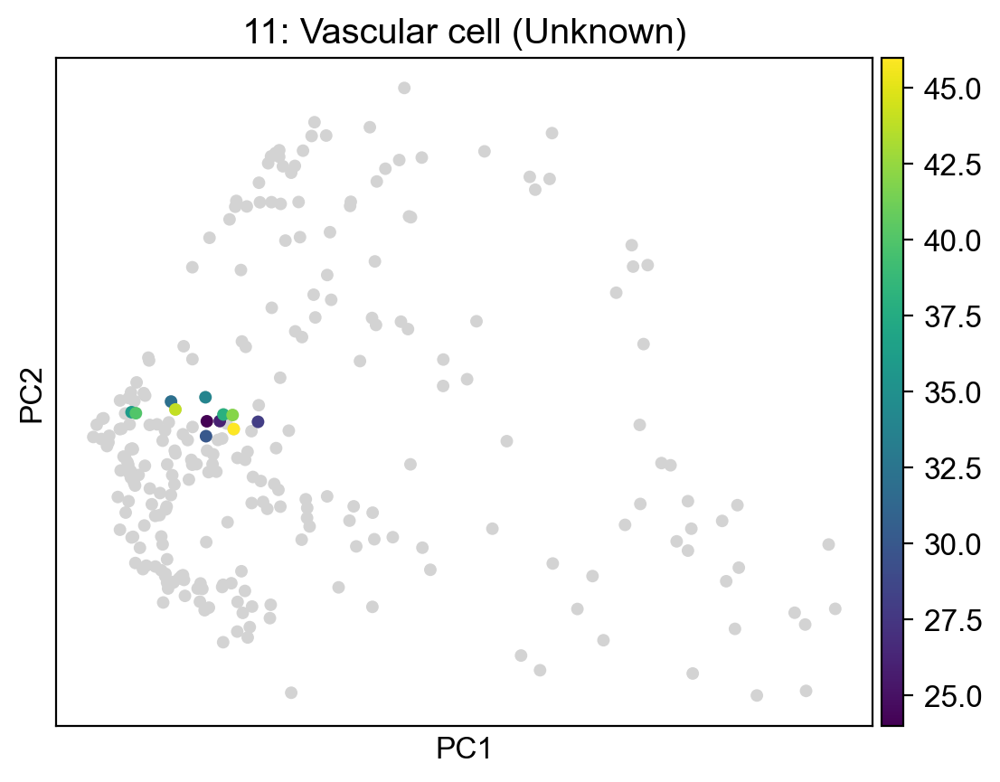

 55%|█████▍    | 12/22 [00:04<00:03,  2.76it/s]

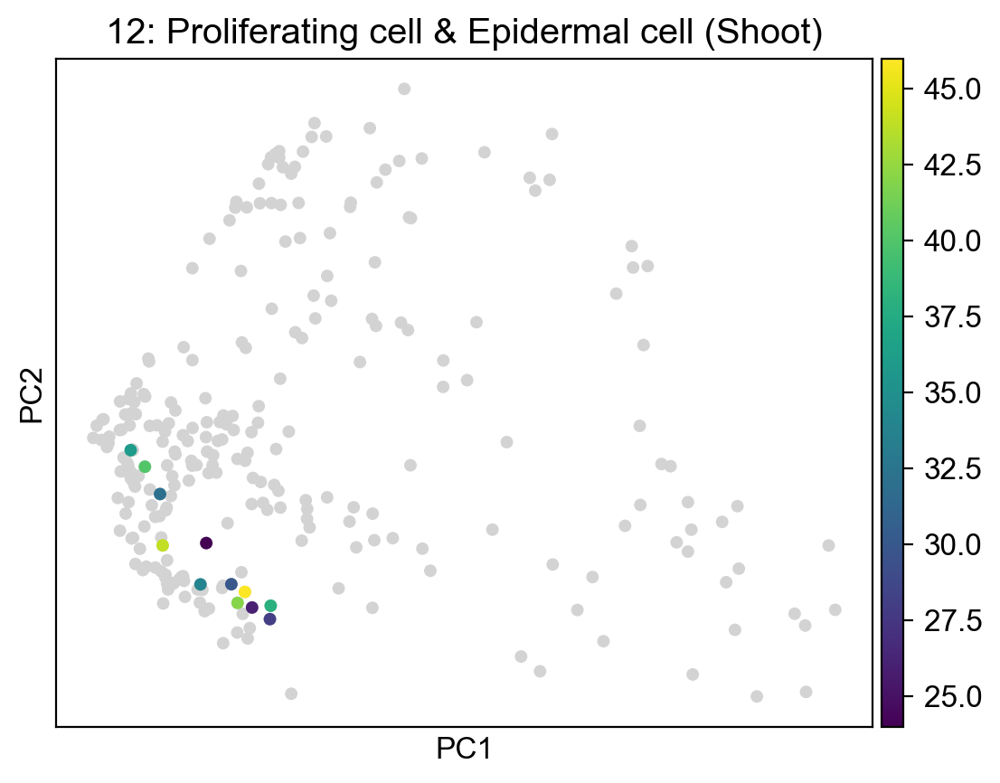

 59%|█████▉    | 13/22 [00:04<00:03,  2.84it/s]

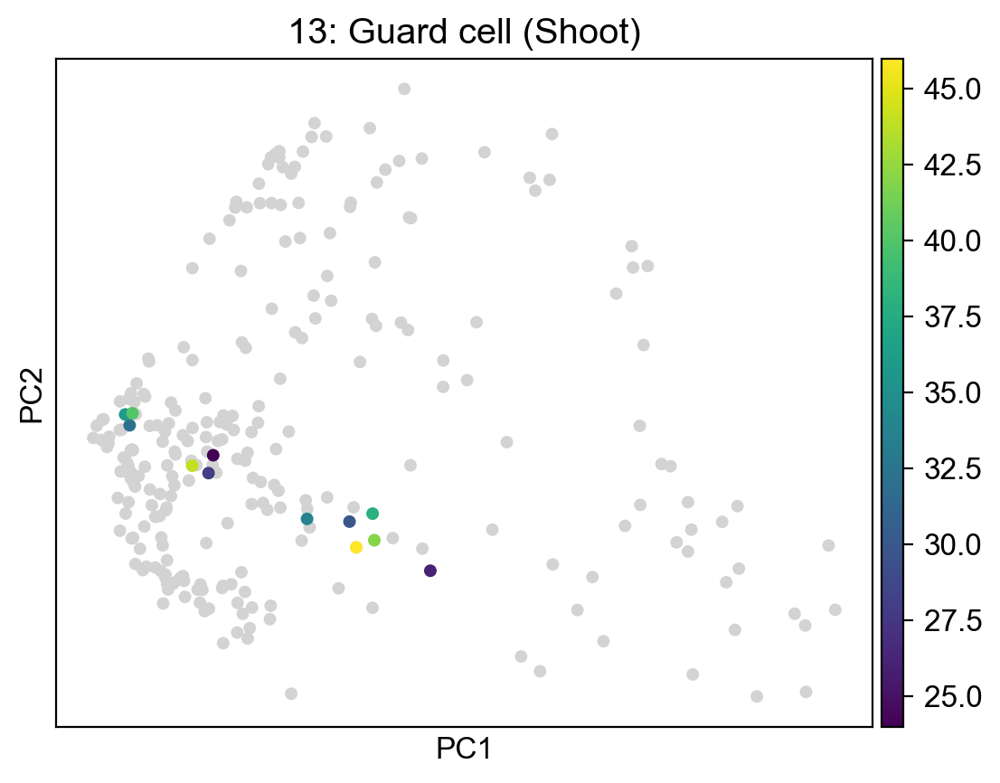

 64%|██████▎   | 14/22 [00:05<00:02,  2.74it/s]

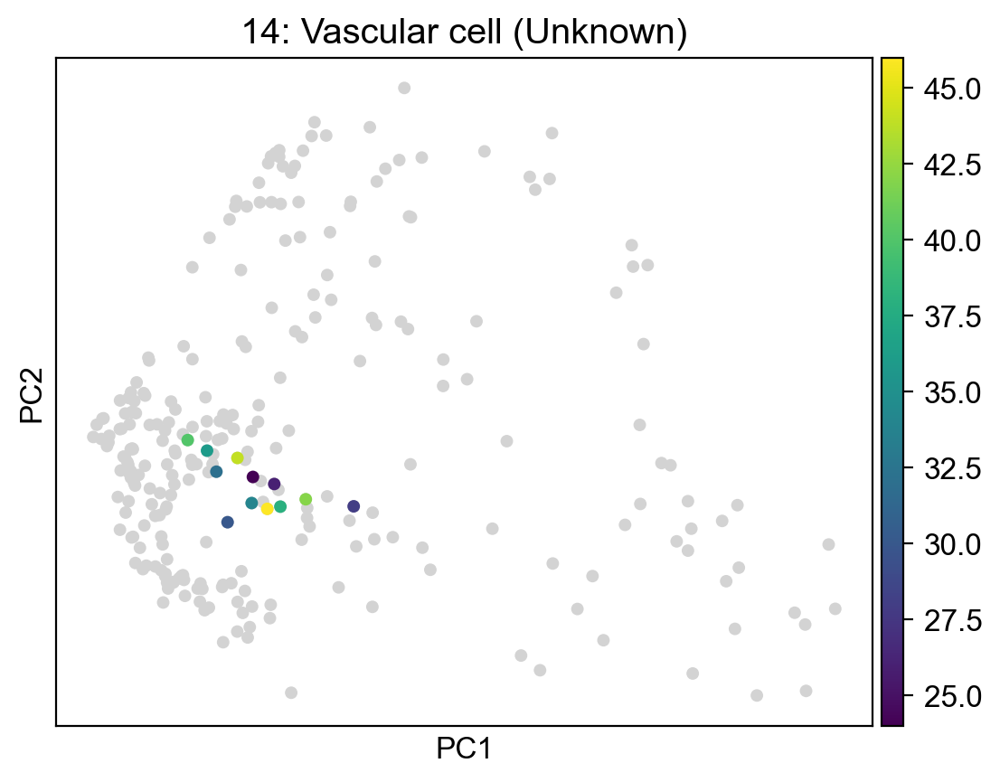

 68%|██████▊   | 15/22 [00:05<00:02,  2.78it/s]

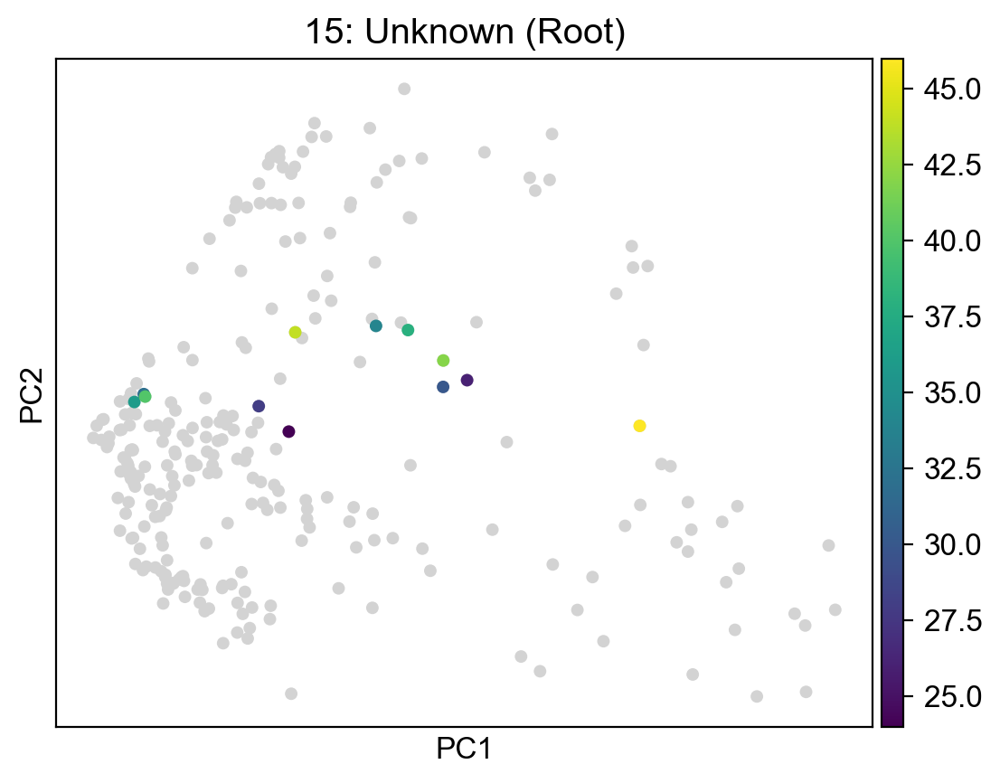

 73%|███████▎  | 16/22 [00:05<00:02,  2.94it/s]

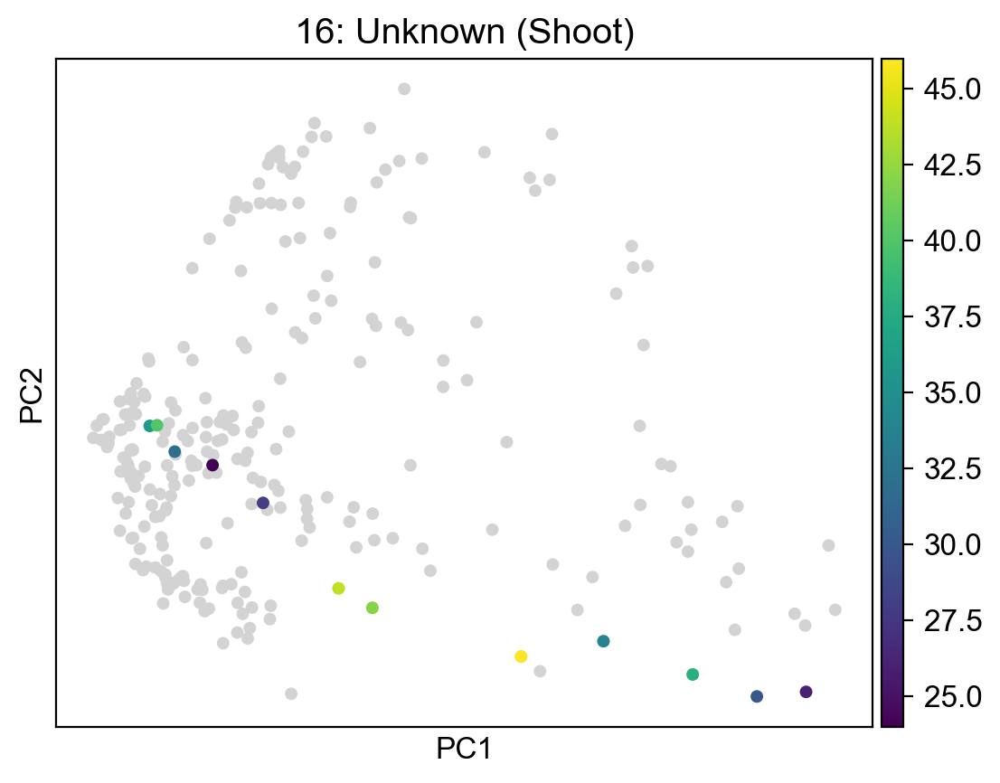

 77%|███████▋  | 17/22 [00:06<00:01,  3.12it/s]

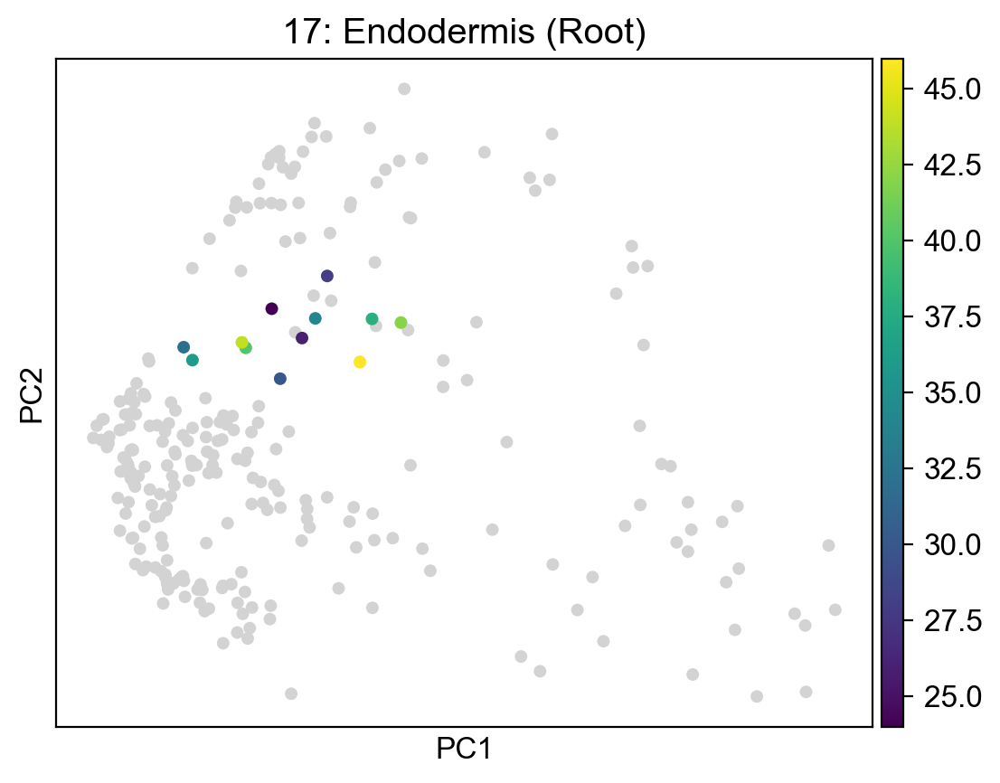

 82%|████████▏ | 18/22 [00:06<00:01,  3.25it/s]

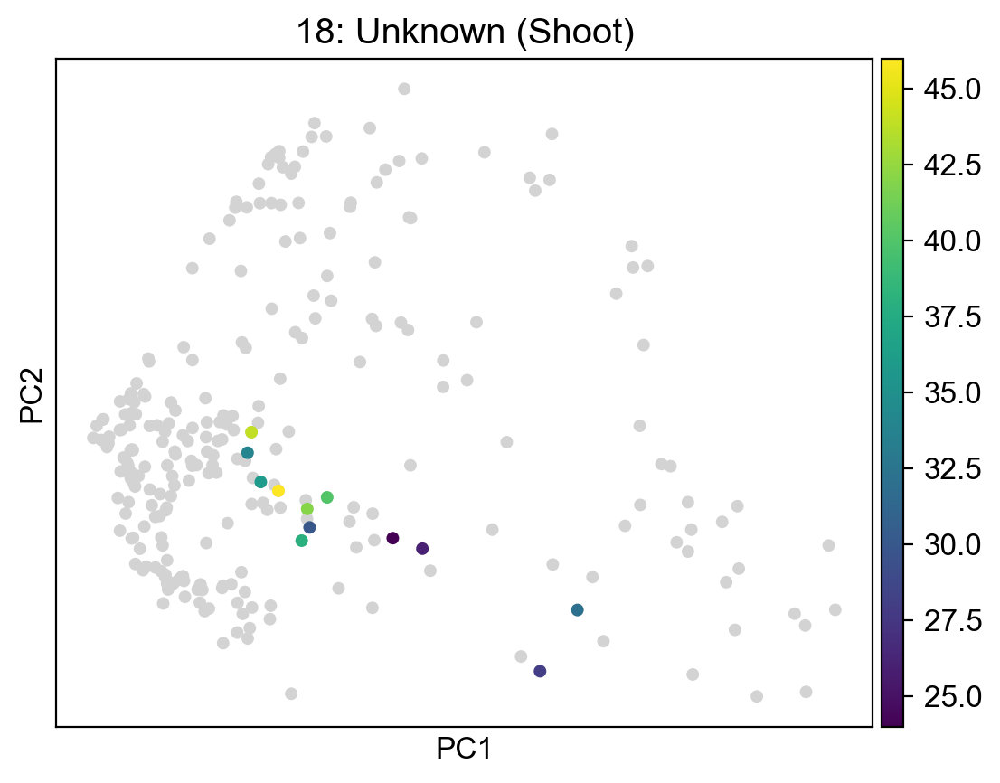

 86%|████████▋ | 19/22 [00:06<00:00,  3.36it/s]

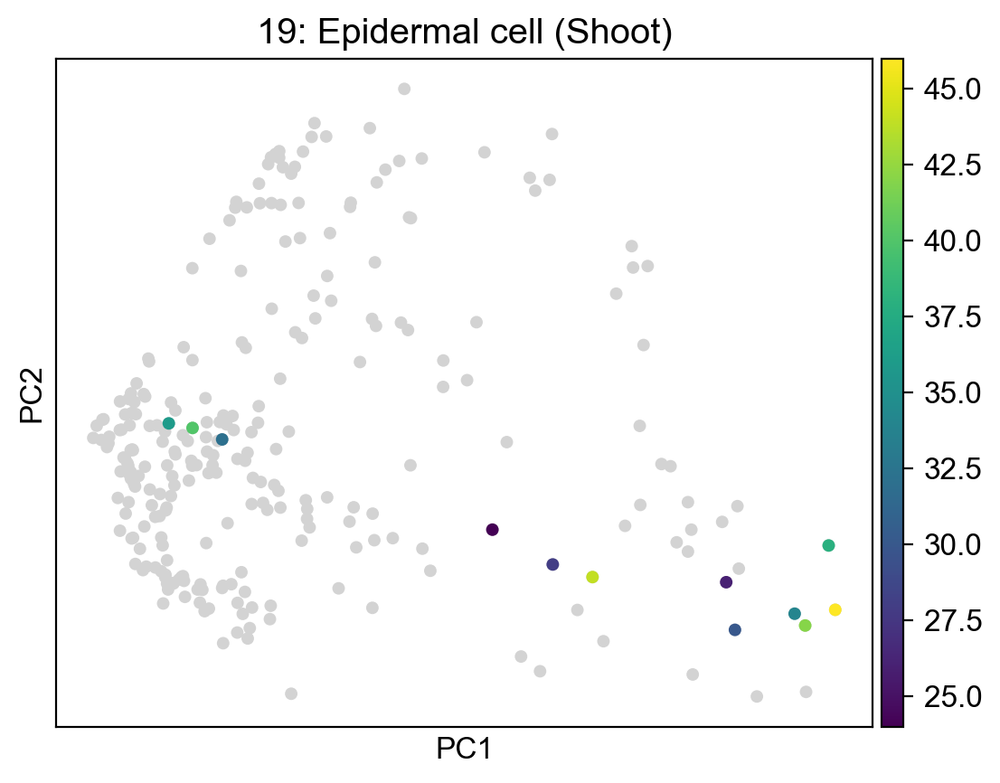

 91%|█████████ | 20/22 [00:06<00:00,  3.37it/s]

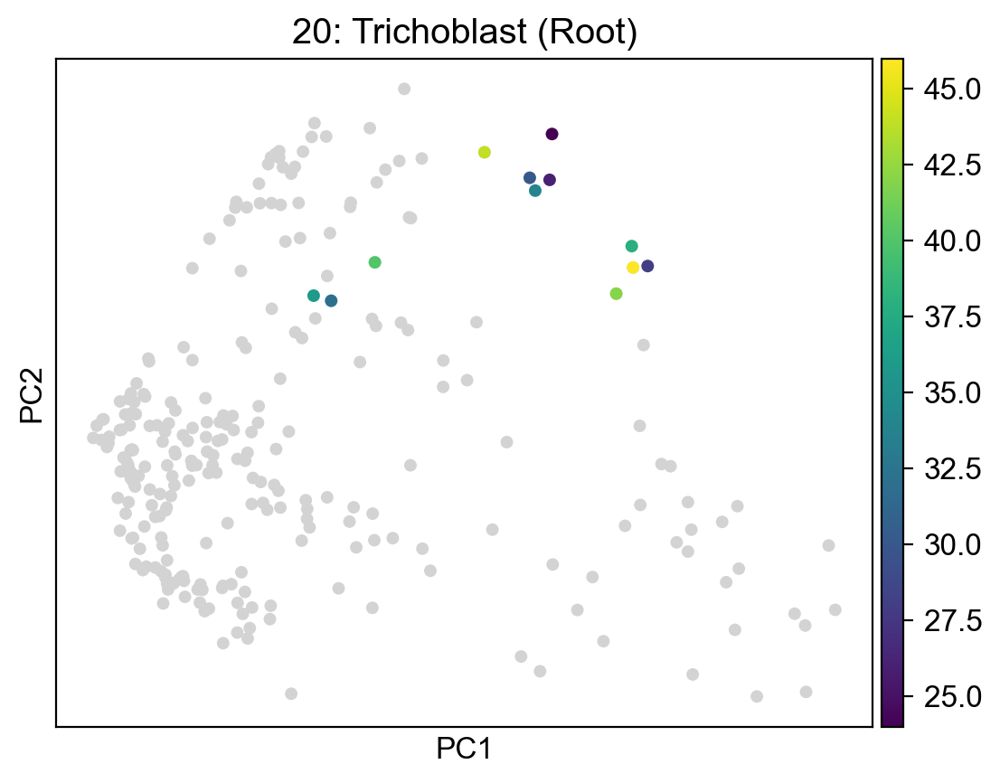

 95%|█████████▌| 21/22 [00:07<00:00,  3.45it/s]

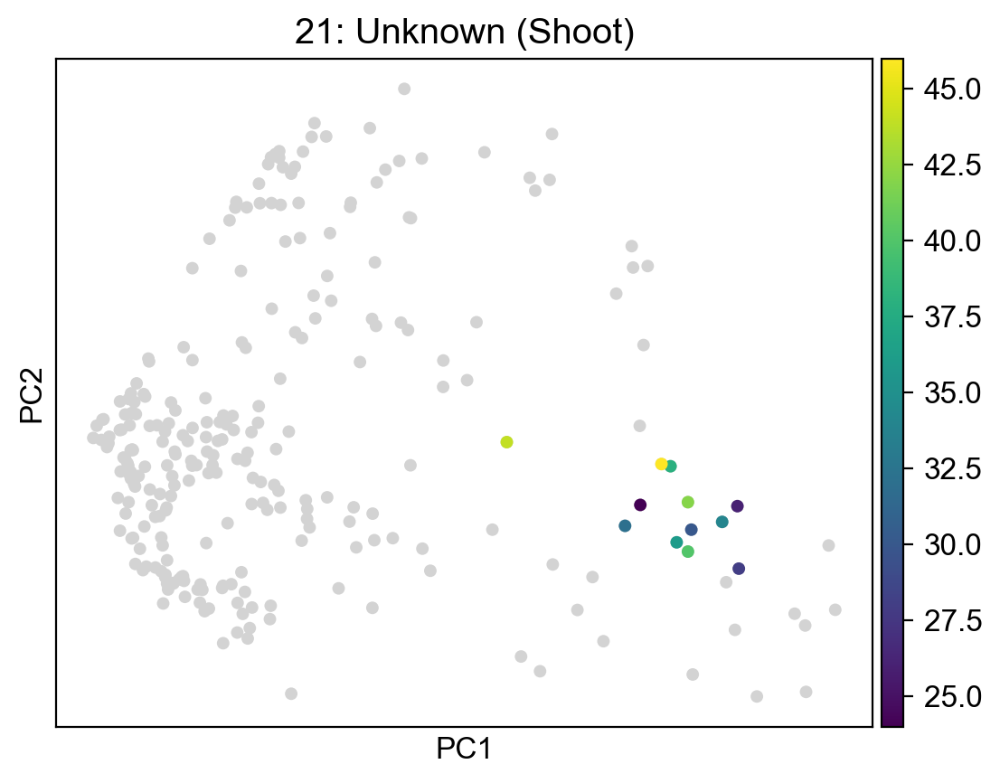

100%|██████████| 22/22 [00:07<00:00,  2.95it/s]


In [390]:
for celltype, _ad in singleCellTools.basic.splitAdata(ad_merge, 'celltype', needName=True, copy=False):
    ax = sc.pl.pca(ad_merge, show=False, size=100)
    sc.pl.pca(_ad, size=100, color='CT', ax=ax, title=celltype)


In [276]:
ad_merge.obs

,CT,celltype,Batch,Cluster,__group
24||0: Mesophyll cell (Shoot),24,0: Mesophyll cell (Shoot),1,0,0: Mesophyll cell (Shoot)
24||1: Vascular cell (Unknown),24,1: Vascular cell (Unknown),1,1,1: Vascular cell (Unknown)
24||2: Epidermal cell (Shoot),24,2: Epidermal cell (Shoot),1,2,2: Epidermal cell (Shoot)
24||3: Atrichoblast (Root),24,3: Atrichoblast (Root),1,3,3: Atrichoblast (Root)
24||4: Proliferating cell & Mesophyll cell (Shoot),24,4: Proliferating cell & Mesophyll cell (Shoot),1,4,4: Proliferating cell & Mesophyll cell (Shoot)
...,...,...,...,...,...
46||17: Endodermis (Root),46,17: Endodermis (Root),2,17,17: Endodermis (Root)
46||18: Unknown (Shoot),46,18: Unknown (Shoot),2,18,18: Unknown (Shoot)
46||19: Epidermal cell (Shoot),46,19: Epidermal cell (Shoot),2,19,19: Epidermal cell (Shoot)
46||20: Trichoblast (Root),46,20: Trichoblast (Root),2,20,20: Trichoblast (Root)


# For Web

In [22]:
ad_forWeb = ad.copy()

In [23]:
ad_forWeb.obs['CT'].cat.categories

Index(['24', '26', '28', '30', '32', '34', '36', '38', '40', '42', '44', '46'], dtype='object')

In [24]:
ad_forWeb

AnnData object with n_obs × n_vars = 131152 × 24503
    obs: 'ambientRnaFractionEstimatedBySoupx', 'Sample', 'CT', 'n_genes', 'n_counts', 'percent_ct', 'outlier', '__group', 'Batch', 'leiden', 'prev_celltype', 'Cluster', 'celltype', 'leiden_0.05', 'leiden_0.1', 'leiden_0.15', 'leiden_0.2', 'leiden_0.25', 'leiden_0.3', 'leiden_0.35', 'leiden_0.4', 'leiden_0.45', 'leiden_0.5', 'leiden_0.55', 'leiden_0.6', 'leiden_0.65', 'leiden_0.7', 'leiden_0.75', 'leiden_0.8', 'leiden_0.85', 'leiden_0.9', 'leiden_0.95', 'leiden_1.0', 'leiden_1.05', 'leiden_1.1', 'leiden_1.15', 'leiden_1.2', 'leiden_1.25', 'leiden_1.3', 'leiden_1.35', 'leiden_1.4', 'leiden_1.45', 'leiden_1.5', 'leiden_subcluster', 'recluster_ct', 'temp_batch', 'temp_split'
    var: 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'Batch_colors', 'CT_colors', 'Cluster_cellexES', 'Cluster_colors', 'Sample_colors', 'celltype_colors', 'hvg', 'leiden', 'leiden_0

In [25]:
ad_forWeb.obs['n_counts'] = ad_forWeb.layers['sx'].sum(1)

In [340]:
ad_forWeb.X = ad_forWeb.layers['sx_log'].copy()
del(ad_forWeb.layers)
del(ad_forWeb.varm)
_ls = list(ad_forWeb.obsm.keys())
for x in _ls:
    if x != 'X_umap':
        del(ad_forWeb.obsm[x])
del(ad_forWeb.uns)
del(ad_forWeb.var)
ad_forWeb.obs = ad_forWeb.obs[['Batch', 'Cluster', 'CT', 'celltype', 'n_counts']]
del(ad_forWeb.obsp)

In [341]:
ad_forWeb.write_h5ad("/data/Zhaijx/liuzj/projects/singleCell/clock/02_web/20230706/logCPM.h5ad")

In [342]:
ad_forWeb = ad.copy()

In [343]:
ad_forWeb.obs['CT'].cat.categories

Index(['24', '26', '28', '30', '32', '34', '36', '38', '40', '42', '44', '46'], dtype='object')

In [344]:
ad_forWeb.obs['n_counts'] = ad_forWeb.layers['sx'].sum(1)

In [345]:
ad_forWeb.X = ad_forWeb.layers['sx'].copy()
del(ad_forWeb.layers)
del(ad_forWeb.varm)
_ls = list(ad_forWeb.obsm.keys())
for x in _ls:
    if x != 'X_umap':
        del(ad_forWeb.obsm[x])
del(ad_forWeb.uns)
del(ad_forWeb.var)
ad_forWeb.obs = ad_forWeb.obs[['Batch', 'Cluster', 'CT', 'celltype', 'n_counts']]
del(ad_forWeb.obsp)

In [346]:
ad_forWeb.write_h5ad("/data/Zhaijx/liuzj/projects/singleCell/clock/02_web/20230706/count.h5ad")

In [26]:
ad_forWeb.obs['n_counts'] = ad_forWeb.layers['raw'].sum(1)

In [27]:
ad_forWeb.X = ad_forWeb.layers['raw'].copy()
del(ad_forWeb.layers)
del(ad_forWeb.varm)
_ls = list(ad_forWeb.obsm.keys())
for x in _ls:
    if x != 'X_umap':
        del(ad_forWeb.obsm[x])
del(ad_forWeb.uns)
del(ad_forWeb.var)
ad_forWeb.obs = ad_forWeb.obs[['Batch', 'Cluster', 'CT', 'celltype', 'n_counts']]
del(ad_forWeb.obsp)

In [28]:
ad_forWeb.write_h5ad("/data/Zhaijx/liuzj/projects/singleCell/clock/02_web/20230706/count_not_spx.h5ad")